# Load Packages and Set Global Variables

All variable definitions necessary to customize notebook execution are included in this section.

<a id="imports"></a>

## Imports and Settings

In [1]:
import anndata
import cellrank as cr
import numpy as np
import scanpy as sc
import scvelo as scv
import sys
import pandas as pd
import pickle
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

print(sc.__version__)
print(anndata.__version__)

np.random.seed(seed=1)

1.8.1
0.7.6


Set up paths to all data resources used throughout notebook here:

In [2]:
sc.settings.verbosity = 3 # amount of output

root_dir = '.'

dir_in = root_dir + 'data/'
base_dir = root_dir + 'results/'
dir_gene_sets = root_dir + 'data/gene_sets/MSigDBlists/'
dir_cc_gene_set = root_dir + 'data/gene_sets/regev_lab_cell_cycle_genes_10X.txt'

# Make sure that these folders exist:
dir_out = base_dir + 'figures/afmos/'
dir_tables = base_dir + 'tables/afmos/'
dir_anndata = base_dir + 'anndata/afmos/'
dir_de = base_dir + 'de/afmos/'

# Set paths in which data lies:
fns_h5ad_basic = [
    dir_in+x for x in 
    [
        'geo/ascl1_foxa2_myod1_oct4_sox2_MUC29498_filtered_feature_bc_matrix.h5',
        'geo/ascl1_foxa2_myod1_oct4_sox2_MUC29499_filtered_feature_bc_matrix.h5',
    ]
]
fns_loom = [
    dir_in+x for x in 
    [
        'geo/ascl1_foxa2_myod1_oct4_sox2_MUC29498_possorted_genome_bam_HL4ZS.loom',
        'geo/ascl1_foxa2_myod1_oct4_sox2_MUC29499_possorted_genome_bam_4RZIU.loom',
    ]
]
fns_mtx_soupx = [
    base_dir+x for x in 
    [
        'soupx/MUC29498',
        'soupx/MUC29499',
    ]
]

sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 80, dpi_save = 600, scanpy=True)
sc.settings.figdir = dir_out
scv.settings.figdir = dir_out
print(sys.version)

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                         8.3.2
anyio                       NA
appnope                     0.1.2
attr                        21.2.0
babel                       2.9.1
backcall                    0.2.0
beta_ufunc                  NA
binom_ufunc                 NA
cellrank                    1.4.0
certifi                     2021.05.30
cffi                        1.14.6
chardet                     4.0.0
charset_normalizer          2.0.4
cloudpick

In [3]:
constructs_dict = {
    "Ascl1": ["synAscl1_dsred-minus-gn", "synAscl1_dsred-plus-gn"],
    "Foxa2": ["synFoxA2_dsred-minus-gn", "synFoxA2_dsred-plus-gn"],
    "Myod1": ["synMyoD1_dsred-minus-gn", "synMyoD1_dsred-plus-gn"],
    "Oct4": ["synOct4-minus-gn", "synOct4-plus-gn"],
    "Sox2": ["synSox2-minus-gn", "synSox2-plus-gn"],
}
constructs = list(constructs_dict.keys())
constructs_color_dict = {
    "DsRed": ["DsRed-minus-gn", "DsRed-plus-gn"],
    "AcGFP1": ["AcGFP1-minus-gn", "AcGFP1-plus-gn"],
    "EBFP2": ["EBFP2-minus-gn", "EBFP2-plus-gn"],
}
constructs_color = list(constructs_color_dict.keys())
endogenous_genes = [
    "Ascl1",
    "Foxa2",
    "Myod1",
    "Pou5f1",
    "Sox2",
]

<a id="Global"></a>

In [4]:
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

## Global Variables

**Interactive panels:** Define what is recomputed here, leave as is if you want to rely entirely on precomputed objects.


All embeddings and clusterings can be saved and loaded into this script. Be carful with overwriting cluster caches as soon as cell type annotation has started as cluster labels may be shuffled.

Set whether anndata objects are recomputed or loaded from cache.

In [5]:
bool_recomp = False

Set whether clustering is recomputed or loaded from saved .obs file. Loading makes sense if the clustering changes due to a change in scanpy or one of its dependencies and the number of clusters or the cluster labels change accordingly.

In [6]:
bool_recluster = False

Set whether cluster cache is overwritten. Note that the cache exists for reproducibility of clustering, see above.

In [7]:
bool_write_cluster_cache = False

Set whether to produce plots, set to False for test runs.

In [8]:
bool_plot = True

Set colors for UMAP:

In [9]:
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

# Utils

Define util functions used throughout notebook:

In [10]:
def boxplot_hue(
    adata,
    x, 
    clustercol: str = "louvain_named",
    hue: str = "time",
    clusters=None,
    ncols=3, row_height=6, column_width=6
):
    if not (isinstance(x, list) or isinstance(x, np.ndarray)):
        x = [x]
    print("did not find: %s" % str([xx for xx in x if xx not in adata.var_names]))
    x = [xx for xx in x if xx in adata.var_names]
    ncols = np.min([ncols, len(x)])
    nrows = len(x) // ncols + int(len(x) % ncols > 0)
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(column_width*ncols,row_height*nrows))
    if len(x) > 1:
        axs = axs.ravel()
    else:
        axs = [axs]
    if clusters is None:
        clusters = np.sort(np.unique(adata.obs[clustercol].values))
    for i, xx in enumerate(x):
        sb.boxplot(
            data=pd.DataFrame({
                xx: np.asarray(adata[:, xx].X.todense()).flatten(), 
                clustercol: pd.Categorical(adata.obs[clustercol].values, categories=clusters),
                hue: adata.obs[hue].values
            }),
            x=clustercol, y=xx, hue=hue, ax=axs[i]
        )
        axs[i].xaxis.set_tick_params(rotation=90)
        box = axs[i].get_position()
        axs[i].set_position([box.x0, box.y0, box.width * 0.95, box.height])
        axs[i].legend(loc='center left', bbox_to_anchor=(1, 0.5))
        axs[i].xaxis.set_tick_params(rotation=90)
    plt.tight_layout()
    plt.show()

# Loading Data, Quality Control and Preprocessing

## Loading

Cellranger aligned mRNA counts:

In [11]:
adata_raw = [sc.read_10x_h5(x) for x in fns_h5ad_basic]
for x in adata_raw:
    x.var_names_make_unique()
adata_raw = adata_raw[0].concatenate(
    adata_raw[1:], join="outer", 
    batch_key="batch", batch_categories=[x.split("/")[-2] for x in fns_h5ad_basic]
)
adata_raw.obs["time"] = [{
    "MUC29498": "72h",
    "MUC29499": "72h"
}[x] for x in adata_raw.obs["batch"].values]

reading /Users/davfischer/Documents/science/collideseq/data/P21037/cellranger/MUC29498/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:01)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


reading /Users/davfischer/Documents/science/collideseq/data/P21037/cellranger/MUC29499/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:01)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Velocyto pipeline aligned spliced/unspliced RNA counts:

In [12]:
adata_raw_velo = [scv.read_loom(x) for x in fns_loom]
for i in range(len(adata_raw_velo)):
    adata_raw_velo[i].var_names_make_unique()
adata_raw_velo = adata_raw_velo[0].concatenate(  # layer concatenation not available for join=="outer"
    adata_raw_velo[1:], join="inner", 
    batch_key="batch", batch_categories=[x.split("/")[-2] for x in fns_loom]
)
adata_raw_velo.obs["time"] = [{
    "MUC29498": "72h",
    "MUC29499": "72h"
}[x] for x in adata_raw_velo.obs["batch"].values]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Add construct counts into .obs:

In [13]:
[x for x in adata_raw.var_names if "syn" in x]

['Insyn2a',
 'Nadsyn1',
 'Isyna1',
 'Insyn1',
 'synAscl1_dsred-plus-gn',
 'synAscl1_dsred-minus-gn',
 'synFoxA2_dsred-plus-gn',
 'synFoxA2_dsred-minus-gn',
 'synMyoD1_dsred-plus-gn',
 'synMyoD1_dsred-minus-gn',
 'synOct4-plus-gn',
 'synOct4-minus-gn',
 'synSox2-plus-gn',
 'synSox2-minus-gn']

In [14]:
constructs_counts = {}
for k, v in constructs_dict.items():
    adata_raw.obs[k] = np.asarray(adata_raw[:,v[0]].X.todense()).flatten() +np.asarray(adata_raw[:, v[1]].X.todense()).flatten()
    adata_raw.obs[k+"_log"] = np.log(adata_raw.obs[k].values + 1.)
for k, v in constructs_color_dict.items():
    adata_raw.obs[k] = np.asarray(adata_raw[:,v[0]].X.todense()).flatten() +np.asarray(adata_raw[:, v[1]].X.todense()).flatten()
    adata_raw.obs[k+"_log"] = np.log(adata_raw.obs[k].values + 1.)
for x in endogenous_genes:
    adata_raw.obs[x] = np.asarray(adata_raw[:, x].X.todense()).flatten()
    adata_raw.obs[x+"_endogenous_log"] = np.log(np.asarray(adata_raw[:, x].X.todense()).flatten() + 1.)

We remove our four transgenes from the count matrix because in our analysis we just want to consider them as independent input variables and not depenendent output variables.

In [15]:
adata_raw.obs["total_count_with_transgenes"] = np.asarray(np.sum(adata_raw.X, axis=1)).flatten()

In [16]:
print(adata_raw.shape)
genes = list(adata_raw.var_names) 

mask = np.ones(len(genes), dtype=bool)
for gg in constructs_dict.values():
    for g in gg:
        idx = genes.index(g)
        mask[idx] = False
for gg in constructs_color_dict.values():
    for g in gg:
        idx = genes.index(g)
        mask[idx] = False
adata_raw._inplace_subset_var(mask)

print(adata_raw.shape)

(16928, 22613)
(16928, 22597)


In [17]:
adata_raw.obs["total_count_without_transgenes"] = np.asarray(np.sum(adata_raw.X, axis=1)).flatten()

## Quality Control: cells

### Gene numbers and counts with and without mitochondrial RNA

In [18]:
adata_raw.obs['n_genes'] = np.asarray(np.sum(adata_raw.X > 0, axis=1)).flatten()
adata_raw.obs['n_counts'] = np.asarray(np.sum(adata_raw.X, axis=1)).flatten()
adata_raw.obs['log_n_counts'] = np.log(adata_raw.obs['n_counts'].values + 1)
mt_gene_mask = [gene.startswith('mt-') for gene in adata_raw.var_names]
adata_raw.obs['mt_frac'] = np.asarray(adata_raw[:,mt_gene_mask].X.sum(axis=1)).flatten() / adata_raw.obs['n_counts'].values

### Number of Genes versus Number of Counts

... storing 'time' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


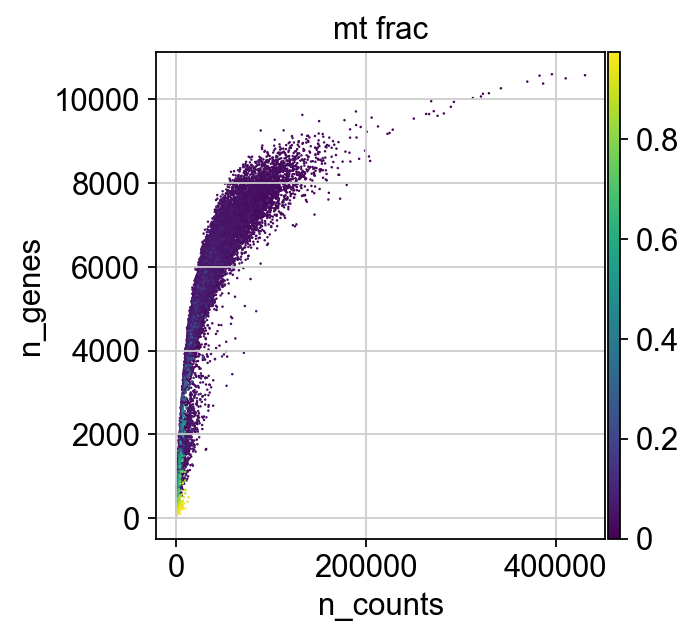

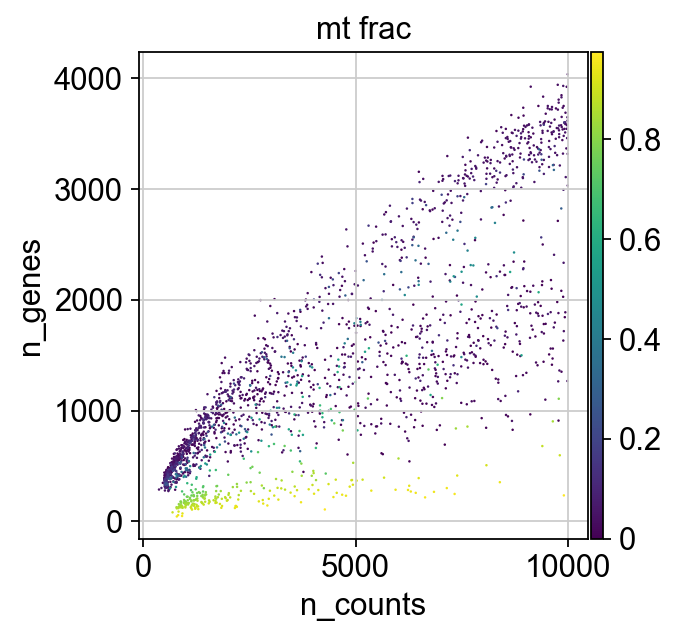

In [19]:
if bool_plot == True:
    p1 = sc.pl.scatter(adata_raw, 'n_counts', 'n_genes', color='mt_frac', size=5)
    p2 = sc.pl.scatter(adata_raw[adata_raw.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac', size=5)

### Cell Filtering

In [20]:
# Filter cells according to identified QC thresholds:
for x in np.unique(adata_raw.obs["batch"].values):
    print(
        'Total number of cells in batch %s: %i' % 
        (x, np.sum(adata_raw[adata_raw.obs["batch"].values == x, :].shape[0]))
    )

if bool_recomp:
    adata_filtered = adata_raw[adata_raw.obs['n_genes'] >= 1000]

    for x in np.unique(adata_filtered.obs["batch"].values):
        print(
            'Number of cells in batch %s after min count and gene count filter: %i' % 
            (x, np.sum(adata_filtered[adata_filtered.obs["batch"].values == x, :].shape[0]))
        )
        
    # Filter against putative doublets.
    adata_filtered = adata_filtered[adata_filtered.obs['n_counts'] <= 200000]

    for x in np.unique(adata_filtered.obs["batch"].values):
        print(
            'Number of cells in batch %s after max count and gene count filter: %i' % 
            (x, np.sum(adata_filtered[adata_filtered.obs["batch"].values == x, :].shape[0]))
        )

    adata_filtered = adata_filtered[adata_filtered.obs['mt_frac'] < 0.2]
    for x in np.unique(adata_filtered.obs["batch"].values):
        print(
            'Number of cells in batch %s after MT filter: %i' % 
            (x, np.sum(adata_filtered[adata_filtered.obs["batch"].values == x, :].shape[0]))
        )
else:
    adata_filtered = sc.read(dir_anndata+'adata_filtered.h5ad') 

Total number of cells in batch MUC29498: 8709
Total number of cells in batch MUC29499: 8219


In [21]:
adata_filtered

AnnData object with n_obs × n_vars = 15768 × 22597
    obs: 'batch', 'time', 'Ascl1', 'Ascl1_log', 'Foxa2', 'Foxa2_log', 'Myod1', 'Myod1_log', 'Oct4', 'Oct4_log', 'Sox2', 'Sox2_log', 'DsRed', 'DsRed_log', 'AcGFP1', 'AcGFP1_log', 'EBFP2', 'EBFP2_log', 'Ascl1_endogenous_log', 'Foxa2_endogenous_log', 'Myod1_endogenous_log', 'Pou5f1', 'Pou5f1_endogenous_log', 'Sox2_endogenous_log', 'total_count_with_transgenes', 'total_count_without_transgenes', 'n_genes', 'n_counts', 'log_n_counts', 'mt_frac', 'sf', 'sf_withtransgene', 'Ascl1_norm_log', 'Foxa2_norm_log', 'Myod1_norm_log', 'Oct4_norm_log', 'Sox2_norm_log', 'DsRed_norm_log', 'AcGFP1_norm_log', 'EBFP2_norm_log', 'sf_withouttransgene', 'Ascl1_norm_log_corrected', 'Ascl1_log_corrected', 'Foxa2_norm_log_corrected', 'Foxa2_log_corrected', 'Myod1_norm_log_corrected', 'Myod1_log_corrected', 'Oct4_norm_log_corrected', 'Oct4_log_corrected', 'Sox2_norm_log_corrected', 'Sox2_log_corrected', 'Ascl1_positive_gmm', 'Foxa2_positive_gmm', 'Myod1_positive_g

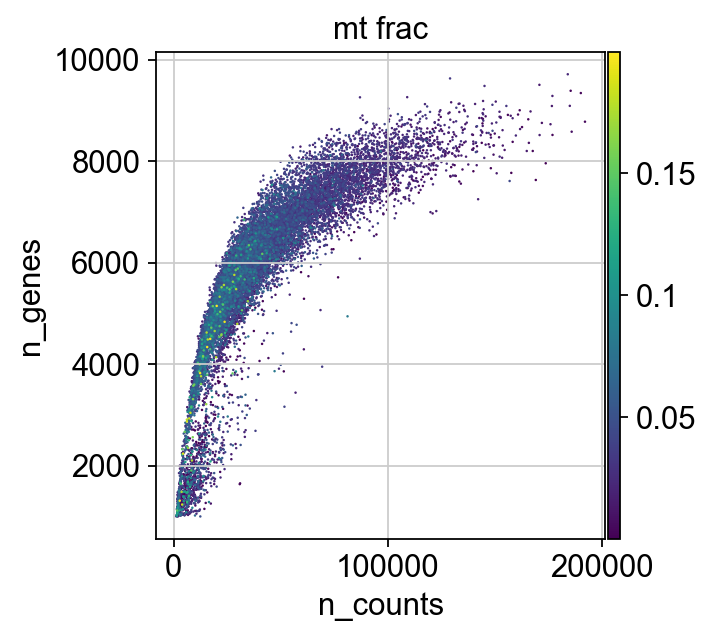

In [22]:
if bool_plot == True:
    sc.pl.scatter(adata_filtered, 'n_counts','n_genes', color='mt_frac', size=5)

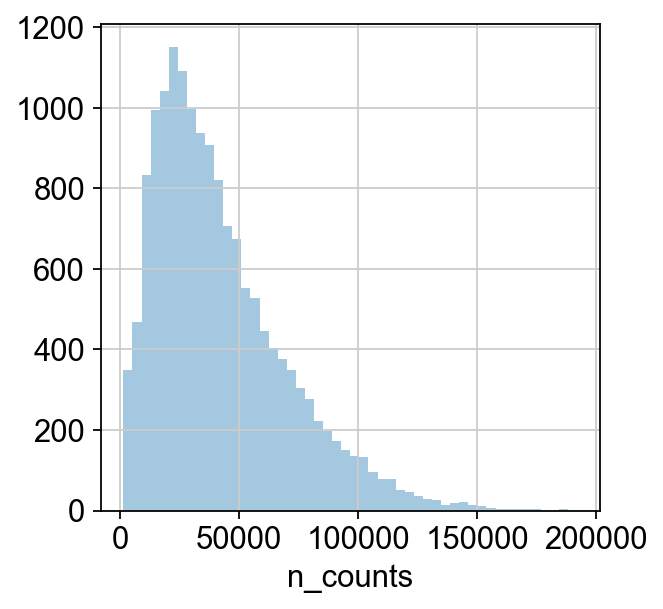

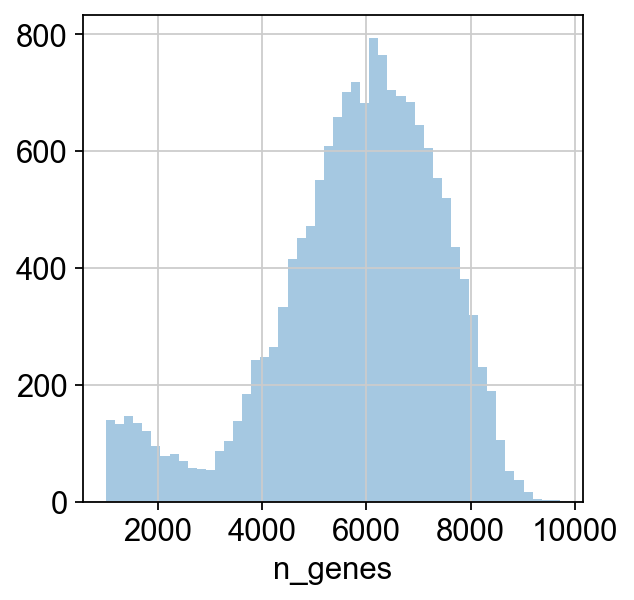

In [23]:
if bool_plot == True:
    ax = sb.distplot(adata_filtered.obs['n_counts'], kde = False)
    plt.show()
    ax = sb.distplot(adata_filtered.obs['n_genes'], kde = False)
    plt.show()

## Quality control: genes

### Gene filtering

In [24]:
adata_filtered.var["n_counts"] = np.asarray(np.sum(adata_filtered.X, axis=0)).flatten()
adata_filtered.var["n_cells"] = np.asarray(np.sum(adata_filtered.X > 0, axis=0)).flatten()

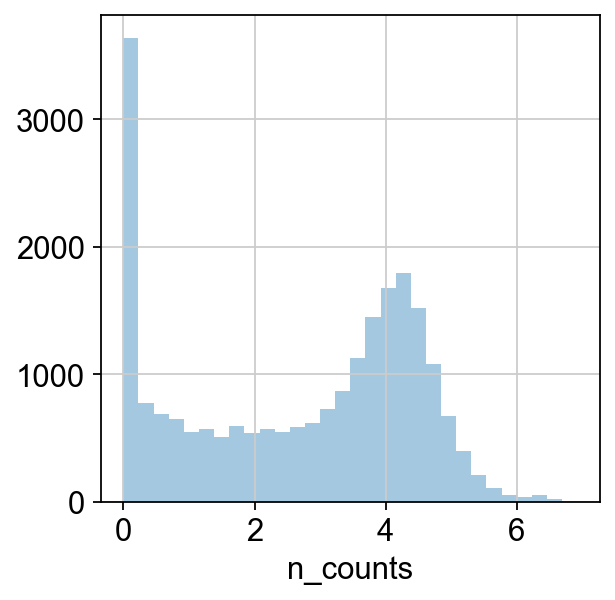

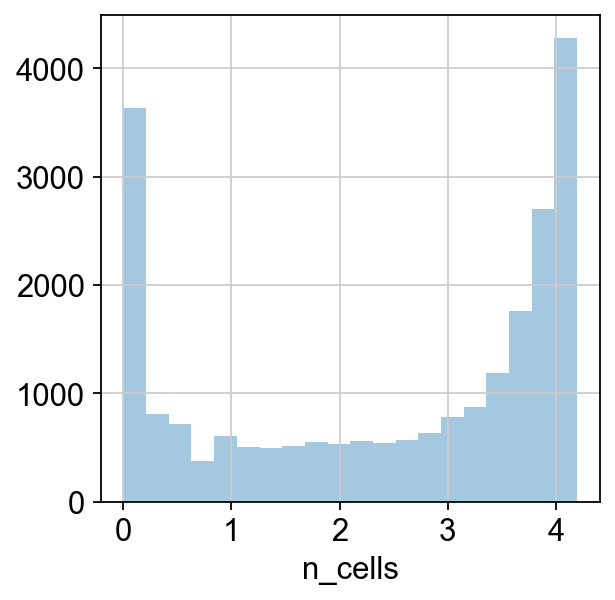

In [25]:
if bool_plot == True:
    ax = sb.distplot(np.log(adata_filtered.var['n_counts']+1)/np.log(10), kde = False)
    plt.show()
    ax = sb.distplot(np.log(adata_filtered.var['n_cells']+1)/np.log(10), kde = False)
    plt.show()

## Add normalization into objects

Basic total counts based normalization:

In [26]:
sf = adata_filtered.obs["total_count_with_transgenes"]
sf = sf / np.mean(sf)
adata_filtered.obs["sf"] = sf
adata_filtered.obs["sf_withtransgene"] = sf
for x in constructs + constructs_color:
    adata_filtered.obs[x+"_norm_log"] = np.log(adata_filtered.obs[x].values / sf + 1)

In [27]:
sf = adata_filtered.obs["total_count_without_transgenes"]
sf = sf / np.mean(sf)
adata_filtered.obs["sf_withouttransgene"] = sf

<AxesSubplot:xlabel='sf_withtransgene', ylabel='sf_withouttransgene'>

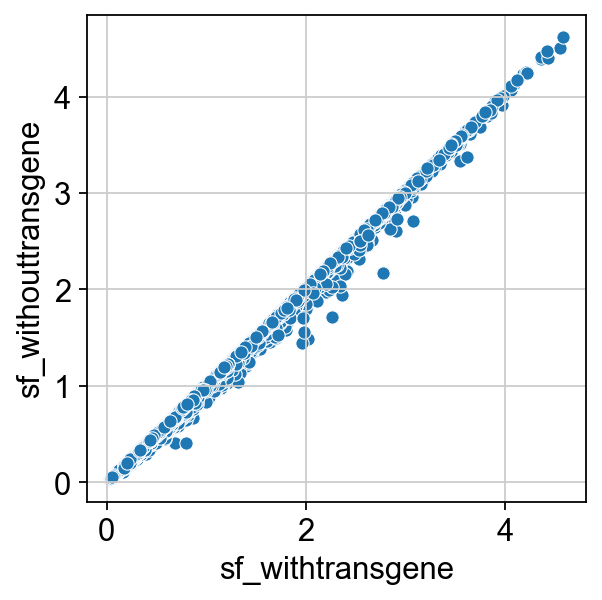

In [28]:
sb.scatterplot(
    x=adata_filtered.obs["sf_withtransgene"],
    y=adata_filtered.obs["sf_withouttransgene"]
)

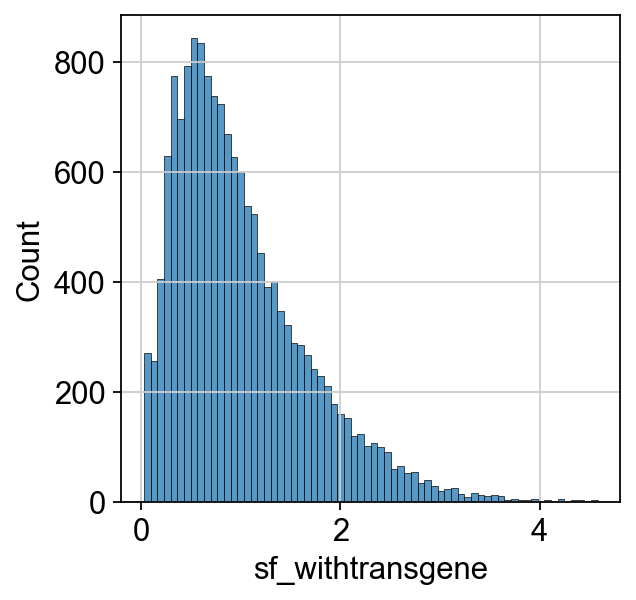

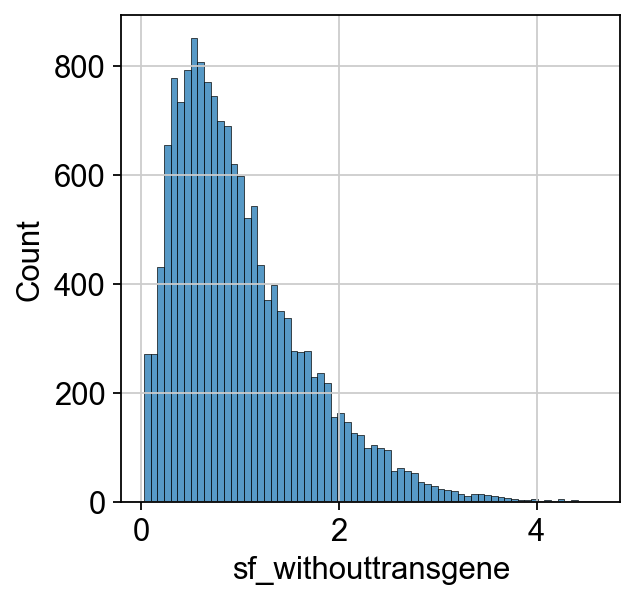

(0.028933043, 4.5817738)


In [29]:
sb.histplot(data=adata_filtered.obs, x="sf_withtransgene")
plt.show()
sb.histplot(data=adata_filtered.obs, x="sf_withouttransgene")
plt.show()
print((np.min(adata_filtered.obs["sf"].values),
       np.max(adata_filtered.obs["sf"].values)))

## Quality control: spliced-unspliced alignment for velocities

### Subset cells in spliced/unspliced by cell filter defined above

In [30]:
cell_bc_velo = [x.split(":")[-1].replace("x-", "-1-") 
                for x in adata_raw_velo.obs_names]
cell_bc_velo_set = set(cell_bc_velo)
idx_velo_to_raw = np.array([
    cell_bc_velo.index(x)
    if x in cell_bc_velo_set
    else np.nan
    for x in adata_filtered.obs_names
])
print("fraction of cells from adata_filtered not found in adata_raw_velo: %f" % np.mean(np.isnan(idx_velo_to_raw)))

fraction of cells from adata_filtered not found in adata_raw_velo: 0.000000


In [31]:
adata_filtered_velo = adata_raw_velo[idx_velo_to_raw, :].copy()
adata_filtered_velo.obs["obs_names_old"] = adata_filtered_velo.obs_names
adata_filtered_velo.obs_names = [
    x.split(":")[-1].split("x-")[0] + "-1-" + x.split("-")[-1]
    for x in adata_filtered_velo.obs_names
]
assert np.all([np.asarray(adata_filtered_velo.obs_names) == np.asarray(adata_filtered.obs_names)])
assert adata_filtered_velo.obs_names.shape[0] == np.unique(adata_filtered_velo.obs_names).shape[0]

## Load data corrected for ambient RNA

In [32]:
adata_soupx = {}
for x in fns_mtx_soupx:
    adata_soupx[x.split("/")[-1]] = sc.read_10x_mtx(x, cache=False)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [33]:
adata_soupx_merged = adata_soupx["MUC29498"].concatenate(
    list(adata_soupx.values())[1:], 
    batch_key='condition', 
    batch_categories=list(adata_soupx.keys())
)
adata_soupx_merged = adata_soupx_merged[adata_filtered.obs_names, :]
for k, v in constructs_dict.items():
    adata_soupx_merged.obs[k] = np.asarray(adata_soupx_merged[:,v[0]].X.todense()).flatten() +np.asarray(adata_soupx_merged[:, v[1]].X.todense()).flatten()
    adata_soupx_merged.obs[k+"_log"] = np.log(adata_soupx_merged.obs[k].values + 1.)
for k, v in constructs_color_dict.items():
    adata_soupx_merged.obs[k] = np.asarray(adata_soupx_merged[:,v[0]].X.todense()).flatten() +np.asarray(adata_soupx_merged[:, v[1]].X.todense()).flatten()
    adata_soupx_merged.obs[k+"_log"] = np.log(adata_soupx_merged.obs[k].values + 1.)
for x in endogenous_genes:
    adata_soupx_merged.obs[x] = np.asarray(adata_soupx_merged[:, x].X.todense()).flatten()
    adata_soupx_merged.obs[x+"_endogenous_log"] = np.log(np.asarray(adata_soupx_merged[:, x].X.todense()).flatten() + 1.)
constructs_counts = {}

print(adata_soupx_merged.shape)
genes = list(adata_soupx_merged.var_names) 
mask = np.ones(len(genes), dtype=bool)
for gg in constructs_dict.values():
    for g in gg:
        idx = genes.index(g)
        mask[idx] = False
for gg in constructs_color_dict.values():
    for g in gg:
        idx = genes.index(v[0])
        mask[idx] = False
        idx = genes.index(v[1])
        mask[idx] = False
adata_soupx_merged._inplace_subset_var(mask)

print(adata_soupx_merged.shape)
adata_soupx_merged.obs["total_count_without_transgenes"] = np.asarray(np.sum(adata_soupx_merged.X, axis=1)).flatten()
sf = adata_soupx_merged.obs["total_count_without_transgenes"]
sf = sf / np.mean(sf)
adata_soupx_merged.obs["sf"] = sf
for x in constructs + constructs_color:
    adata_soupx_merged.obs[x+"_norm_log"] = np.log(adata_soupx_merged.obs[x].values / sf + 1)

Trying to set attribute `.obs` of view, copying.


(15768, 22613)
(15768, 22601)


In [34]:
adata_soupx_merged

AnnData object with n_obs × n_vars = 15768 × 22601
    obs: 'condition', 'Ascl1', 'Ascl1_log', 'Foxa2', 'Foxa2_log', 'Myod1', 'Myod1_log', 'Oct4', 'Oct4_log', 'Sox2', 'Sox2_log', 'DsRed', 'DsRed_log', 'AcGFP1', 'AcGFP1_log', 'EBFP2', 'EBFP2_log', 'Ascl1_endogenous_log', 'Foxa2_endogenous_log', 'Myod1_endogenous_log', 'Pou5f1', 'Pou5f1_endogenous_log', 'Sox2_endogenous_log', 'total_count_without_transgenes', 'sf', 'Ascl1_norm_log', 'Foxa2_norm_log', 'Myod1_norm_log', 'Oct4_norm_log', 'Sox2_norm_log', 'DsRed_norm_log', 'AcGFP1_norm_log', 'EBFP2_norm_log'
    var: 'gene_ids', 'feature_types'

In [35]:
del adata_soupx

# Transgene abundance

## Endo- versus transgene

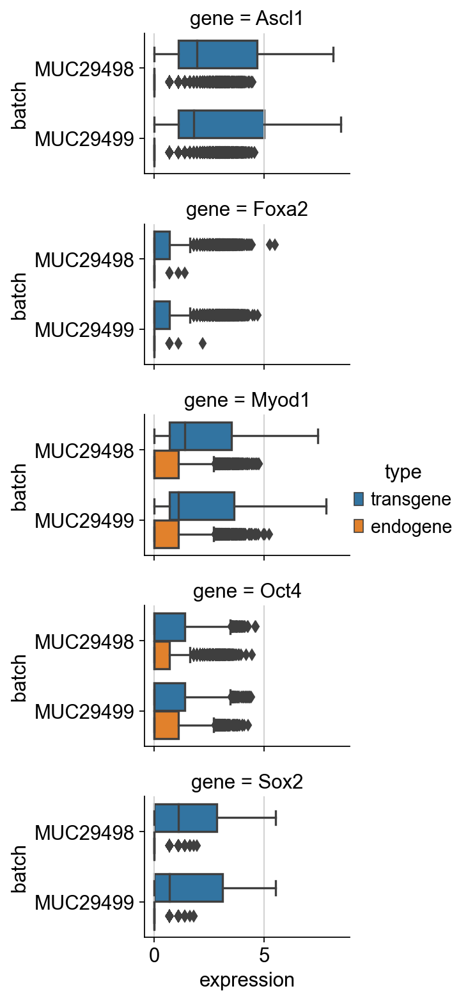

In [36]:
sns_data = pd.concat([
    pd.concat([
        pd.DataFrame({
            "batch": adata_filtered.obs["batch"],
            "expression": adata_filtered.obs[x + "_log"],
            "gene": x.split("_")[0] if x.split("_")[0] != "Pou5f1" else "Oct4",
            "type": "transgene"
        })
        for x in constructs
    ]),
    pd.concat([
        pd.DataFrame({
            "batch": adata_filtered.obs["batch"],
            "expression": adata_filtered.obs[x + "_endogenous_log"],
            "gene": x.split("_")[0] if x.split("_")[0] != "Pou5f1" else "Oct4",
            "type": "endogene"
        })
        for x in endogenous_genes
    ])
])
sb.catplot(
    data=sns_data, 
    kind="box", dodge=True, row="gene",
    x="expression", y="batch", hue="type",
    aspect=2, height=2
)
plt.show()

(['Ascl1', 'Foxa2', 'Myod1', 'Oct4', 'Sox2'], ['Ascl1', 'Foxa2', 'Myod1', 'Pou5f1', 'Sox2'])


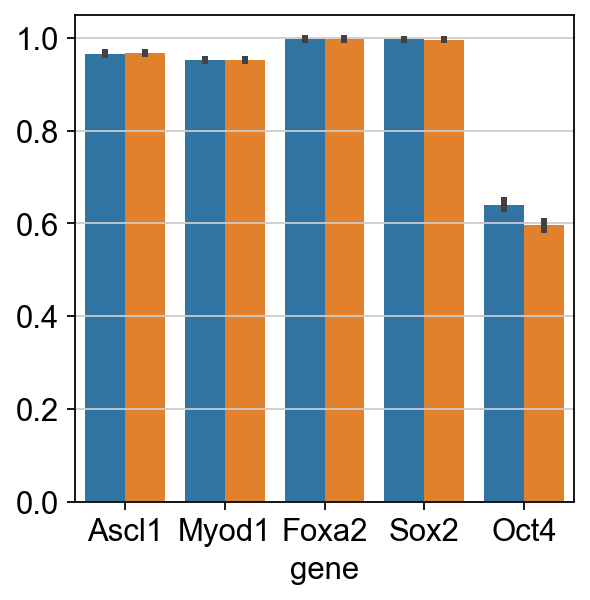

In [37]:
print((constructs, endogenous_genes))
sns_data = pd.concat([
    pd.DataFrame({
        "batch": adata_filtered.obs["batch"],
        "fraction_transgene": (np.exp(adata_filtered.obs[x + "_log"])-1) / 
            ((np.exp(adata_filtered.obs[x + "_log"])-1) + 
             (np.exp(adata_filtered.obs[y + "_endogenous_log"])-1)),
        "gene": x.split("_")[0] if x.split("_")[0] != "Pou5f1" else "Oct4",
        "type": "transgene"
    })
    for x, y in zip(constructs, endogenous_genes)
])
sns_data["gene"] = pd.Categorical(sns_data["gene"].values, 
                                  categories=["Ascl1", "Myod1", "Foxa2", "Sox2", "Oct4"])
fig, ax = plt.subplots(1,1)
sb.barplot(
    data=sns_data, 
    x="gene", y="fraction_transgene", hue="batch", ax=ax,
)
ax.legend_.remove()
ax.set_ylabel("")
plt.savefig(dir_out + "EV1b.pdf")
plt.show()

In [38]:
del adata_raw
del adata_raw_velo

## Abundance after ambient RNA correction

In [39]:
# Save corrected values in adata_filtered:
for x in constructs:
    adata_filtered.obs[x + "_norm_log_corrected"] = adata_soupx_merged[adata_filtered.obs_names, :].obs[x].values
    adata_filtered.obs[x + "_log_corrected"] = adata_soupx_merged[adata_filtered.obs_names, :].obs[x + "_log"].values
    adata_filtered.obs[x + "_norm_log_corrected"] = adata_soupx_merged[adata_filtered.obs_names, :].obs[x + "_norm_log"].values

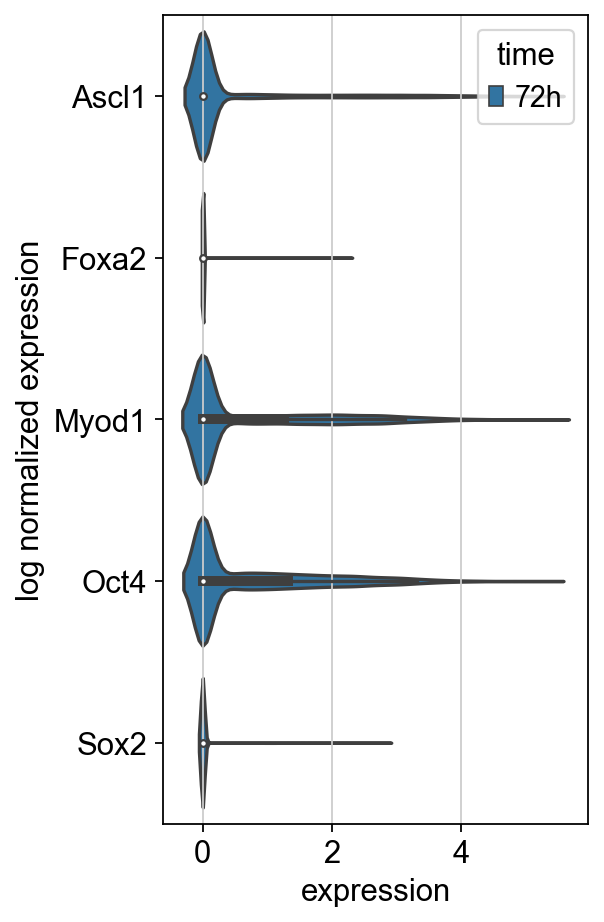

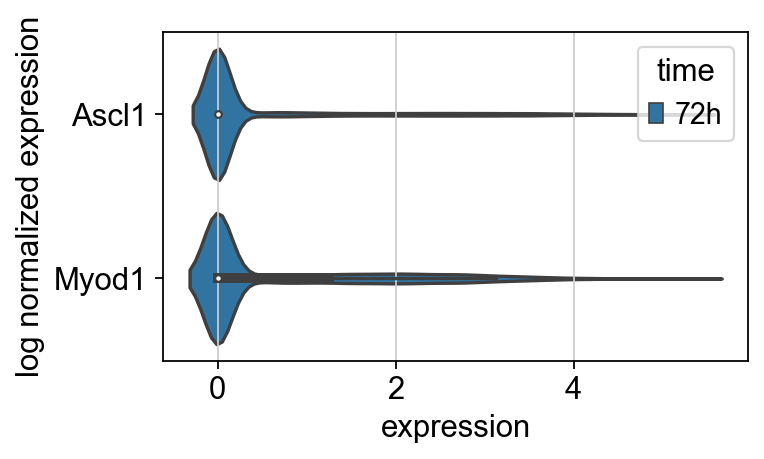

/Users/davfischer/opt/miniconda3/envs/collideseq/lib/python3.8/site-packages/seaborn/categorical.py:373: UserWarning: Attempting to set identical left == right == -0.5 results in singular transformations; automatically expanding.
  ax.set_xlim(-.5, len(self.plot_data) - .5, auto=None)
No handles with labels found to put in legend.


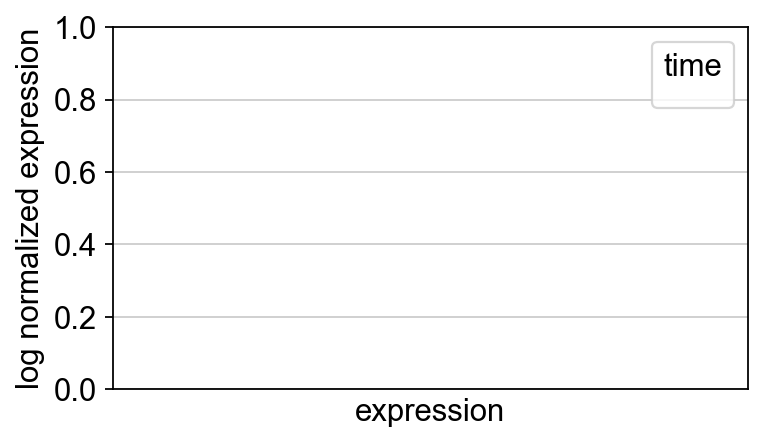

In [40]:
sns_data = pd.concat([
    pd.DataFrame({
        "gene": x.split("_")[0],
        "expression": adata_soupx_merged[adata_filtered.obs_names, :].obs[x + "_norm_log"].values,
        "time": adata_filtered.obs["time"].values,
    }) for x in constructs
])
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4, 6))
sb.violinplot(
    data=sns_data,
    y="gene", x="expression", hue="time",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=0)
axs.set_ylabel("log normalized expression")
plt.tight_layout()
plt.savefig(dir_out + "transgene_expression_by_timepoint.pdf")
plt.show()

fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(5, 3))
sb.violinplot(
    data=sns_data.loc[[x in ["Ascl1", "Myod1"] for x in sns_data["gene"].values]],
    y="gene", x="expression", hue="time",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=0)
axs.set_ylabel("log normalized expression")
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(5, 3))
sb.violinplot(
    data=sns_data.loc[[x in ["Hnf1a", "Pou5f1"] for x in sns_data["gene"].values]],
    y="gene", x="expression", hue="time",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=0)
axs.set_ylabel("log normalized expression")
plt.tight_layout()
plt.show()

# Unsupervised overview of data set

In [41]:
downstream_genes = ["sox4", "sox11", "hes6", "id1", "id2", "id3", 
                    "myog", "des"]
print([x for x in downstream_genes if x not in adata_filtered.var_names])

['sox4', 'sox11', 'hes6', 'id1', 'id2', 'id3', 'myog', 'des']


## UMAP and louvain clustering

In [42]:
if bool_recomp == True:   
    adata_proc = adata_filtered.copy()
    adata_proc.var_names = [x.lower() for x in adata_proc.var_names]
    adata_proc.raw = adata_proc
    sc.pp.normalize_per_cell(adata_proc)
    sc.pp.log1p(adata_proc)
    sc.pp.filter_genes(adata_proc, min_cells=100)
    sc.pp.highly_variable_genes(adata_proc, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_proc, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata_proc, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_proc)
    if bool_recluster == True:
        sc.tl.louvain(adata_proc, resolution=2.2, flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_proc.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_proc.csv")
            with open(dir_anndata+"uns_adata_proc.pickle", "wb") as f:
                pickle.dump(obj=adata_proc.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_proc.csv')
        adata_proc.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_proc.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_proc.obs['louvain'] = pd.Series(adata_proc.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_proc.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_proc.uns.keys()):        
                adata_proc.uns[k] = v
    # Compute cell cycle scores:
    s_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[:43].values]
    g2m_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[43:].values]
    sc.tl.score_genes_cell_cycle(adata_proc, s_genes=s_phase_genes, g2m_genes=g2m_phase_genes)
else:
    adata_proc = sc.read(dir_anndata+'adata_proc.h5ad') 

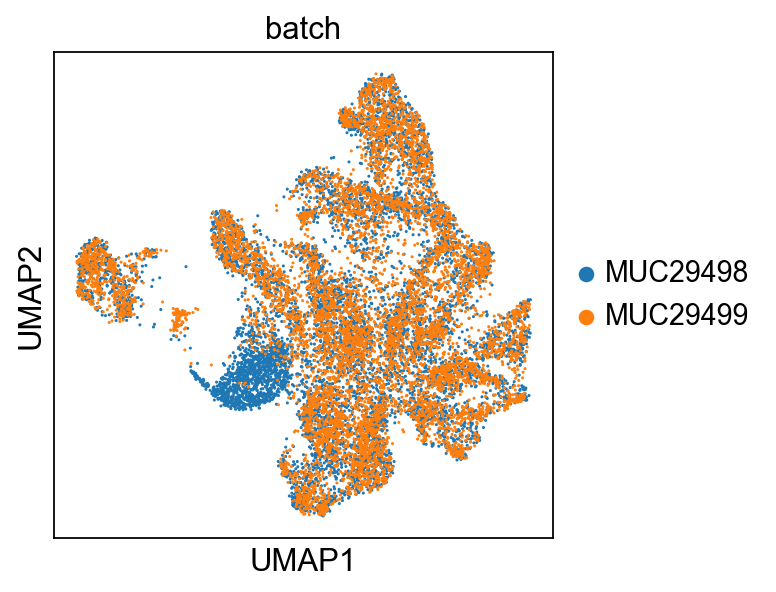

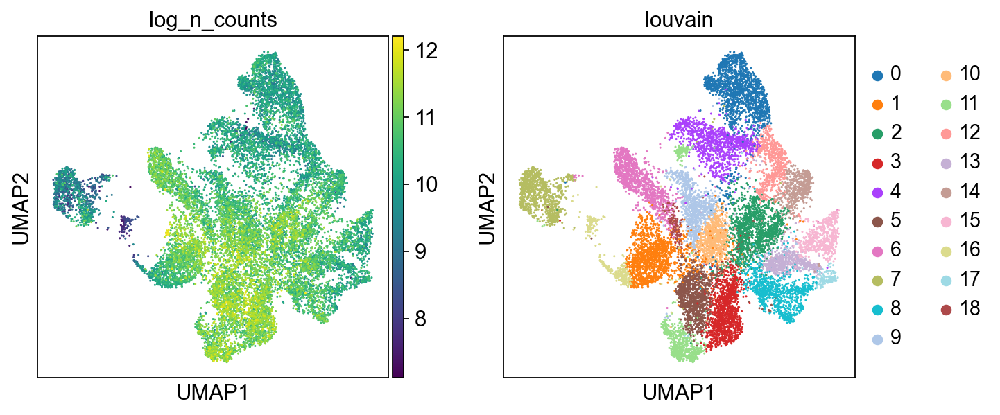

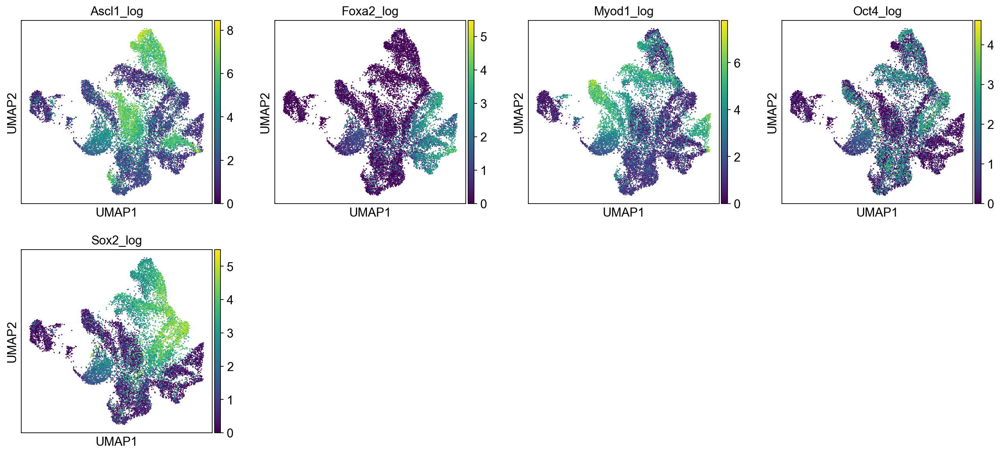

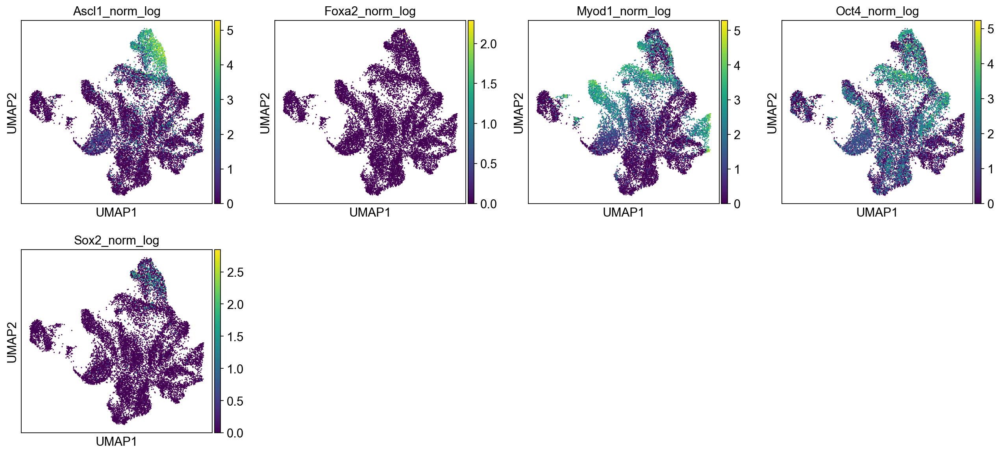

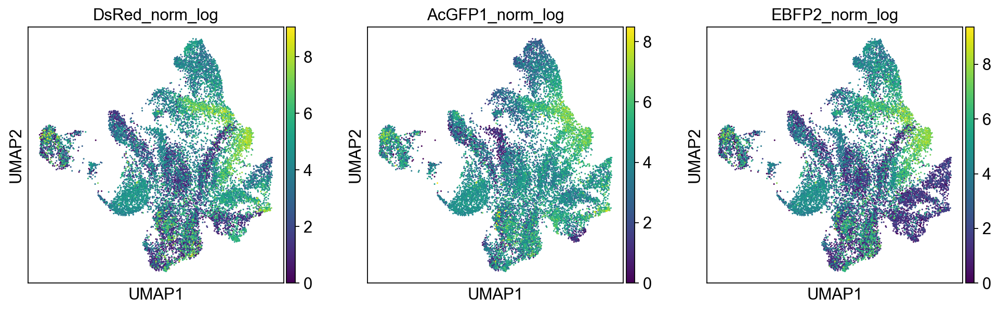

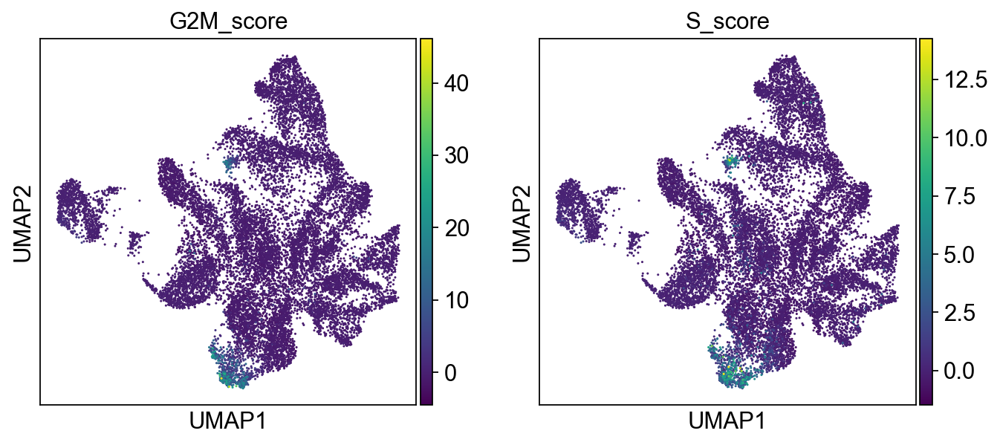

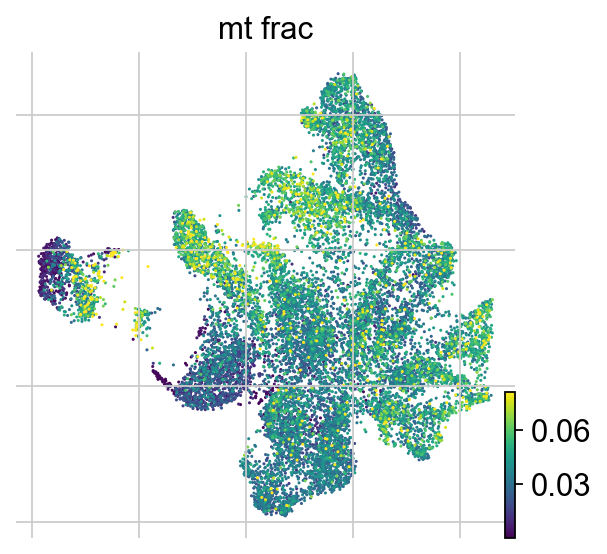

In [43]:
sc.pl.umap(adata_proc, color=["batch"])
sc.pl.umap(adata_proc, color=["log_n_counts", "louvain"])
sc.pl.umap(adata_proc, color=[x+"_log" for x in constructs])
sc.pl.umap(adata_proc, color=[x+"_norm_log" for x in constructs])
sc.pl.umap(adata_proc, color=[x+"_norm_log" for x in constructs_color])
sc.pl.umap(adata_proc, color=["G2M_score", "S_score"])
scv.pl.umap(adata_proc, color=["mt_frac"], perc=[0,98])

### dot plots

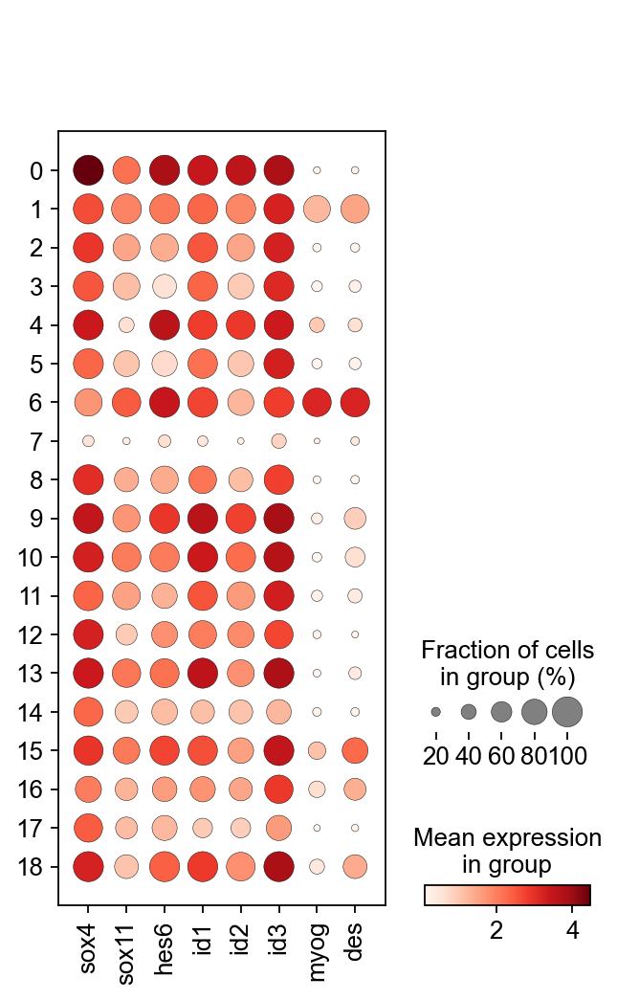

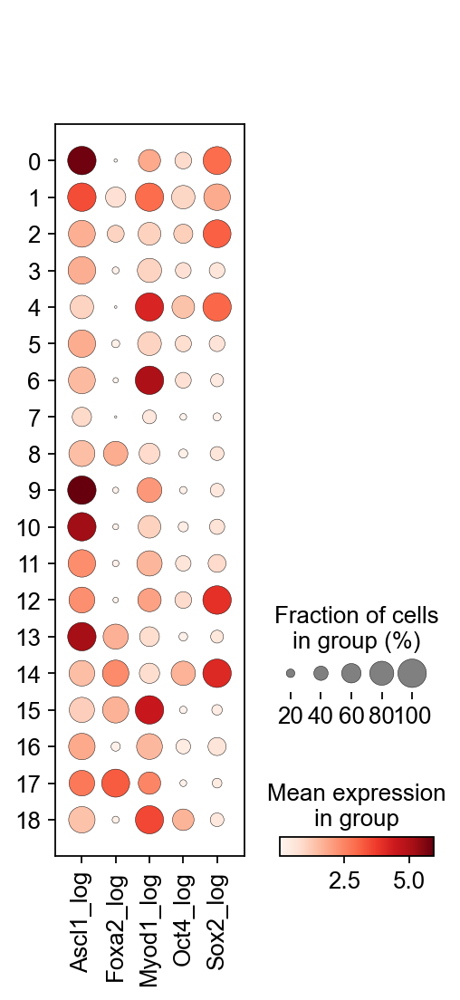

In [44]:
sc.pl.dotplot(
    adata_proc, 
    var_names=downstream_genes,
    groupby="louvain", 
    use_raw=False)
sc.pl.dotplot(
    adata_proc, 
    var_names=[x + "_log" for x in constructs],
    groupby="louvain", 
    use_raw=False)

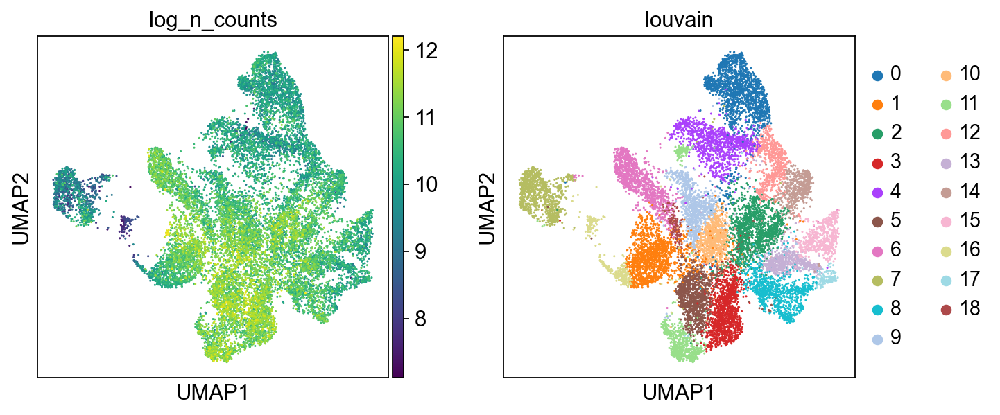

In [45]:
sc.pl.umap(adata_proc, color=["log_n_counts", "louvain"])

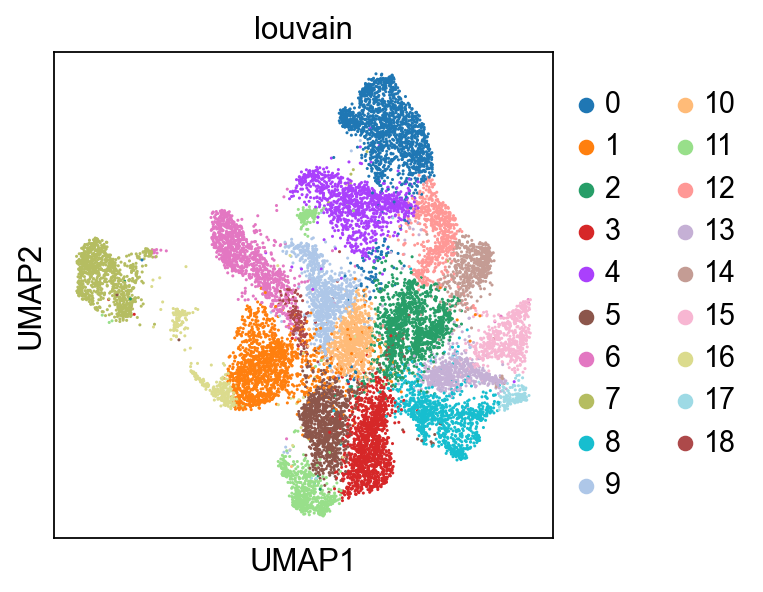

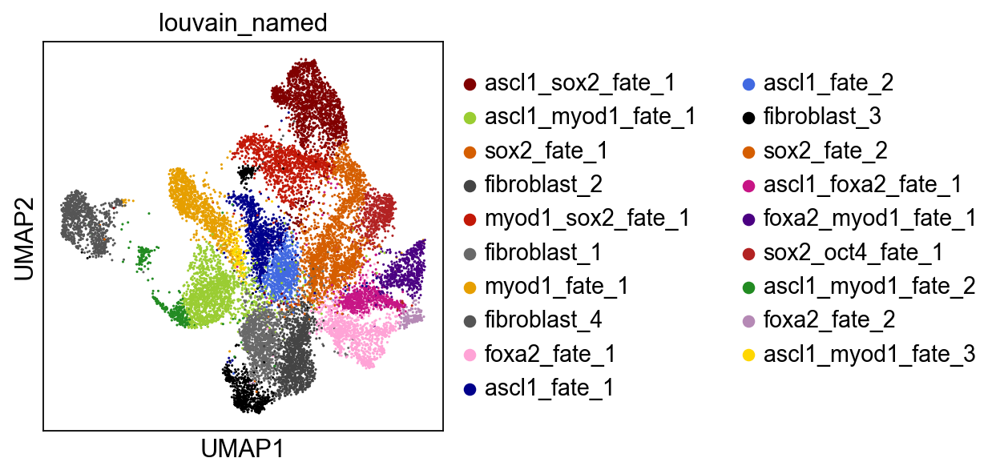

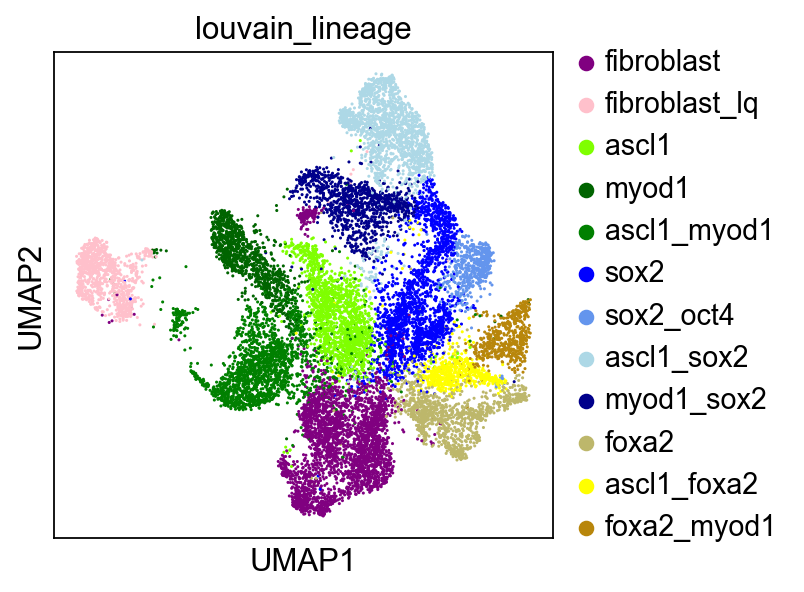

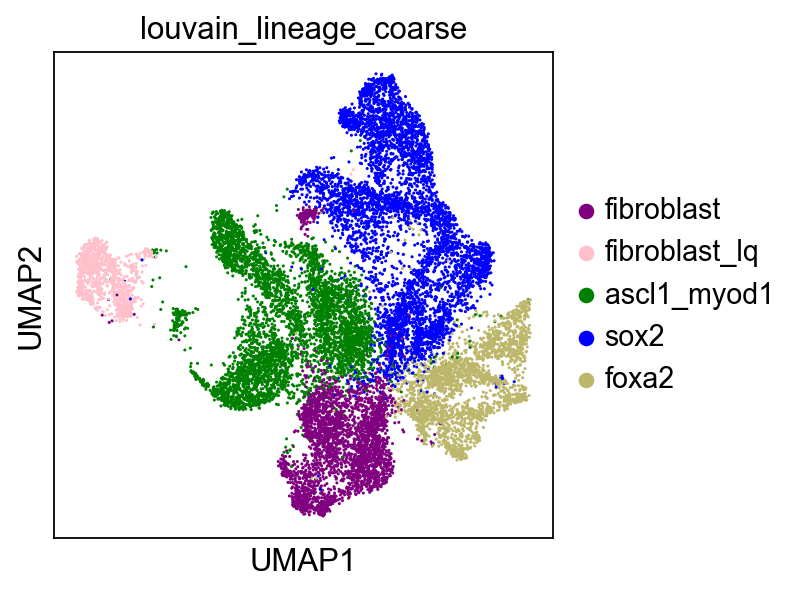

In [46]:
id_map = {
    "0": "ascl1_sox2_fate_1",
    "1": "ascl1_myod1_fate_1",
    "2": "sox2_fate_1",
    "3": "fibroblast_2",
    "4": "myod1_sox2_fate_1",
    "5": "fibroblast_1",
    "6": "myod1_fate_1",
    "7": "fibroblast_4",
    "8": "foxa2_fate_1",
    "9": "ascl1_fate_1",
    "10": "ascl1_fate_2",
    "11": "fibroblast_3",
    "12": "sox2_fate_2",
    "13": "ascl1_foxa2_fate_1",
    "15": "foxa2_myod1_fate_1",
    "14": "sox2_oct4_fate_1",
    "16": "ascl1_myod1_fate_2",
    "17": "foxa2_fate_2",
    "18": "ascl1_myod1_fate_3",
}
id_cmap = {
    "fibroblast_1": 'dimgray',
    "fibroblast_2": '#444444',
    "fibroblast_3": 'black',
    "fibroblast_4": "#555555",
    "sox2_fate_1": '#D55E00',
    "sox2_fate_2": '#D55E00',
    "sox2_oct4_fate_1": 'firebrick',
    "ascl1_sox2_fate_1": 'maroon',
    "myod1_sox2_fate_1": '#C21807',
    "myod1_fate_1": "#E69F00",
    "ascl1_fate_1": 'darkblue',
    "ascl1_fate_2": "royalblue",
    "ascl1_myod1_fate_1": 'yellowgreen',
    "ascl1_myod1_fate_2": "forestgreen",
    "ascl1_myod1_fate_3": "gold",
    "foxa2_fate_1": '#FFA3D6',
    "foxa2_fate_2": '#B589B5',
    "ascl1_foxa2_fate_1": "mediumvioletred",
    "foxa2_myod1_fate_1": 'indigo',
}
id_map_lineage = {
    "0": "ascl1_sox2",
    "1": "ascl1_myod1",
    "2": "sox2",
    "3": "fibroblast",
    "4": "myod1_sox2",
    "5": "fibroblast",
    "6": "myod1",
    "7": "fibroblast_lq",
    "8": "foxa2",
    "9": "ascl1",
    "10": "ascl1",
    "11": "fibroblast",
    "12": "sox2",
    "13": "ascl1_foxa2",
    "15": "foxa2_myod1",
    "14": "sox2_oct4",
    "16": "ascl1_myod1",
    "17": "foxa2",
    "18": "ascl1_myod1",
}
id_lineage_cmap = {
    "fibroblast": 'purple',
    "fibroblast_lq": 'pink',
    "ascl1": 'chartreuse',
    "myod1": "darkgreen",
    "ascl1_myod1": "green",
    "sox2": 'blue',
    "sox2_oct4": 'cornflowerblue',
    "ascl1_sox2": 'lightblue',
    "myod1_sox2": 'darkblue',
    "foxa2": 'darkkhaki',
    "ascl1_foxa2": "yellow",
    "foxa2_myod1": 'darkgoldenrod',
}
id_map_lineage_coarse = {
    "0": "sox2",
    "1": "ascl1_myod1",
    "2": "sox2",
    "3": "fibroblast",
    "4": "sox2",
    "5": "fibroblast",
    "6": "ascl1_myod1",
    "7": "fibroblast_lq",
    "8": "foxa2",
    "9": "ascl1_myod1",
    "10": "ascl1_myod1",
    "11": "fibroblast",
    "12": "sox2",
    "13": "foxa2",
    "15": "foxa2",
    "14": "sox2",
    "16": "ascl1_myod1",
    "17": "foxa2",
    "18": "ascl1_myod1",
}
id_lineage_coarse_cmap = {
    "fibroblast": 'purple',
    "fibroblast_lq": 'pink',
    "ascl1_myod1": "green",
    "sox2": 'blue',
    "foxa2": 'darkkhaki',
}
for x in ['louvain_named_colors', 'louvain_lineage_colors', 'louvain_lineage_coarse_colors']:
    if x in adata_proc.uns.keys():
        del adata_proc.uns[x]
    if x.strip("_colors") in adata_proc.obs.columns:
        del adata_proc.obs[x]
adata_proc.obs["louvain_named"] = pd.Categorical(
    [id_map[x] for x in adata_proc.obs["louvain"].values], 
    categories=list(id_map.values()))
adata_proc.obs["louvain_lineage"] = pd.Categorical(
    [id_map_lineage[x] for x in adata_proc.obs["louvain"].values], 
    categories=list(id_lineage_cmap.keys()))
adata_proc.obs["louvain_lineage_coarse"] = pd.Categorical(
    [id_map_lineage_coarse[x] for x in adata_proc.obs["louvain"].values], 
    categories=list(id_lineage_coarse_cmap.keys()))
sc.pl.umap(adata_proc, color=["louvain"])
sc.pl.umap(
    adata_proc, color=["louvain_named"], 
    palette = [id_cmap[k] for k in id_map.values()],
)
sc.pl.umap(
    adata_proc, color=["louvain_lineage"], 
    palette=list(id_lineage_cmap.values()),
)
sc.pl.umap(
    adata_proc, color=["louvain_lineage_coarse"], 
    palette=list(id_lineage_coarse_cmap.values()),
)

### Visualise construct distribution

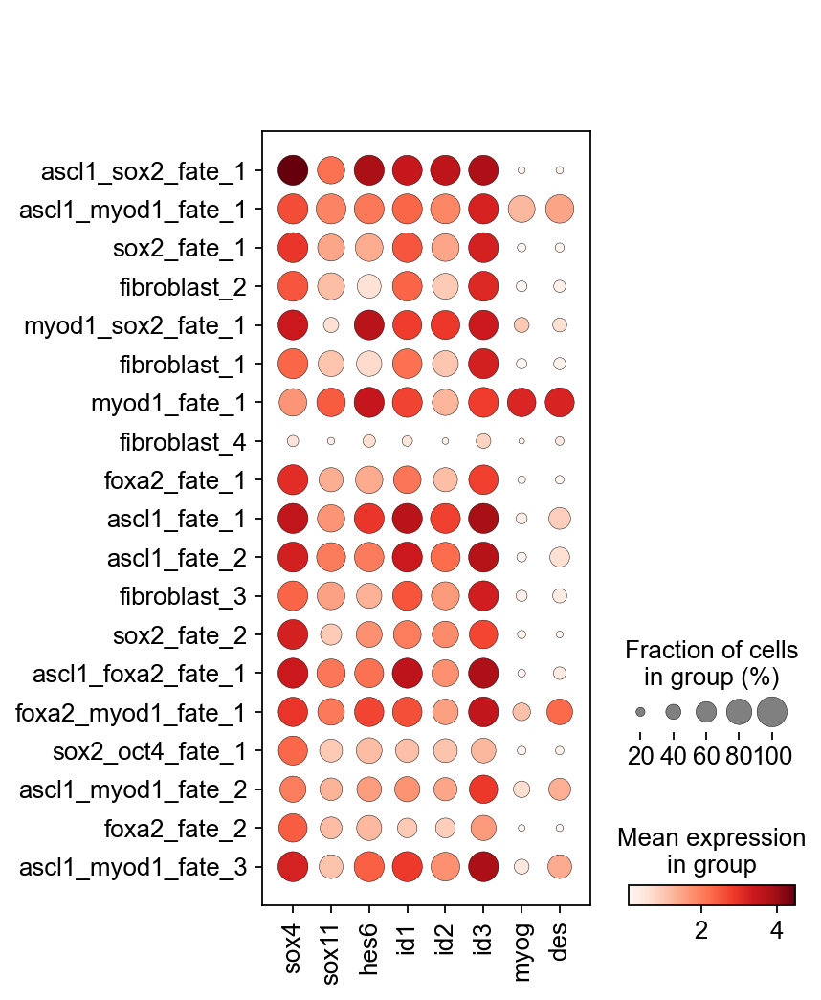

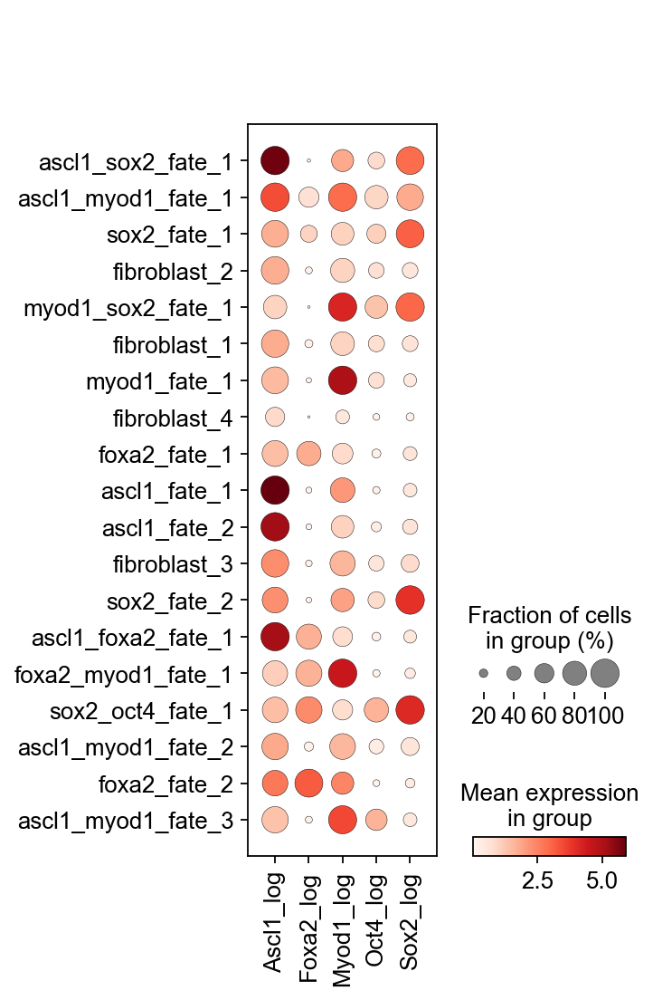

In [47]:
sc.pl.dotplot(
    adata_proc, 
    var_names=downstream_genes,
    groupby="louvain_named", 
    use_raw=False)
sc.pl.dotplot(
    adata_proc, 
    var_names=[x + "_log" for x in constructs],
    groupby="louvain_named", 
    use_raw=False)

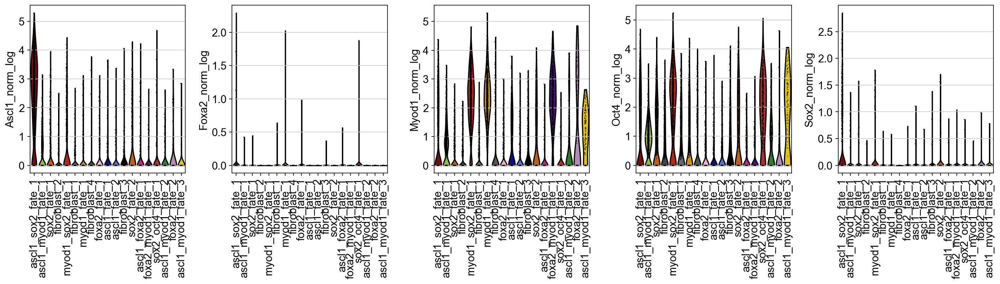

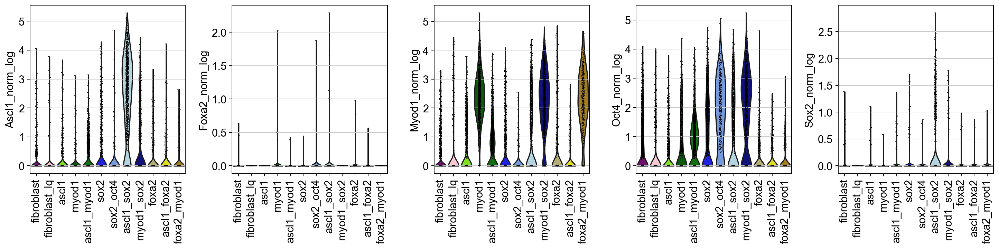

In [48]:
sc.pl.violin(adata_proc, groupby="louvain_named", keys=[x+"_norm_log" for x in constructs], rotation=90)
sc.pl.violin(adata_proc, groupby="louvain_lineage", keys=[x+"_norm_log" for x in constructs], rotation=90)

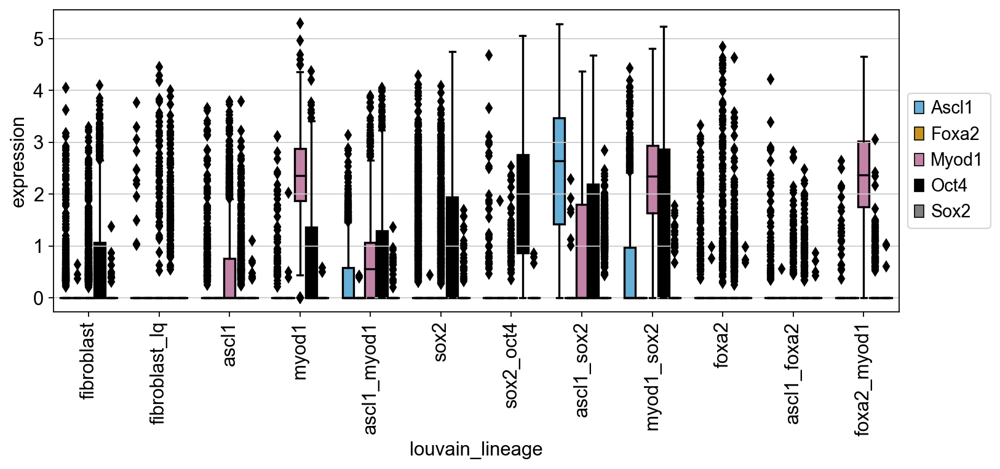

In [49]:
obs_temp = adata_proc.obs.copy()

obs_temp = pd.concat([
    pd.DataFrame({
        "gene": x,
        "louvain_lineage": obs_temp["louvain_lineage"].values,
        "expression": obs_temp[x+"_norm_log"].values
    }) for x in [xx for xx in constructs if xx != "Pou5f1_transgene"]
])
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
sb.boxplot(
    data=obs_temp,
    x="louvain_lineage",
    y="expression",
    hue="gene",
    ax=axs,  
    palette=['#56B4E9', '#E69F00', '#CC79A7', "black", "grey"],
)
box = axs.get_position()
axs.set_position([box.x0, box.y0, box.width * 0.95, box.height])
axs.legend(loc='center left', bbox_to_anchor=(1, 0.5))
axs.xaxis.set_tick_params(rotation=90)
plt.tight_layout()

### Define unified cell cycle score

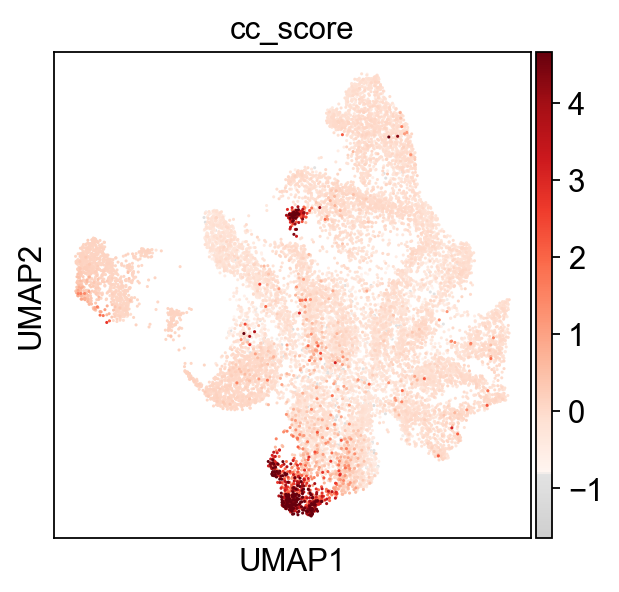

In [50]:
adata_proc.obs["cc_score"] = np.mean(
    (
        adata_proc.obs[["G2M_score", "S_score"]].values -
        adata_proc.obs[["G2M_score", "S_score"]].values.mean(axis=0)
    ) / adata_proc.obs[["G2M_score", "S_score"]].values.std(axis=0),
    axis=1
)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(4.2, 4))
sc.pl.umap(
    adata_proc, 
    color=["cc_score"],
    cmap=mymap,
    vmin=np.min(adata_proc.obs["cc_score"].values), 
    vmax=np.quantile(adata_proc.obs["cc_score"].values, q=0.99),
    show=False,
    ax=ax
)
plt.show()

## UMAP and louvain clustering after ambient RNA correction

In [51]:
if bool_recomp == True:   
    adata_proc_ambient = adata_soupx_merged[adata_filtered.obs_names, :].copy()
    adata_proc_ambient.obs = adata_filtered.obs
    adata_proc_ambient.var_names = [x.lower() for x in adata_proc_ambient.var_names]
    adata_proc_ambient.raw = adata_proc_ambient
    sc.pp.normalize_per_cell(adata_proc_ambient)
    sc.pp.log1p(adata_proc_ambient)
    sc.pp.filter_genes(adata_proc_ambient, min_cells=100)
    sc.pp.highly_variable_genes(adata_proc_ambient, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_proc_ambient, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata_proc_ambient, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_proc_ambient)
    if bool_recluster == True:
        sc.tl.louvain(adata_proc_ambient, resolution=2.2, flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_proc_ambient.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_proc_ambient.csv")
            with open(dir_anndata+"uns_adata_proc_ambient.pickle", "wb") as f:
                pickle.dump(obj=adata_proc_ambient.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_proc_ambient.csv')
        adata_proc_ambient.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_proc_ambient.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_proc_ambient.obs['louvain'] = pd.Series(adata_proc_ambient.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_proc_ambient.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_proc_ambient.uns.keys()):        
                adata_proc_ambient.uns[k] = v
    # Compute cell cycle scores:
    s_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[:43].values]
    g2m_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[43:].values]
    sc.tl.score_genes_cell_cycle(adata_proc_ambient, s_genes=s_phase_genes, g2m_genes=g2m_phase_genes)
else:
    adata_proc_ambient = sc.read(dir_anndata+'adata_proc_ambient.h5ad') 

In [52]:
adata_proc_ambient.obs["cc_score"] = np.mean(
    (
        adata_proc_ambient.obs[["G2M_score", "S_score"]].values -
        adata_proc_ambient.obs[["G2M_score", "S_score"]].values.mean(axis=0)
    ) / adata_proc_ambient.obs[["G2M_score", "S_score"]].values.std(axis=0),
    axis=1
)

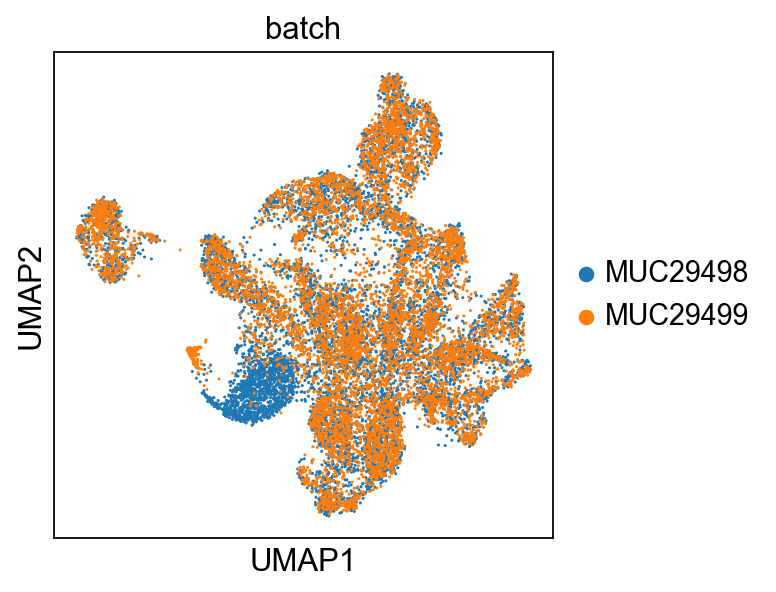

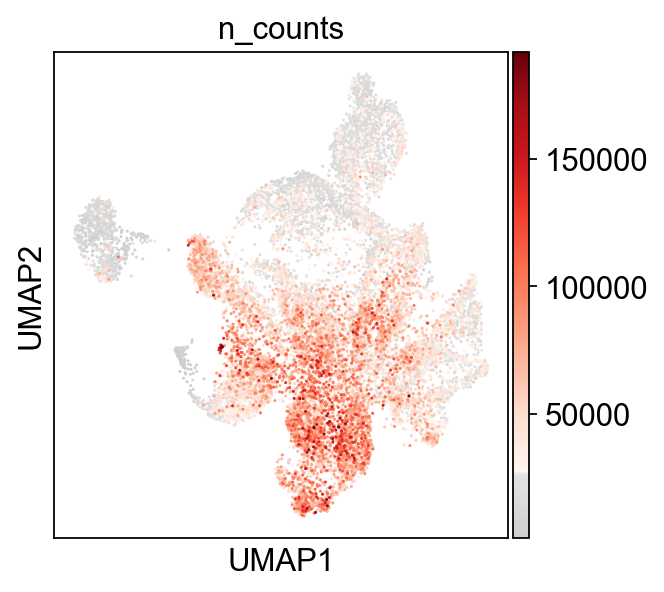

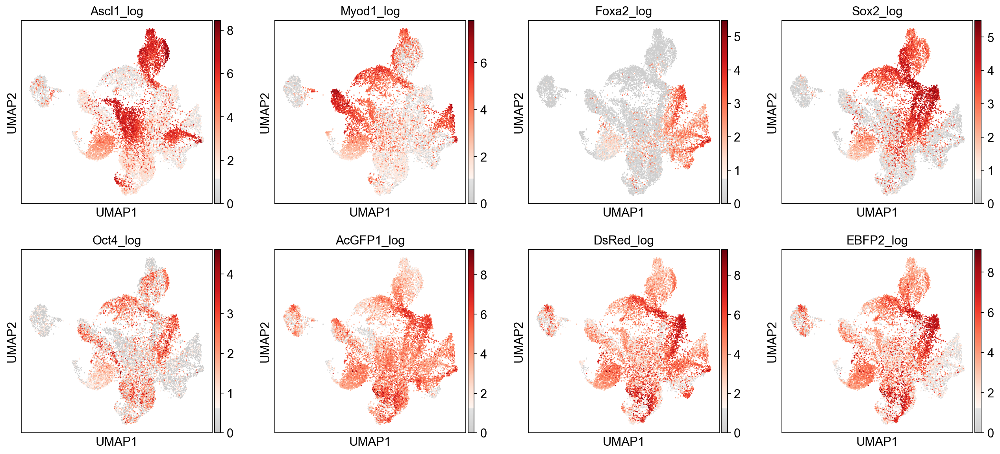

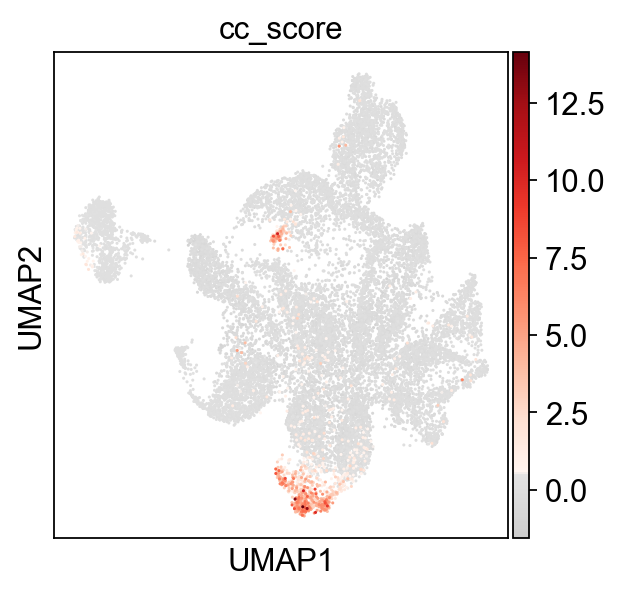

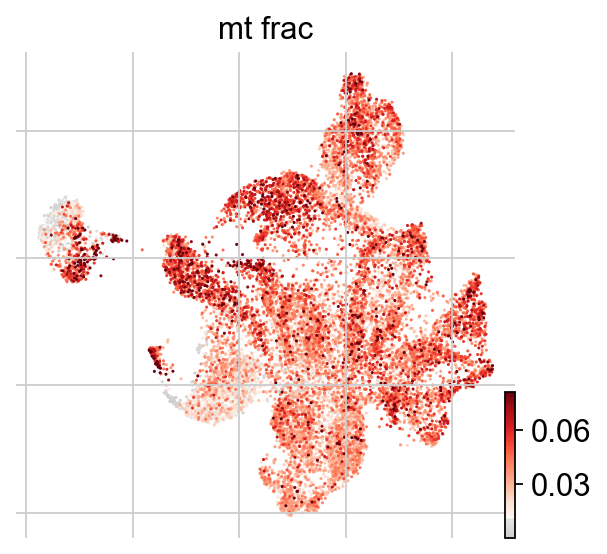

In [53]:
sc.pl.umap(adata_proc_ambient, color=["batch"])
sc.pl.umap(adata_proc_ambient, color=["n_counts"], cmap=mymap)
sc.pl.umap(adata_proc_ambient, color=[x+"_log" for x in [
    'Ascl1', 'Myod1', 'Foxa2', 'Sox2', 'Oct4', 'AcGFP1', 'DsRed', 'EBFP2'
]], ncols=4, cmap=mymap)
sc.pl.umap(adata_proc_ambient, color=["cc_score"], cmap=mymap)
scv.pl.umap(adata_proc_ambient, color=["mt_frac"], perc=[0,98], cmap=mymap)

In [54]:
sc.pl.umap(adata_proc_ambient, color=["batch"], save="EV1c", show=False)
sc.pl.umap(
    adata_proc_ambient, color=["cc_score"], 
    vmin=np.min(adata_proc.obs["cc_score"].values), 
    vmax=np.quantile(adata_proc.obs["cc_score"].values, q=0.99), cmap=mymap, 
    save="EV1d", show=False
)
sc.pl.umap(adata_proc_ambient, 
           color=[x+"_log" for x in ['AcGFP1', 'DsRed', 'EBFP2']], ncols=3, 
           save="EV1e", cmap=mymap, show=False)
sc.pl.umap(adata_proc_ambient, 
           color=[x+"_log" for x in ['Ascl1', 'Myod1', 'Foxa2', 'Sox2', 'Oct4',]], ncols=5, 
           save="EV1f", cmap=mymap, show=False)

[<AxesSubplot:title={'center':'Ascl1_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Myod1_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Foxa2_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Sox2_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Oct4_log'}, xlabel='UMAP1', ylabel='UMAP2'>]

## Batch-corrected UMAP and louvain clustering of all samples

In [55]:
if bool_recomp == True:   
    adata_proc_corrected = adata_filtered.copy()
    adata_proc_corrected.var_names = [x.lower() for x in adata_proc_corrected.var_names]
    adata_proc_corrected.raw = adata_proc_corrected
    sc.pp.normalize_per_cell(adata_proc_corrected)
    sc.pp.log1p(adata_proc_corrected)
    sc.pp.filter_genes(adata_proc_corrected, min_cells=100)
    sc.pp.highly_variable_genes(adata_proc_corrected, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_proc_corrected, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.external.pp.bbknn(adata_proc_corrected, batch_key="batch", approx=True, metric='angular')
    sc.tl.umap(adata_proc_corrected)
    if bool_recluster == True:
        sc.tl.louvain(adata_proc_corrected, resolution=1.2, flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_proc_corrected.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_proc_corrected.csv")
        with open(dir_anndata+"uns_adata_proc_corrected.pickle", "wb") as f:
            pickle.dump(obj=adata_proc_corrected.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_proc_corrected.csv')
        adata_proc_corrected.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_proc_corrected.obs['louvain'] = pd.Series(adata_proc_corrected.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata+'uns_adata_proc_corrected.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_proc_corrected.uns.keys()):        
                adata_proc_corrected.uns[k] = v
    # Compute cell cycle scores:
    s_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[:43].values]
    g2m_phase_genes = [x[0].lower() for x in pd.read_csv(dir_cc_gene_set, header=None)[43:].values]
    sc.tl.score_genes_cell_cycle(adata_proc_corrected, s_genes=s_phase_genes, g2m_genes=g2m_phase_genes)
else:
    adata_proc_corrected = sc.read(dir_anndata+'adata_proc_corrected.h5ad') 

Transfer cluster annotation on uncorrected data:

In [56]:
adata_proc_corrected.obs["louvain_uncorrected"] = adata_proc_corrected.obs["louvain"]

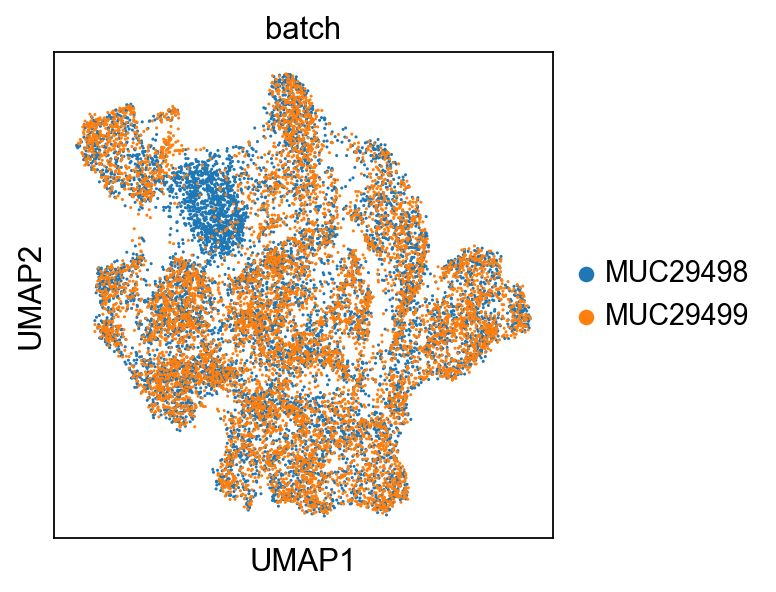

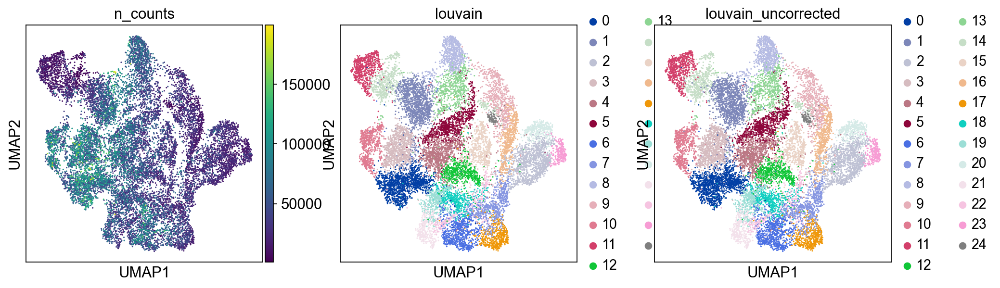

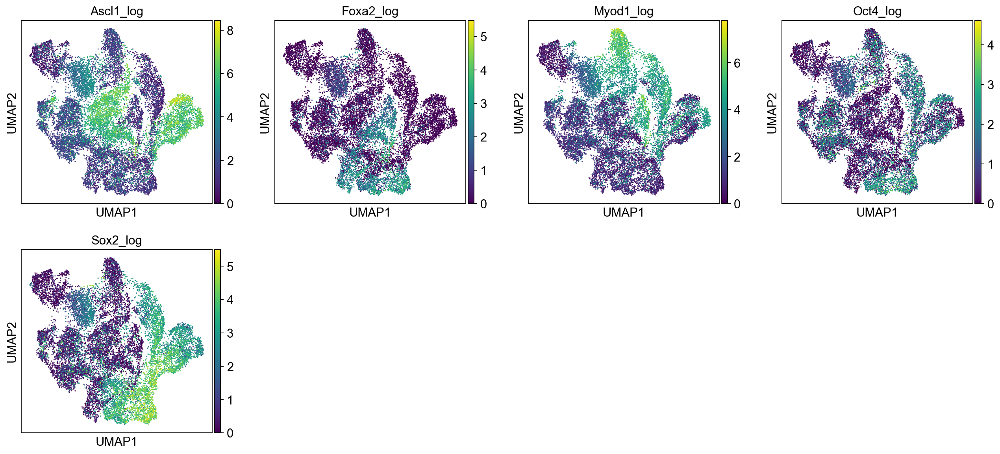

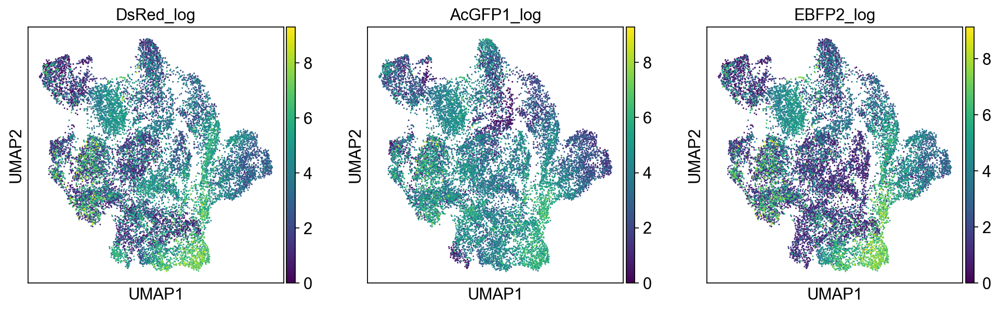

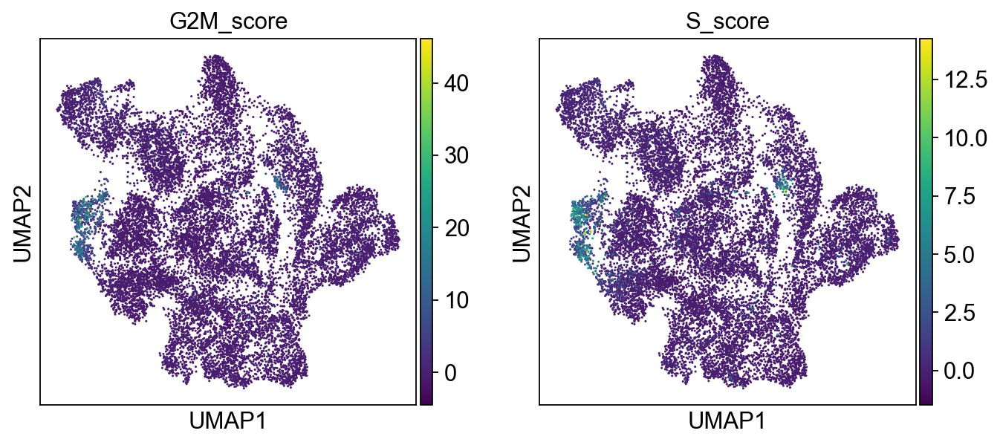

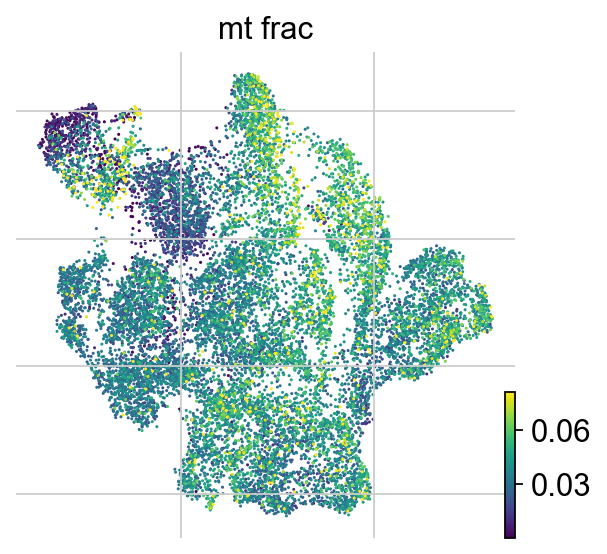

In [57]:
sc.pl.umap(adata_proc_corrected, color=["batch"])
sc.pl.umap(adata_proc_corrected, color=["n_counts", "louvain", "louvain_uncorrected"])
sc.pl.umap(adata_proc_corrected, color=[x+"_log" for x in constructs])
sc.pl.umap(adata_proc_corrected, color=[x+"_log" for x in constructs_color])
sc.pl.umap(adata_proc_corrected, color=["G2M_score", "S_score"])
scv.pl.umap(adata_proc_corrected, color=["mt_frac"], perc=[0,98])

## Define adata object to use from here on

In [59]:
adata_proc = adata_proc

Manuscript figure panels Fig 1:

In [60]:
sc.pl.umap(adata_proc, color=["batch"], save="1g", show=False)
sc.pl.umap(
    adata_proc, color=["cc_score"], 
    vmin=np.min(adata_proc.obs["cc_score"].values), 
    vmax=np.quantile(adata_proc.obs["cc_score"].values, q=0.99), cmap=mymap, 
    save="1h", show=False
)
sc.pl.umap(adata_proc, 
           color=[x+"_log" for x in ['AcGFP1', 'DsRed', 'EBFP2']], ncols=3, 
           save="1e", cmap=mymap, show=False)
sc.pl.umap(adata_proc, 
           color=[x+"_log" for x in ['Ascl1', 'Myod1', 'Foxa2', 'Sox2', 'Oct4',]], ncols=5, 
           save="1f", cmap=mymap, show=False)

[<AxesSubplot:title={'center':'Ascl1_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Myod1_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Foxa2_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Sox2_log'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Oct4_log'}, xlabel='UMAP1', ylabel='UMAP2'>]

Manuscript figure panels Fig 2:

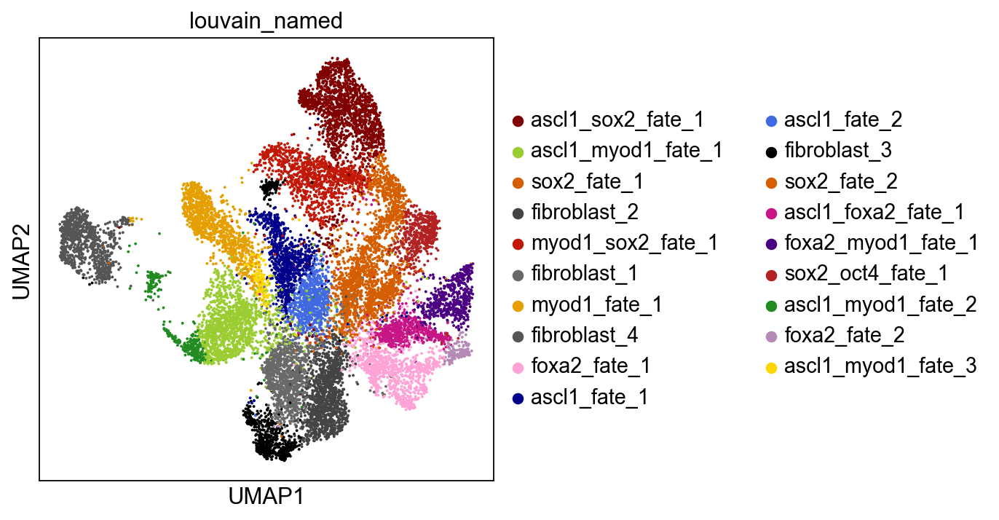

In [61]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(5, 5))
ax = sc.pl.umap(adata_proc, color='louvain_named', size=12, ax=ax, show=False)
plt.savefig(dir_out + "2b1.pdf")
plt.show()

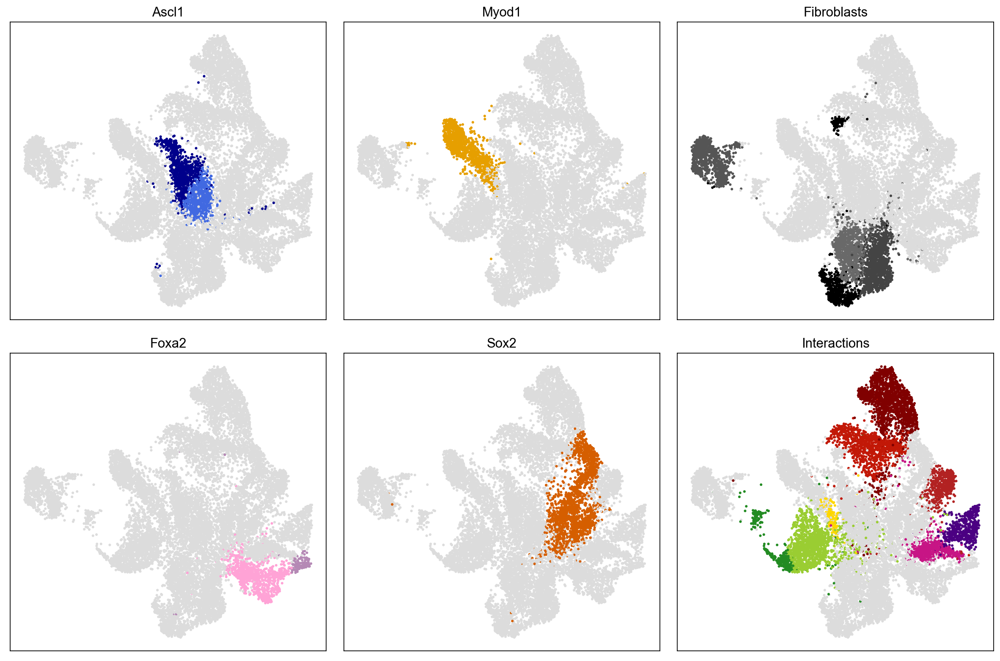

In [63]:
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(5*3, 5*2))
for i, (k, v) in enumerate({
    "Ascl1": ["ascl1_fate_1", "ascl1_fate_2"],
    "Myod1": ["myod1_fate_1"],
    "Fibroblasts": ["fibroblast_1", "fibroblast_2", "fibroblast_3", "fibroblast_4"],
    "Foxa2": ["foxa2_fate_1", "foxa2_fate_2"],
    "Sox2": ["sox2_fate_1", "sox2_fate_2"],
    "Interactions": ["ascl1_myod1_fate_1", "ascl1_myod1_fate_2", "ascl1_myod1_fate_3",
                     "ascl1_sox2_fate_1", "myod1_sox2_fate_1", "sox2_oct4_fate_1",
                     "foxa2_myod1_fate_1", "ascl1_foxa2_fate_1"],
}.items()):
    temp = adata_proc.copy()
    sc.pl.umap(
        temp, color='louvain_named', size = 30,
        palette=[
            y if x in v else 'gainsboro'
            for x, y in zip(
                adata_proc.obs["louvain_named"].values.categories,
                adata_proc.uns["louvain_named_colors"]
            )
        ], ax=axs[i // 3, i % 3], show=False
    )
    axs[i // 3, i % 3].legend_.remove()
    axs[i // 3, i % 3].set_title(k)
    axs[i // 3, i % 3].set_xlabel("")
    axs[i // 3, i % 3].set_ylabel("")
    del temp
plt.tight_layout()
plt.savefig(dir_out + f"2b2.pdf")
plt.show()

In [66]:
adata_proc.obs["louvain_lineage_coarse"].categories = \
    ['fibroblast_lq', 'fibroblast', 'ascl1_myod1', 'sox2', 'foxa2']

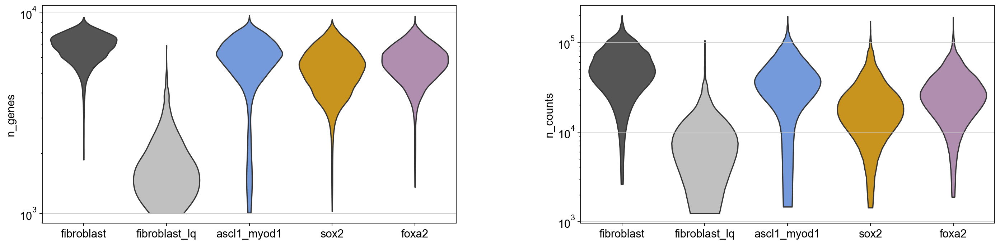

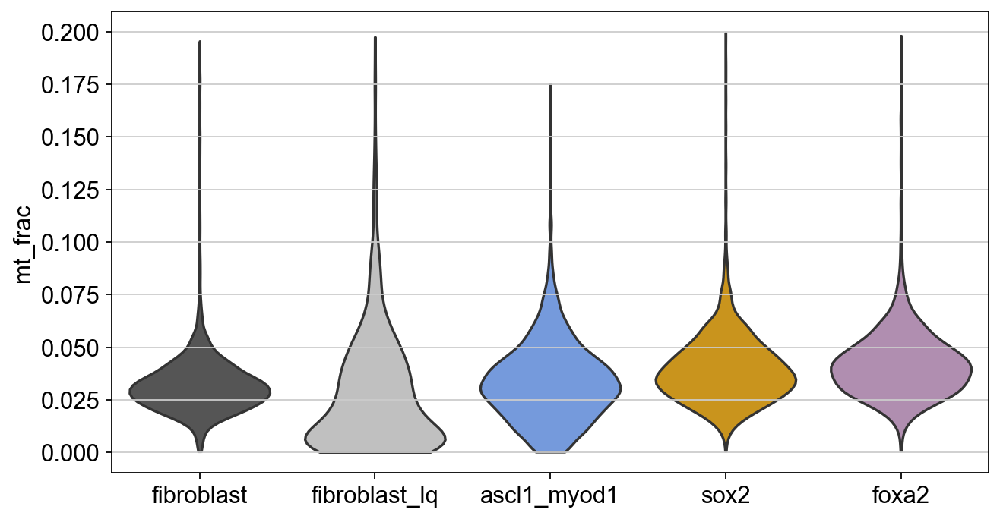

In [67]:
adata_proc.obs["louvain_lineage_coarse"]
rcParams['figure.figsize'] = (8,5)
sc.pl.violin(
    adata_proc, 
    keys = ['n_genes','n_counts'], 
    groupby='louvain_lineage_coarse', 
    rotation = 0, 
    stripplot=False, 
    palette = ['#555555', 'silver','cornflowerblue','#E69F00', "#B589B5", '#D55E00'],
    #['tomato', 'purple','green','teal','#CC79A7'],
    log = True
)
rcParams['figure.figsize'] = (8,5)
sc.pl.violin(
    adata_proc, 
    keys = ['mt_frac'], 
    groupby='louvain_lineage_coarse', 
    rotation = 0, 
    stripplot=False, 
    palette = ['#555555', 'silver','cornflowerblue','#E69F00', "#B589B5", '#D55E00'],
    log = False,
)

# Demultiplexing experimental batches

In [68]:
processing_for_calls = "_log"

In [69]:
constructs_ordered_optim = [
    'AcGFP1', 
    'DsRed',
    'EBFP2', 
    'Ascl1',
    'Foxa2',
    'Myod1',
    'Oct4',
    'Sox2',
]

In [70]:
#creating the occuring combinations
bool_combs_real = []
# SP:
#                       GFP    DsRed  EBFP2  Ascl1  FoxA2  MyoD1  Oct4   Sox2 
bool_combs_real.append([True , False, False, True , False, False, False, False])
bool_combs_real.append([True , False, False, False, True , False, False, False])
bool_combs_real.append([True , False, False, False, False, True , False, False])
bool_combs_real.append([True , False, False, False, False, False, True , False])
bool_combs_real.append([True , False, False, False, False, False, False, True ])
# DP
bool_combs_real.append([True , True , False, True , False, False, False, True ])
bool_combs_real.append([False, True , True , True , False, True , False, False])
bool_combs_real.append([True , True , False, False, False, True , False, True ])
bool_combs_real.append([True , False, True , False, False, False, True , True ])
bool_combs_real.append([True , True , False, False, True , False, False, True ])
bool_combs_real.append([True , True , False, True , True , False, False, False])
bool_combs_real.append([True , True , False, False, True , True , False, False])
# TP
bool_combs_real.append([True , True , True , True , False, False, True , True ])
bool_combs_real.append([True , True , True , False, False, True , True , True ])
bool_combs_real.append([True , True , True , False, True , False, True , True ])
bool_combs_real.append([True , True , True , True , False, True , False, True ])
# Controls
bool_combs_real.append([True , True , True , False, False, False, False, False])

for x in bool_combs_real:
    print("including condition: " + str(np.asarray(constructs_ordered_optim)[x]))

print(f"total conditions {len(bool_combs_real)}")
#creating all possible combinations
import itertools 
l=[False,True]
all_combs = [list(x) for x in list(itertools.product(l,repeat=8))]

all_combs = bool_combs_real + all_combs

#removing the duplicates while keeping the order (first are the occuring ones)
bool_combs = []
for comb in all_combs:
    if comb not in bool_combs:
        bool_combs.append(comb)

including condition: ['AcGFP1' 'Ascl1']
including condition: ['AcGFP1' 'Foxa2']
including condition: ['AcGFP1' 'Myod1']
including condition: ['AcGFP1' 'Oct4']
including condition: ['AcGFP1' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'Ascl1' 'Sox2']
including condition: ['DsRed' 'EBFP2' 'Ascl1' 'Myod1']
including condition: ['AcGFP1' 'DsRed' 'Myod1' 'Sox2']
including condition: ['AcGFP1' 'EBFP2' 'Oct4' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'Foxa2' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'Ascl1' 'Foxa2']
including condition: ['AcGFP1' 'DsRed' 'Foxa2' 'Myod1']
including condition: ['AcGFP1' 'DsRed' 'EBFP2' 'Ascl1' 'Oct4' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'EBFP2' 'Myod1' 'Oct4' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'EBFP2' 'Foxa2' 'Oct4' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'EBFP2' 'Ascl1' 'Myod1' 'Sox2']
including condition: ['AcGFP1' 'DsRed' 'EBFP2']
total conditions 17


## Threshold from gaussian mixture models

Here we fit a 1D GMM with two components to the log_counts for each construct in each batch. We assign the cells belonging to the resulting high-count mixture component as postitive and the ones belonging to the low-count mixture component as negative. Then we visualize the results.

In [71]:
from sklearn.mixture import GaussianMixture

models = []
for i, construct in enumerate(constructs + constructs_color):
    adata_filtered.obs[construct + '_positive_gmm'] = False
for j, x in enumerate(np.unique(adata_filtered.obs["batch"].values)):
    adata_temp = adata_filtered[adata_filtered.obs["batch"].values == x, :]
    models.append([])
    for i, construct in enumerate(constructs + constructs_color):
        X = adata_temp.obs[construct + processing_for_calls].values.reshape(-1,1)

        models[j].append(GaussianMixture(n_components = 2, random_state = 0).fit(X))
        #here we assign the positive labels to the data points corresponding to the high count mixture
        labels = models[j][i].predict(X)
        high_count_mixture = np.argmax(models[j][i].means_)
        assignments = np.asarray(adata_filtered.obs[construct + '_positive_gmm'].values)
        assignments[np.array([x in adata_temp.obs_names for x in adata_filtered.obs_names])] = \
            (labels == high_count_mixture)
        adata_filtered.obs[construct + '_positive_gmm'] = assignments

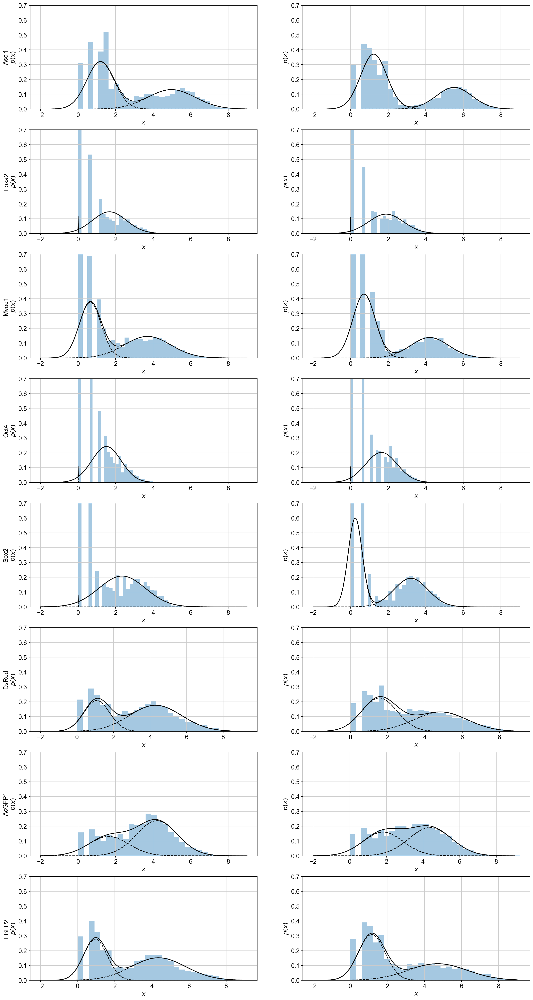

In [72]:
import scipy.stats as stats

fig, axs = plt.subplots(ncols=2, nrows=8, figsize=(20, 40))
for i, b in enumerate(np.unique(adata_filtered.obs["batch"].values)):
    adata_temp = adata_filtered[adata_filtered.obs["batch"].values == b, :].copy()
    for j, construct in enumerate(constructs + constructs_color):
        X = adata_temp.obs[construct + processing_for_calls].values.reshape(-1,1)
        model = models[i][j]

        x = np.linspace(-2, 9, 1000)
        logprob = model.score_samples(x.reshape(-1, 1)) #compute the log probabilities for each sample.
        pdf = np.exp(logprob) #computes y values for the pdf
        
        axs[j, i].plot(x, model.weights_[0]*stats.norm.pdf(x, model.means_[0], np.sqrt(model.covariances_[0])).reshape(-1), '--k')
        axs[j, i].plot(x, model.weights_[1]*stats.norm.pdf(x, model.means_[1], np.sqrt(model.covariances_[1])).reshape(-1), '--k')

        axs[j, i].hist(X, 30, density=True, histtype='stepfilled', alpha=0.4)
        axs[j, i].plot(x, pdf, '-k')
        if i == 0:
            axs[j, i].set_ylabel('%s\n$p(x)$' % construct)
        else:
            axs[j, i].set_ylabel('$p(x)$')
        axs[j, i].set_xlabel('$x$')
        axs[j, i].set_ylim(0, 0.7)

Adjust assigments by manually set thresholds:

In [73]:
man_thresholds = {
    'MUC29498': dict([(x,  None) for x in constructs_ordered_optim]),
    'MUC29499': dict([(x,  None) for x in constructs_ordered_optim]),
}
for j, x in enumerate(np.unique(adata_filtered.obs["batch"].values)):
    for i, construct in enumerate(constructs+constructs_color):
        if man_thresholds[x][construct] is not None:
            adata_filtered.obs.loc[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[construct + processing_for_calls].values >= man_thresholds[x][construct]
            ), construct + '_positive_gmm'] = True
            adata_filtered.obs.loc[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[construct + processing_for_calls].values < man_thresholds[x][construct]
            ), construct + '_positive_gmm'] = False

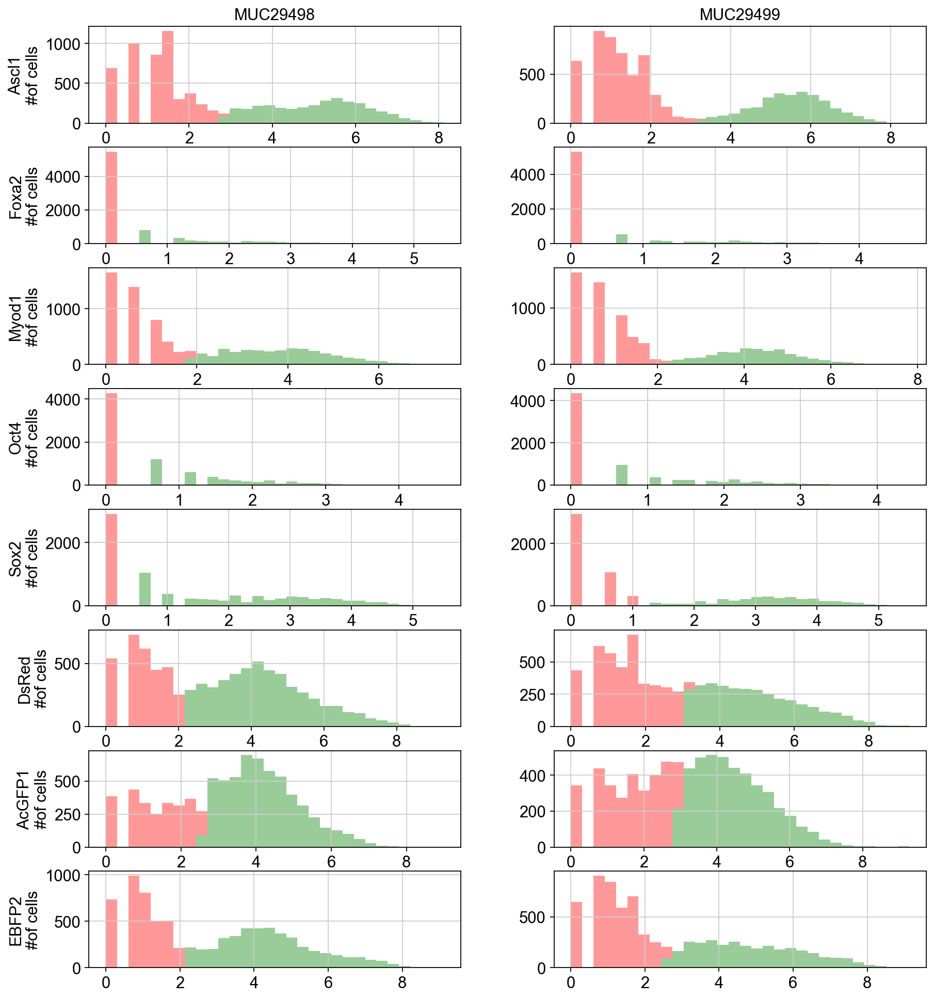

In [74]:
fig, axs = plt.subplots(ncols=2, nrows=8, figsize=(13, 15))
for i, x in enumerate(np.unique(adata_filtered.obs["batch"].values)):
    adata_temp = adata_filtered[adata_filtered.obs["batch"].values == x, :].copy()
    for j, construct in enumerate(constructs + constructs_color):
        X = adata_temp.obs[construct + processing_for_calls].values.reshape(-1,1)
        model = models[i][j]

        axs[j, i].hist(
            [X[adata_temp.obs[construct + '_positive_gmm'].values, 0], 
             X[adata_temp.obs[construct + '_positive_gmm'].values==False, 0]
            ], stacked = True, bins = 30, color = ['green','red'], alpha = 0.4
        )
        if i == 0:
            axs[j, i].set_ylabel(construct + '\n#of cells')
        else:
            axs[j, i].set_ylabel('')
        if j == 0:
            axs[j, i].set_title(x)
        if j == 6:
            axs[j, i].set_xlabel('log normalized counts')
        else:
            axs[j, i].set_xlabel('')
plt.subplots_adjust(wspace=0.25, hspace=0.25)
plt.show()

### Assign cells to conditions based on likelihood under each centroid

Using a gaussian noise model with estimate of standard deviation of each transgene in each batch.

In [75]:
group_ids = np.array([False, True])
batch_ids = np.unique(adata_filtered.obs["batch"].values)
batch_assignments = np.array([batch_ids.tolist().index(x) for x in adata_filtered.obs["batch"].values])
mean_batch_gene_group = np.array([
    [
        [
            adata_filtered[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[y + "_positive_gmm"].values == z,
            ), :].obs[y + processing_for_calls].values.mean(axis=0) 
            for z in group_ids
        ]
        for y in constructs_ordered_optim
    ]
    for x in batch_ids
])
sd_batch_gene_group = np.maximum(np.array([
    [
        [
            adata_filtered[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[y + "_positive_gmm"].values == z,
            ), :].obs[y + processing_for_calls].values.std(axis=0) 
            for z in group_ids
        ]
        for y in constructs_ordered_optim
    ]
    for x in batch_ids
]), 1e-5)
ll_cell_gene_group = \
    -0.5*np.log(2*np.pi*np.square(sd_batch_gene_group[batch_assignments, :, :])) - \
    0.5 * np.square(
        np.expand_dims(adata_filtered.obs[[y + processing_for_calls for y in constructs_ordered_optim]].values, axis=-1) - \
        mean_batch_gene_group[batch_assignments, :, :]
    ) / np.square(sd_batch_gene_group[batch_assignments, :, :])
ll_cell_condition = np.array([
    np.sum(ll_cell_gene_group[:, np.arange(len(x)), np.expand_dims(x, axis=0)], axis=-1).flatten()
    for x in np.array(bool_combs_real).astype(int)
]).T
del group_ids
del batch_ids
del batch_assignments

categories_real = []
category_assignments_real = ["x) mismatch" for i in range(adata_filtered.shape[0])]
class_assignments = np.argmax(ll_cell_condition, axis=1)
for i, comb in enumerate(bool_combs_real):
    if i == 16:
        category = "17) empty"
    else:
        category = str(i+1) + ') ' + ', '.join([x for j, x in enumerate(constructs_ordered_optim) if comb[j]
                                              if x not in constructs_color])
    categories_real.append(category)
        
adata_filtered.obs['inferred_category_real_gmm'] = [categories_real[i] for i in class_assignments]
del mean_batch_gene_group
del sd_batch_gene_group
del ll_cell_gene_group
del ll_cell_condition
adata_filtered.obs['inferred_category_real_gmm']

AAACCCACAAGTGTCT-1-MUC29498          12) Foxa2, Myod1
AAACCCAGTCATCCGG-1-MUC29498     15) Foxa2, Oct4, Sox2
AAACCCAGTCCAGCCA-1-MUC29498          12) Foxa2, Myod1
AAACCCATCAACCTTT-1-MUC29498     14) Myod1, Oct4, Sox2
AAACCCATCCATTGGA-1-MUC29498    16) Ascl1, Myod1, Sox2
                                        ...          
TTTGTTGGTGTTTCTT-1-MUC29499     13) Ascl1, Oct4, Sox2
TTTGTTGTCCGGTAGC-1-MUC29499                  1) Ascl1
TTTGTTGTCGACGCTG-1-MUC29499            6) Ascl1, Sox2
TTTGTTGTCTATGTGG-1-MUC29499                  3) Myod1
TTTGTTGTCTCCGCAT-1-MUC29499     14) Myod1, Oct4, Sox2
Name: inferred_category_real_gmm, Length: 15768, dtype: object

## Thresholds from fraction-based optimization

### Initialize group assignments via fraction-based optimization

#### Initialise group membership with target population structure-based optimisation approach

In [76]:
def objective_function(
    optimised_thresholds,
    optimised_thresholds_idx,
    fixed_thresholds,
    fixed_thresholds_idx,
    expression_matrix,
    desired,
    bool_combs,
):
    """
    """
    n_transgenes = 8
    #compute the positivity/negativity assignment for all cells for all constructs
    all_thresholds = np.zeros((n_transgenes,))
    if len(fixed_thresholds_idx) > 0:
        all_thresholds[fixed_thresholds_idx] = fixed_thresholds
    all_thresholds[optimised_thresholds_idx] = optimised_thresholds
    bool_matrix = expression_matrix > all_thresholds
    
    #compute the number of cells assigned to each of the 2^n_transgenes categories (or less if not all present)
    uniqueValues, occurCount = np.unique(bool_matrix, axis = 0, return_counts = True)
    uniqueValues = list(uniqueValues)
    uniqueValues = [list(x) for x in uniqueValues]
   
    #get the assignments into a vector ordered by our combinations
    true_counts = np.zeros(2**n_transgenes)
    for i, comb in enumerate(bool_combs):
        for j, uniq in enumerate(uniqueValues):
            if comb == uniq:
                true_counts[i] = occurCount[j]
    
    #define the vector of expected counts per category
    desired_counts = np.concatenate((
        np.repeat(desired[0]*expression_matrix.shape[0], 15), 
        np.array([desired[1]*expression_matrix.shape[0]]), 
        np.array([desired[2]*expression_matrix.shape[0]]), 
        np.zeros(2**n_transgenes - 17)
    ))
    loss = (np.abs(true_counts - desired_counts)).mean()
    return loss

Here we try to find the global minimum of our objective function using the differential evolution algorithm.

In [77]:
fixed_thresholds_from_gmm = []
desired = (7/115, 4.5/115, 5.5/115)
n_transgenes = 8
if bool_recomp:
    from scipy.optimize import differential_evolution
    for i, construct in enumerate(constructs_ordered_optim):
        adata_filtered.obs[construct + '_positive_optim'] = False
    for batch in np.unique(adata_filtered.obs["batch"].values):
        idx = np.where(adata_filtered.obs["batch"].values == batch)[0]
        construct_expression_matrix_batch = np.zeros((adata_filtered[idx].shape[0], n_transgenes))
        for i, construct in enumerate(constructs_ordered_optim):
            construct_expression_matrix_batch[:,i] = adata_filtered[idx].obs[construct + processing_for_calls]
        thresholds_fixed = np.array([
            np.min(adata_filtered[np.logical_and(
                adata_filtered.obs[x + "_positive_gmm"].values == True,
                adata_filtered.obs["batch"].values == batch
            )].obs[x + processing_for_calls].values) 
            for x in constructs_ordered_optim
            if x in fixed_thresholds_from_gmm
        ])
        thresholds_optim_idx = np.array([i for i, x in enumerate(constructs_ordered_optim) if x not in fixed_thresholds_from_gmm])
        thresholds_fixed_idx = np.array([i for i, x in enumerate(constructs_ordered_optim) if x in fixed_thresholds_from_gmm])
        res = differential_evolution(
            func=objective_function, 
            args=(
                thresholds_optim_idx,
                thresholds_fixed,
                thresholds_fixed_idx,
                construct_expression_matrix_batch, 
                desired, 
                bool_combs
            ),
            bounds=tuple([(0,8) for i in range(n_transgenes - len(fixed_thresholds_from_gmm))])
        )
        print(res)
        thresholds = np.zeros((n_transgenes,))
        thresholds[thresholds_optim_idx] = res.x
        if len(thresholds_fixed_idx) > 0:
            thresholds[thresholds_fixed_idx] = thresholds_fixed
        for i, construct in enumerate(constructs_ordered_optim):
            constructs_positive_optim = adata_filtered.obs[construct + '_positive_optim']
            constructs_positive_optim.iloc[idx] = adata_filtered[idx].obs[construct + processing_for_calls] > thresholds[i]
            adata_filtered.obs[construct + '_positive_optim'] = constructs_positive_optim

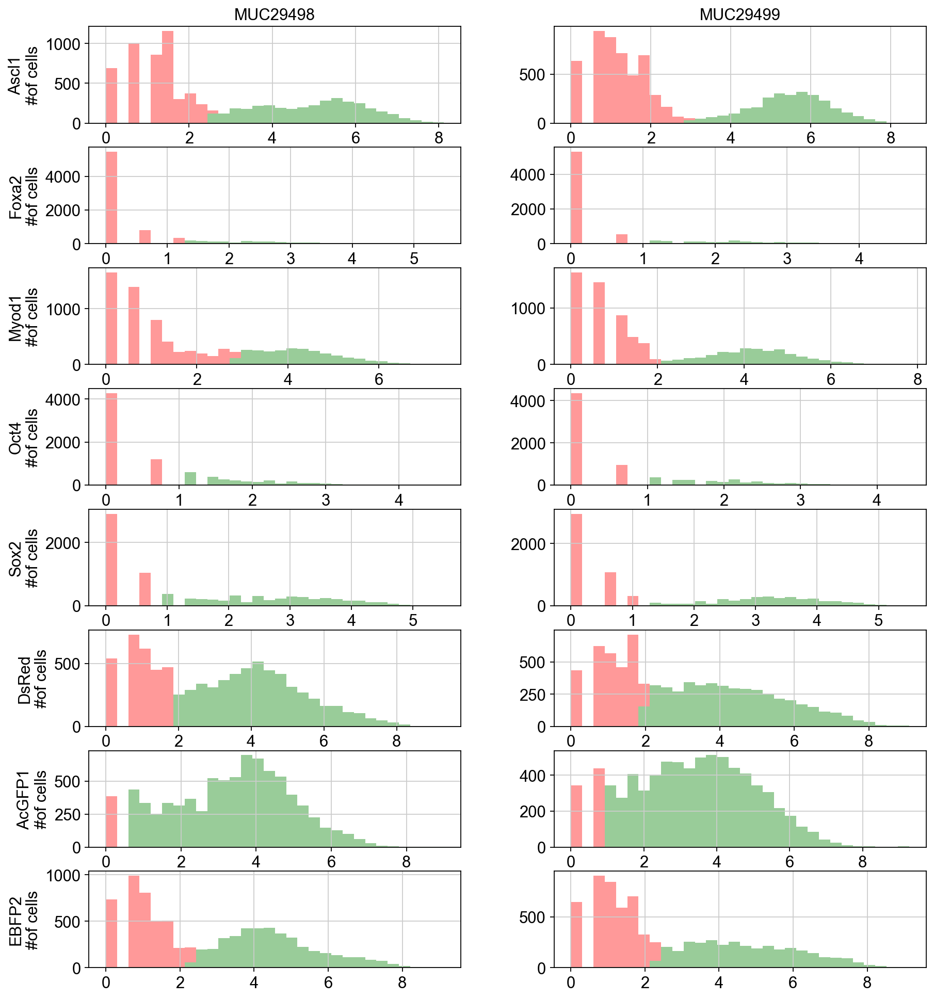

In [78]:
### ploting the mixture 'memberships'
fig, axs = plt.subplots(ncols=2, nrows=8, figsize=(13, 15))
for i, x in enumerate(np.unique(adata_filtered.obs["batch"].values)):
    adata_temp = adata_filtered[adata_filtered.obs["batch"].values == x, :].copy()
    for j, construct in enumerate(constructs + constructs_color):
        X = adata_temp.obs[construct + processing_for_calls].values.reshape(-1,1)
        model = models[i][j]

        axs[j, i].hist(
            [X[adata_temp.obs[construct + '_positive_optim'].values.astype(bool), 0], 
             X[adata_temp.obs[construct + '_positive_optim'].values.astype(bool) == False, 0]
            ], stacked = True, bins = 30, color = ['green','red'], alpha = 0.4
        )
        if i == 0:
            axs[j, i].set_ylabel(construct + '\n#of cells')
        else:
            axs[j, i].set_ylabel('')
        if j == 0:
            axs[j, i].set_title(x)
        if j == 6:
            axs[j, i].set_xlabel(f"{processing_for_calls} counts")
        else:
            axs[j, i].set_xlabel('')
plt.subplots_adjust(wspace=0.25, hspace=0.25)
plt.savefig(dir_out + "SI1a.pdf")
plt.show()

### Assign cells to conditions based on likelihood under each centroid

Using a gaussian noise model with estimate of standard deviation of each transgene in each batch.

In [79]:
group_ids = np.array([False, True])
batch_ids = np.unique(adata_filtered.obs["batch"].values)
batch_assignments = np.array([batch_ids.tolist().index(x) for x in adata_filtered.obs["batch"].values])
mean_batch_gene_group = np.array([
    [
        [
            adata_filtered[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[y + "_positive_optim"].values == z,
            ), :].obs[y + processing_for_calls].values.mean(axis=0) 
            for z in group_ids
        ]
        for y in constructs_ordered_optim
    ]
    for x in batch_ids
])
sd_batch_gene_group = np.maximum(np.array([
    [
        [
            adata_filtered[np.logical_and(
                adata_filtered.obs["batch"].values == x,
                adata_filtered.obs[y + "_positive_optim"].values == z,
            ), :].obs[y + processing_for_calls].values.std(axis=0) 
            for z in group_ids
        ]
        for y in constructs_ordered_optim
    ]
    for x in batch_ids
]), 1e-5)
ll_cell_gene_group = \
    -0.5*np.log(2*np.pi*np.square(sd_batch_gene_group[batch_assignments, :, :])) - \
    0.5 * np.square(
        np.expand_dims(adata_filtered.obs[[y + processing_for_calls for y in constructs_ordered_optim]].values, axis=-1) - \
        mean_batch_gene_group[batch_assignments, :, :]
    ) / np.square(sd_batch_gene_group[batch_assignments, :, :])
ll_cell_condition = np.array([
    np.sum(ll_cell_gene_group[:, np.arange(len(x)), np.expand_dims(x, axis=0)], axis=-1).flatten()
    for x in np.array(bool_combs_real).astype(int)
]).T
del group_ids
del batch_ids
del batch_assignments

categories_real = []
category_assignments_real = ["x) mismatch" for i in range(adata_filtered.shape[0])]
class_assignments = np.argmax(ll_cell_condition, axis=1)
for i, comb in enumerate(bool_combs_real):
    if i == 16:
        category = "17) empty"
    else:
        category = str(i+1) + ') ' + ', '.join([x for j, x in enumerate(constructs_ordered_optim) if comb[j]
                                              if x not in constructs_color])
    categories_real.append(category)
        
adata_filtered.obs['inferred_category_real_optim'] = [categories_real[i] for i in class_assignments]
del mean_batch_gene_group
del sd_batch_gene_group
del ll_cell_gene_group
del ll_cell_condition
adata_filtered.obs['inferred_category_real_optim']

AAACCCACAAGTGTCT-1-MUC29498          11) Ascl1, Foxa2
AAACCCAGTCATCCGG-1-MUC29498     13) Ascl1, Oct4, Sox2
AAACCCAGTCCAGCCA-1-MUC29498          12) Foxa2, Myod1
AAACCCATCAACCTTT-1-MUC29498                  3) Myod1
AAACCCATCCATTGGA-1-MUC29498    16) Ascl1, Myod1, Sox2
                                        ...          
TTTGTTGGTGTTTCTT-1-MUC29499     13) Ascl1, Oct4, Sox2
TTTGTTGTCCGGTAGC-1-MUC29499                  1) Ascl1
TTTGTTGTCGACGCTG-1-MUC29499            6) Ascl1, Sox2
TTTGTTGTCTATGTGG-1-MUC29499                  3) Myod1
TTTGTTGTCTCCGCAT-1-MUC29499     14) Myod1, Oct4, Sox2
Name: inferred_category_real_optim, Length: 15768, dtype: object

## Comparison of both sets of thresholds

We compare class frequencies of the posterior assignments here:

gmm


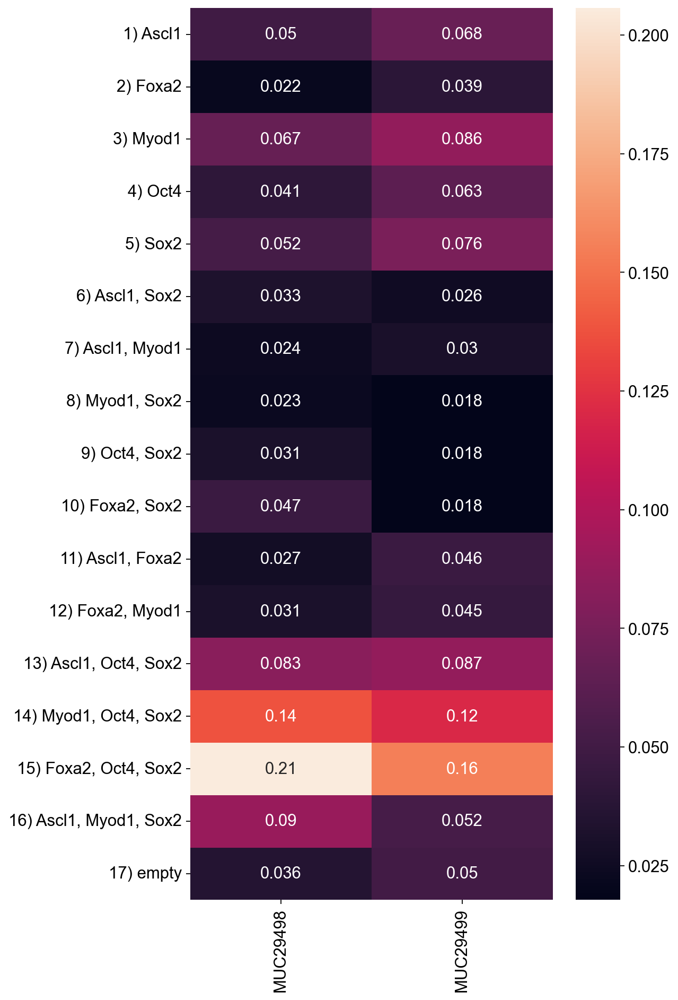

optim


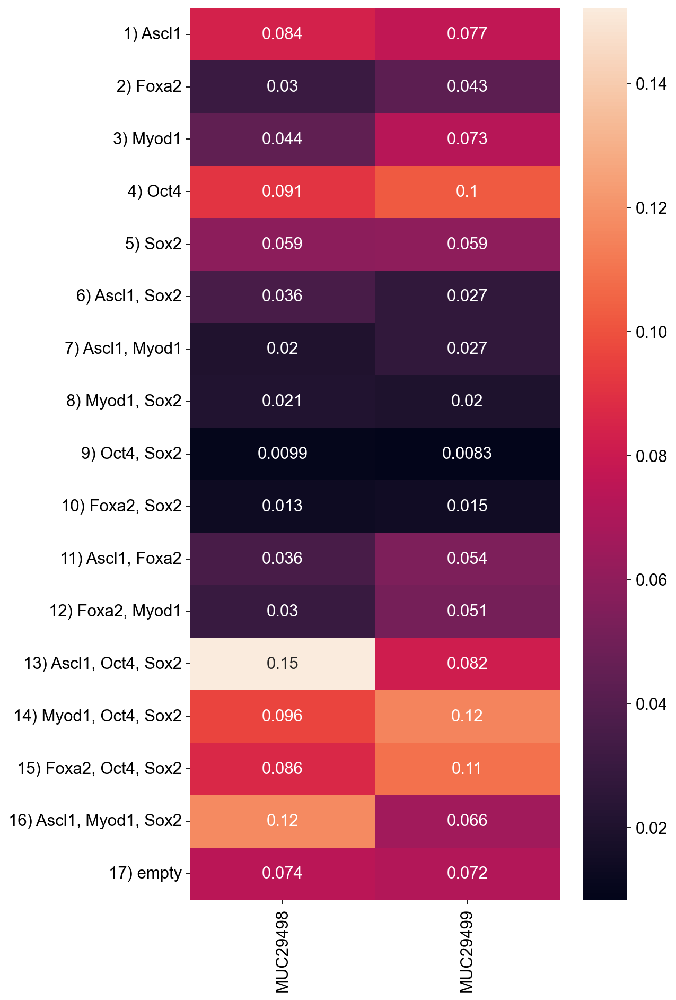

gmm
optim


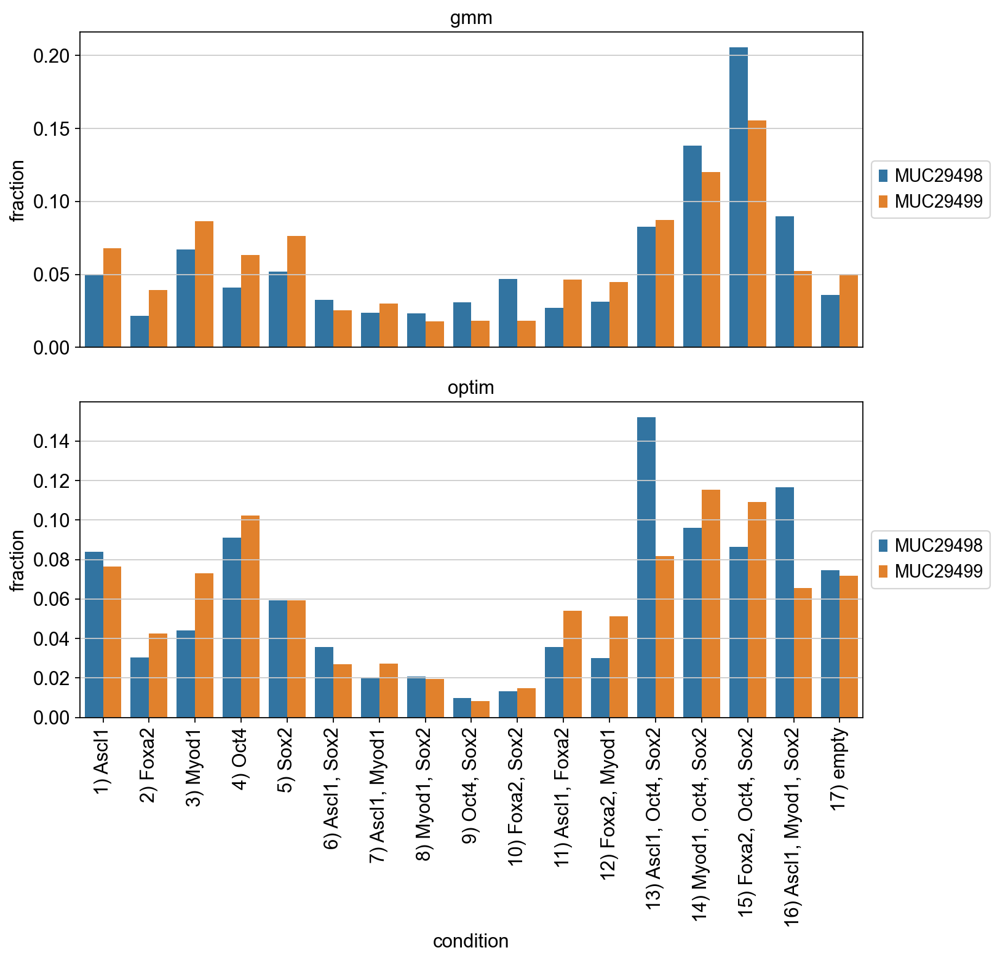

In [80]:
summary_tabs = {}
for method_id in ["gmm", "optim"]:
    summary_tabs[method_id] = (
        adata_filtered.obs.groupby(["batch", "inferred_category_real_" + method_id]).size() / 
        adata_filtered.obs.groupby(["batch"]).size()
    ).reset_index()
    summary_tabs[method_id] = summary_tabs[method_id].pivot(
        index="inferred_category_real_" + method_id, 
        columns="batch"
    )[0].copy()
    # Sort rows
    summary_tabs[method_id] = summary_tabs[method_id].iloc[
        np.argsort([int(str(x).split(")")[0]) for x in summary_tabs[method_id].index])
    ]
    # Remove transgene string from index
    summary_tabs[method_id].index = ["".join(x.split("_transgene")) for x in summary_tabs[method_id].index]
    summary_tabs[method_id] = pd.DataFrame(  # revert pivot format
        summary_tabs[method_id].values,
        index=summary_tabs[method_id].index.values,
        columns=summary_tabs[method_id].columns.values.tolist()
    )
    summary_tabs[method_id]["condition"] = summary_tabs[method_id].index.values
# plot heatmaps
for k, v in summary_tabs.items():
    print(k)
    fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(8, 12))
    sb.heatmap(
        v.loc[:, v.columns != "condition"],
        annot=True,
        xticklabels=1, 
        yticklabels=1,
        ax=ax
    )
    ax.xaxis.set_tick_params(rotation=90)
    plt.tight_layout()
    plt.show()
# plot barplots
fig, axs = plt.subplots(ncols=1, nrows=2, figsize=(10, 10))
for i, (k, v) in enumerate(summary_tabs.items()):
    print(k)
    v = v.melt(id_vars=["condition"], value_name="fraction", var_name="batch")
    sb.barplot(
        data=v,
        x="condition",
        y="fraction",
        hue="batch",
        ax=axs[i]
    )
    box = axs[i].get_position()
    axs[i].set_title(k)
    axs[i].set_position([box.x0, box.y0, box.width * 0.95, box.height])
    axs[i].legend(loc='center left', bbox_to_anchor=(1, 0.5))
    axs[i].xaxis.set_tick_params(rotation=90)
    if i == 0:
        axs[i].set_xticks([])
        axs[i].set_xlabel("")
plt.tight_layout()
plt.show()

In [81]:
for x in constructs + constructs_color:
    adata_proc.obs[x+"_positive_gmm"] = adata_filtered[adata_proc.obs_names, :].obs[x+"_positive_gmm"].values
    adata_proc.obs[x+"_positive_optim"] = adata_filtered[adata_proc.obs_names, :].obs[x+"_positive_optim"].values
    
    adata_proc_corrected.obs[x+"_positive_gmm"] = adata_filtered[adata_proc_corrected.obs_names, :].obs[x+"_positive_gmm"].values
    adata_proc_corrected.obs[x+"_positive_optim"] = adata_filtered[adata_proc_corrected.obs_names, :].obs[x+"_positive_optim"].values
    
    adata_filtered_velo.obs[x+"_positive_gmm"] = adata_filtered[adata_filtered_velo.obs_names, :].obs[x+"_positive_gmm"].values
    adata_filtered_velo.obs[x+"_positive_optim"] = adata_filtered[adata_filtered_velo.obs_names, :].obs[x+"_positive_optim"].values

adata_proc.obs["inferred_category_real_optim"] = adata_filtered[adata_proc.obs_names, :].obs["inferred_category_real_optim"].values
adata_proc.obs["inferred_category_real_gmm"] = adata_filtered[adata_proc.obs_names, :].obs["inferred_category_real_gmm"].values
adata_proc_corrected.obs["inferred_category_real_optim"] = adata_filtered[adata_proc_corrected.obs_names, :].obs["inferred_category_real_optim"].values
adata_proc_corrected.obs["inferred_category_real_gmm"] = adata_filtered[adata_proc_corrected.obs_names, :].obs["inferred_category_real_gmm"].values
adata_filtered_velo.obs["inferred_category_real_optim"] = adata_filtered[adata_filtered_velo.obs_names, :].obs["inferred_category_real_optim"].values
adata_filtered_velo.obs["inferred_category_real_gmm"] = adata_filtered[adata_filtered_velo.obs_names, :].obs["inferred_category_real_gmm"].values

... storing 'inferred_category_real_optim' as categorical
... storing 'inferred_category_real_gmm' as categorical


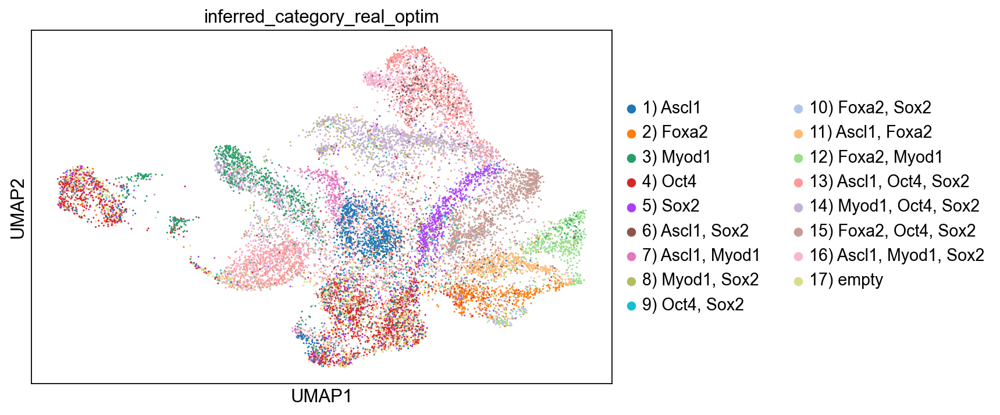

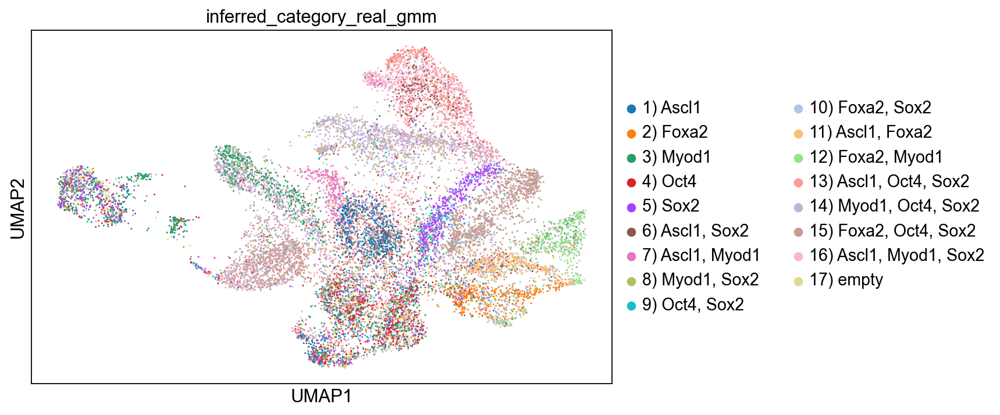

In [82]:
sc.pl.umap(adata_proc, color=["inferred_category_real_optim"])
sc.pl.umap(adata_proc, color=["inferred_category_real_gmm"])

## Assigning cells to categories and plotting the categories

### Assign experimental conditions

In [83]:
choice = "optim"

In [84]:
adata_proc.obs["inferred_category_real"] = adata_proc.obs["inferred_category_real_" + choice].values
adata_proc_corrected.obs["inferred_category_real"] = adata_proc_corrected.obs["inferred_category_real_" + choice].values
adata_filtered_velo.obs["inferred_category_real"] = adata_filtered_velo.obs["inferred_category_real_" + choice].values

#### Small

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize

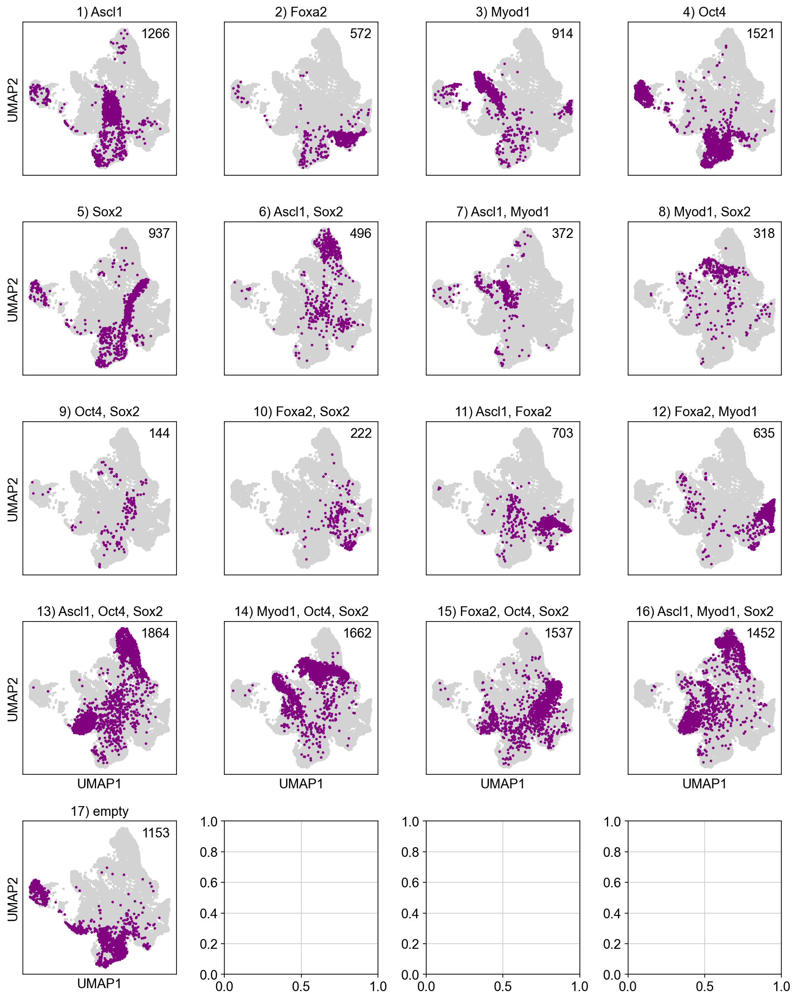

In [85]:
nrow = 5
ncol = 4
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, category in enumerate(categories_real):
    if (adata_proc.obs['inferred_category_real'].values == category).sum() != 0:
        num = (adata_proc.obs['inferred_category_real'].values ==  category).sum()
        sc.pl.umap(
            adata_proc, 
            color=['inferred_category_real'], 
            palette = ['purple' for x in range(17)], 
            groups = [category], 
            title = "".join("".join("".join(category.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")), 
            show=False, 
            ax=axs[i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i % 4 > 0:
            axs[i].set_ylabel("")
        if i // 4 < 3:
            axs[i].set_xlabel("")
        axs[i].legend_.remove()
        axs[i].text(0.96, 0.96, str(num),
            ha='right', va='top', transform= axs[i].transAxes)
    else:
        print(category)
plt.tight_layout()
plt.show()

Selected for Fig. 2:

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize

9) Oct4, Sox211) Ascl1, Foxa2


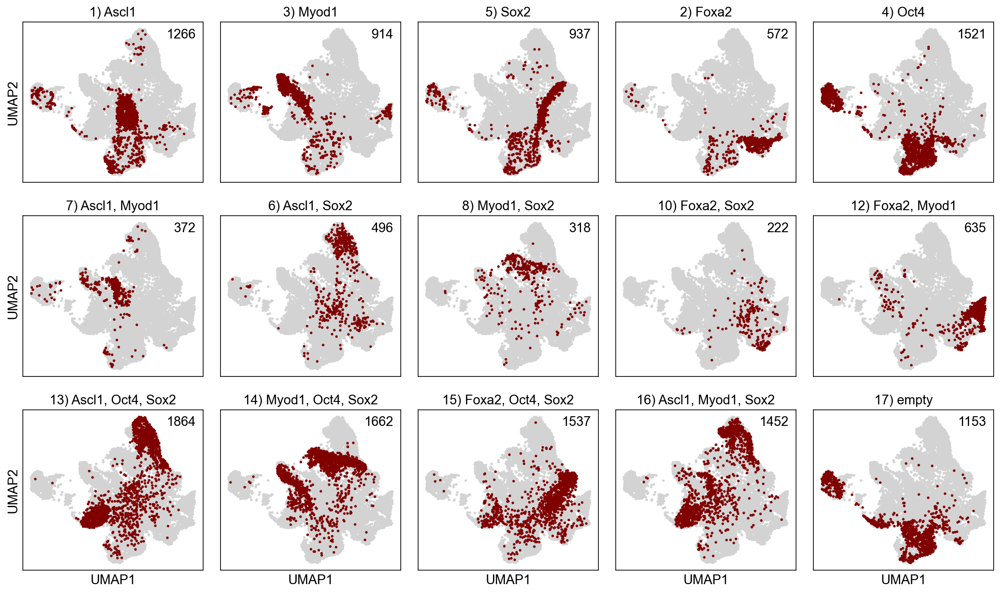

In [86]:
nrow = 3
ncol = 5
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, category in enumerate([
    '1) Ascl1', 
    '3) Myod1',
    '5) Sox2', 
    '2) Foxa2', 
    '4) Oct4',
    
    '7) Ascl1, Myod1',
    '6) Ascl1, Sox2',
    '8) Myod1, Sox2', 
    '10) Foxa2, Sox2',
    '12) Foxa2, Myod1',
    
    '13) Ascl1, Oct4, Sox2',
    '14) Myod1, Oct4, Sox2', 
    '15) Foxa2, Oct4, Sox2',
    '16) Ascl1, Myod1, Sox2', 
    '17) empty', 
    
     
    '9) Oct4, Sox2'
    '11) Ascl1, Foxa2',
    
]):
    if (adata_proc.obs['inferred_category_real'].values == category).sum() != 0:
        num = (adata_proc.obs['inferred_category_real'].values ==  category).sum()
        sc.pl.umap(
            adata_proc, 
            color=['inferred_category_real'], 
            palette = ['maroon' for x in range(17)], 
            groups = [category], 
            title = "".join("".join("".join(category.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")), 
            show=False, 
            ax=axs[i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i % 5 > 0:
            axs[i].set_ylabel("")
        if i // 5 < 2:
            axs[i].set_xlabel("")
        axs[i].legend_.remove()
        axs[i].text(0.96, 0.96, str(num),
            ha='right', va='top', transform= axs[i].transAxes)
    else:
        print(category)
plt.tight_layout()
plt.savefig(dir_out + "2a2.pdf")
plt.show()

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


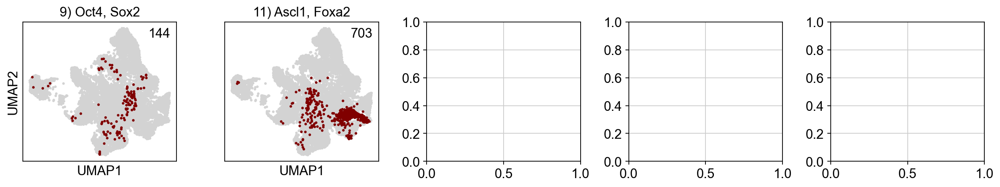

In [87]:
nrow = 1
ncol = 5
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, category in enumerate([
    '9) Oct4, Sox2',
    '11) Ascl1, Foxa2',
    
]):
    if (adata_proc.obs['inferred_category_real'].values == category).sum() != 0:
        num = (adata_proc.obs['inferred_category_real'].values ==  category).sum()
        sc.pl.umap(
            adata_proc, 
            color=['inferred_category_real'], 
            palette = ['maroon' for x in range(17)], 
            groups = [category], 
            title = "".join("".join("".join(category.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")), 
            show=False, 
            ax=axs[i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i % 5 > 0:
            axs[i].set_ylabel("")
        if i // 5 < 0:
            axs[i].set_xlabel("")
        axs[i].legend_.remove()
        axs[i].text(0.96, 0.96, str(num),
            ha='right', va='top', transform= axs[i].transAxes)
    else:
        print(category)
plt.tight_layout()
plt.show()

... storing 'group' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
... storing 'group' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
... storing 'group' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
... storing 'group' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


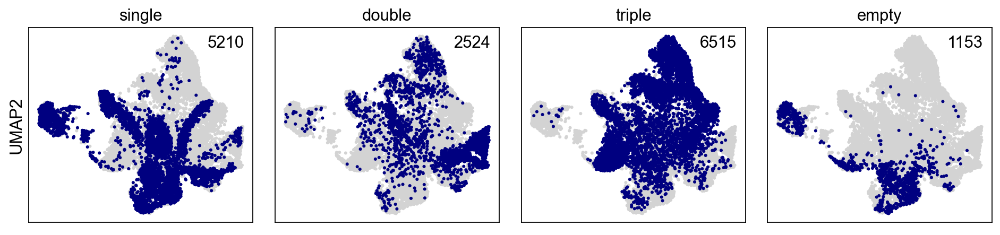

In [88]:
nrow = 1
ncol = 4
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, (k, categories) in enumerate({
    "single": [
        '1) Ascl1',
        '2) Foxa2',
        '3) Myod1', 
        '4) Oct4',
        '5) Sox2', 
    ],
    "double": [
        '6) Ascl1, Sox2',
        '7) Ascl1, Myod1',
        '8) Myod1, Sox2', 
        '9) Oct4, Sox2'
        '10) Foxa2, Sox2', 
        '11) Ascl1, Foxa2',
        '12) Foxa2, Myod1',
    ],
    "triple": [
        '13) Ascl1, Oct4, Sox2',
        '14) Myod1, Oct4, Sox2', 
        '15) Foxa2, Oct4, Sox2',
        '16) Ascl1, Myod1, Sox2',
    ],
    "empty": ['17) empty', ],
    
}.items()):
    num = np.sum([
        x in categories for x in adata_proc.obs['inferred_category_real'].values
    ])
    adata_temp = adata_proc.copy()
    adata_temp.obs["group"] = [
        ["else", "selected"][int(x in categories)]
        for x in adata_temp.obs['inferred_category_real'].values
    ]
    sc.pl.umap(
        adata_temp, 
        color=['group'], 
        palette = ['navy' for x in range(2)], 
        groups = ["selected"], 
        title=k,
        show=False, 
        ax=axs[i], 
        legend_fontsize = 0, 
        size = 30
    )
    if i % 4 > 0:
        axs[i].set_ylabel("")
    if i // 4 < 2:
        axs[i].set_xlabel("")
    axs[i].legend_.remove()
    axs[i].text(0.96, 0.96, str(num),
        ha='right', va='top', transform= axs[i].transAxes)
plt.tight_layout()
plt.savefig(dir_out + "2a1.pdf")
plt.show()

### Assign positive labels based on condition membership

In [89]:
for x in constructs:
    adata_proc.obs[x+"_positive_condition"] = \
        [x.lower() in xx.lower() for xx in adata_proc.obs['inferred_category_real'].values]
    adata_proc_corrected.obs[x+"_positive_condition"] = \
        [x.lower() in xx.lower() for xx in adata_proc_corrected.obs['inferred_category_real'].values]
    adata_filtered_velo.obs[x+"_positive_condition"] = \
        [x.lower() in xx.lower() for xx in adata_filtered_velo.obs['inferred_category_real'].values]

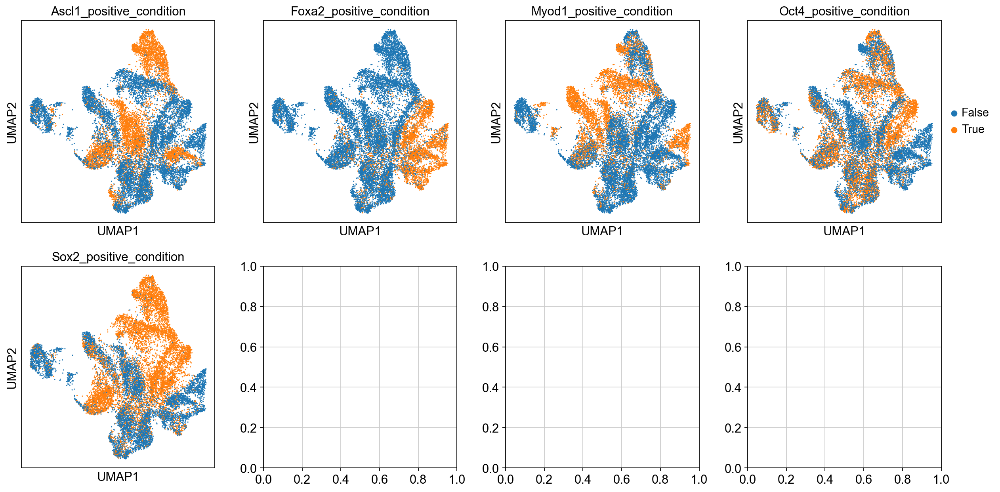

In [90]:
adata_proc_temp = adata_proc.copy()
for y in [x+"_positive_condition" for x in constructs]:
    adata_proc_temp.obs[y] = pd.Categorical(adata_proc_temp.obs[y].values)
    if y + "_color" in adata_proc_temp.uns.keys():
        del adata_proc_temp.uns[y + "_color"]
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(16, 8))
for i, y in enumerate([x+"_positive_condition" for x in constructs]):
    j = i % 4
    i = i // 4
    axs[i, j] = sc.pl.umap(adata_proc_temp, color=y, show=False, ax=axs[i, j])
    if j < 3:
        axs[i, j].legend_.remove()
plt.tight_layout()
plt.show()
del adata_proc_temp

### Final heatmaps

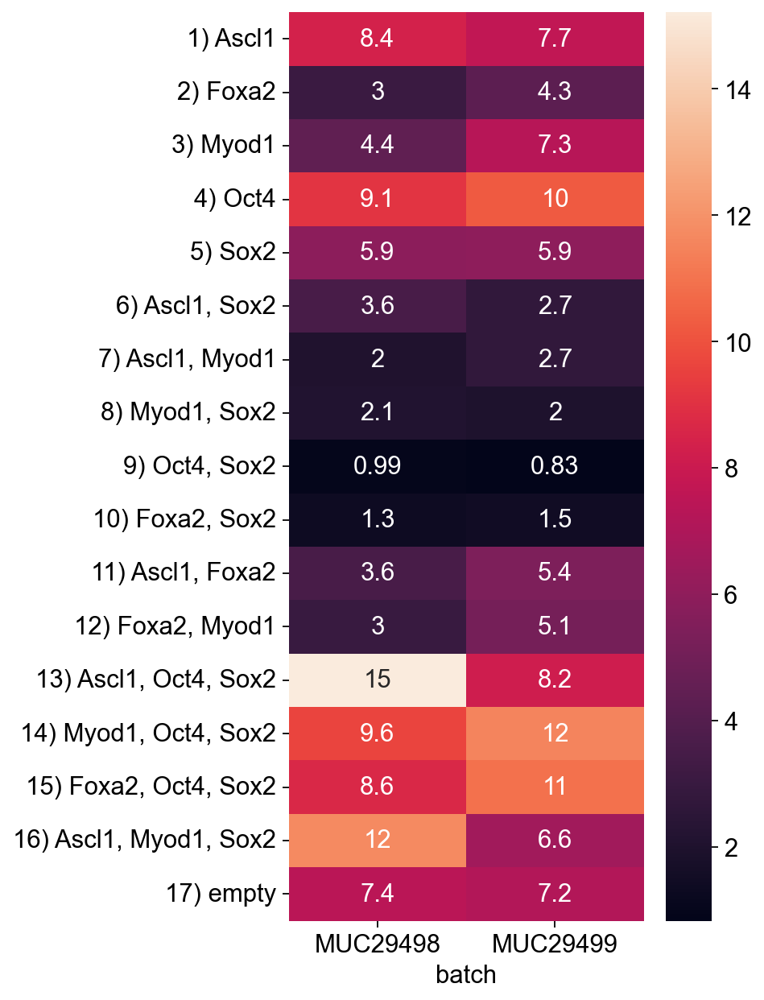

In [91]:
summary_tab = (
    adata_proc.obs.groupby(["batch", "inferred_category_real_" + choice]).size() / 
    adata_proc.obs.groupby(["batch"]).size()
).reset_index()
summary_tab = summary_tab.pivot(
    index="inferred_category_real_" + choice, 
    columns="batch"
)[0]
# Sort rows
summary_tab = summary_tab.iloc[
    np.argsort([int(str(x).split(")")[0]) for x in summary_tabs[choice].index])
]
# Remove colors from index
summary_tab.index = [
    "".join("".join("".join(x.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")) 
    for x in summary_tab.index
]
summary_tab = summary_tab*100

fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(6, 8))
sb.heatmap(
    summary_tab,
    annot=True,
    xticklabels=1, 
    yticklabels=1,
    ax=ax
)
plt.tight_layout()
plt.show()

Deviation of observed and expected frequency:

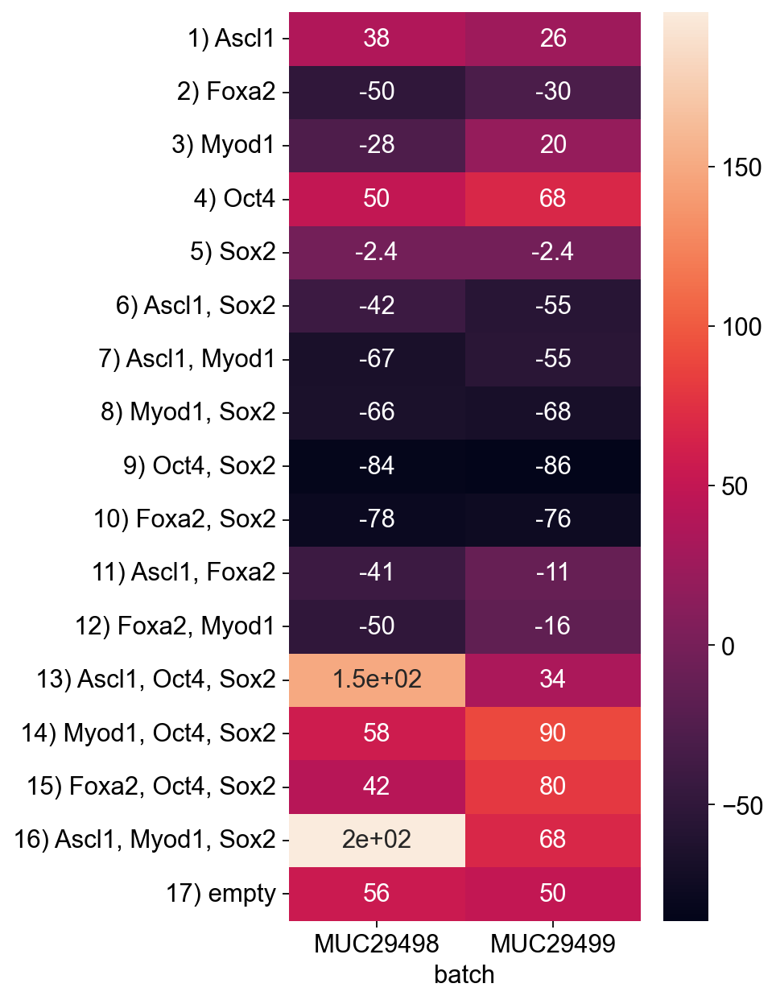

In [92]:
summary_tab = (
    adata_proc.obs.groupby(["batch", "inferred_category_real_" + choice]).size() / 
    adata_proc.obs.groupby(["batch"]).size()
).reset_index()
summary_tab = summary_tab.pivot(
    index="inferred_category_real_" + choice, 
    columns="batch"
)[0]
# Sort rows
summary_tab = summary_tab.iloc[
    np.argsort([int(str(x).split(")")[0]) for x in summary_tabs[choice].index])
]
# Remove colors from index
summary_tab.index = [
    "".join("".join("".join(x.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")) 
    for x in summary_tab.index
]
summary_tab = summary_tab
summary_tab.iloc[:15, :] = (summary_tab.iloc[:15, :] - desired[0]) / desired[0] * 100
summary_tab.iloc[15, :] = (summary_tab.iloc[15, :] - desired[1]) / desired[1] * 100
summary_tab.iloc[16, :] = (summary_tab.iloc[16, :] - desired[2]) / desired[2] * 100

fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(6, 8))
sb.heatmap(
    summary_tab,
    annot=True,
    xticklabels=1, 
    yticklabels=1,
    ax=ax
)
plt.tight_layout()
plt.show()

## Relate conditions to unsupervised analysis (louvain groups)

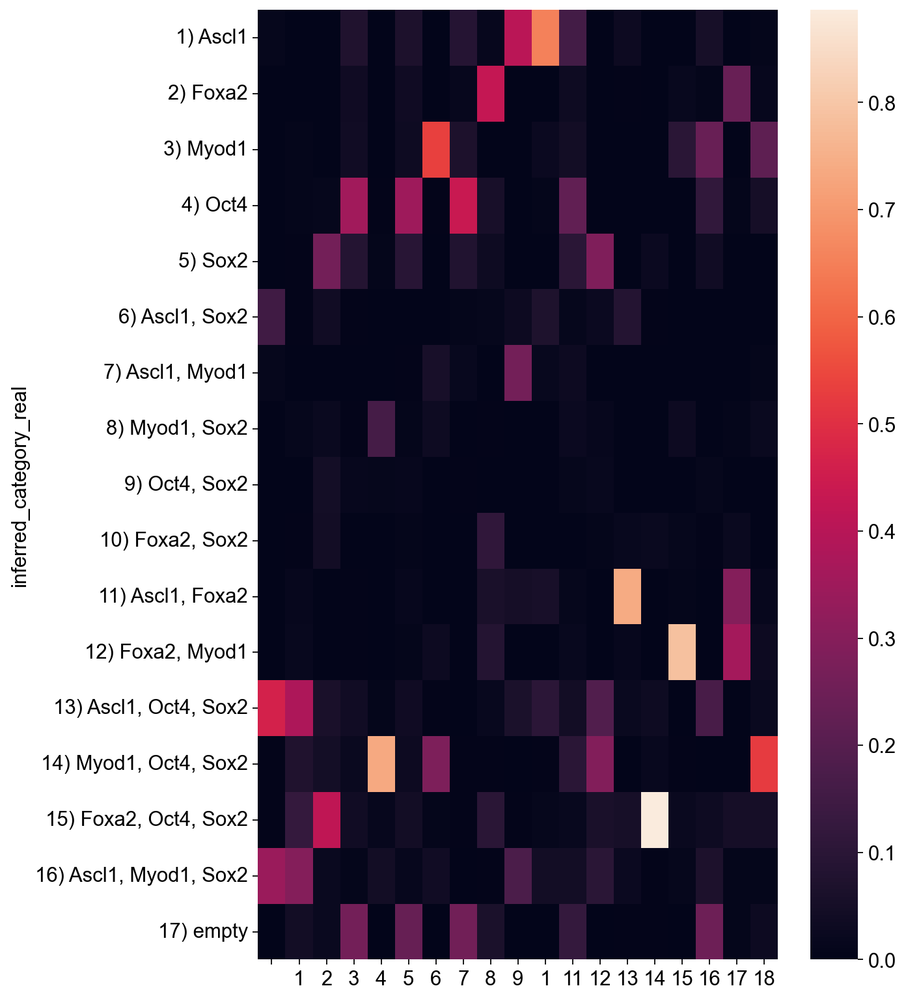

In [93]:
sns_data = (
    adata_proc.obs.groupby(["inferred_category_real", "louvain"]).size() / 
    adata_proc.obs.groupby(["louvain"]).size()
).reset_index()
sns_data = sns_data.pivot(
    index="inferred_category_real", 
    columns="louvain"
)[0]
sns_data.columns = [x.strip("0-") for x in sns_data.columns]
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(8, 12))
sb.heatmap(
    sns_data,
    annot=False,
    xticklabels=1, 
    yticklabels=1,
    ax=ax
)
plt.show()

## Show distribution of conditions across clusters

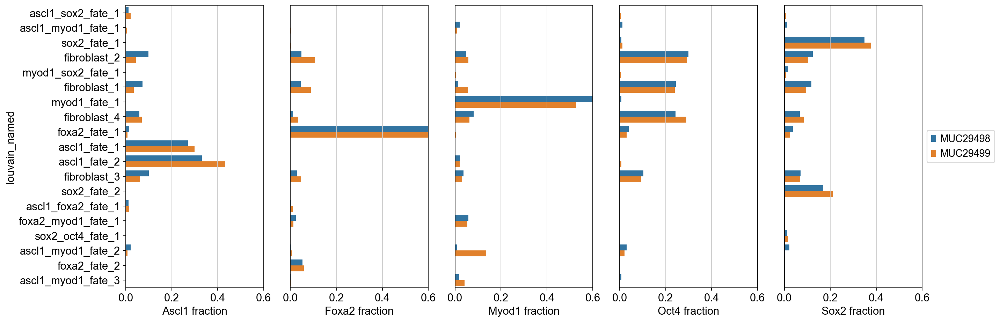

In [94]:
obs_temp = adata_proc[
    [int(x.split(")")[0]) < 6 for x in adata_proc.obs["inferred_category_real"].values]
].obs.copy()

fig, axs = plt.subplots(nrows=1, ncols=5, figsize=(18, 6))
for i, categ in enumerate([
    "1) Ascl1",
    "2) Foxa2",
    "3) Myod1",
    "4) Oct4",
    "5) Sox2",
]):
    counttable = (
        obs_temp.loc[obs_temp["inferred_category_real"].values == categ, :].\
        groupby(["louvain_named", "batch"]).size() /
        obs_temp.loc[obs_temp["inferred_category_real"].values == categ, :].\
        groupby(["batch"]).size()
    ).to_frame('count').reset_index()
    sb.barplot(
        data=counttable,
        y="louvain_named",
        x="count",
        hue="batch",
        ax=axs[i]
    )
    if i > 0:
        axs[i].set_ylabel("")
        axs[i].set_yticks([]) 
    if i == 4:
        box = axs[i].get_position()
        axs[i].set_position([box.x0, box.y0, box.width * 0.95, box.height])
        axs[i].legend(loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        axs[i].legend_.remove()
    axs[i].set_xlabel(categ.split(" ")[1] + " fraction")
    axs[i].set_xlim([0., 0.6])
plt.tight_layout()
plt.show()

## Construct distribution across conditions

### In single positive conditions

#### Unscaled - endo- + transgene

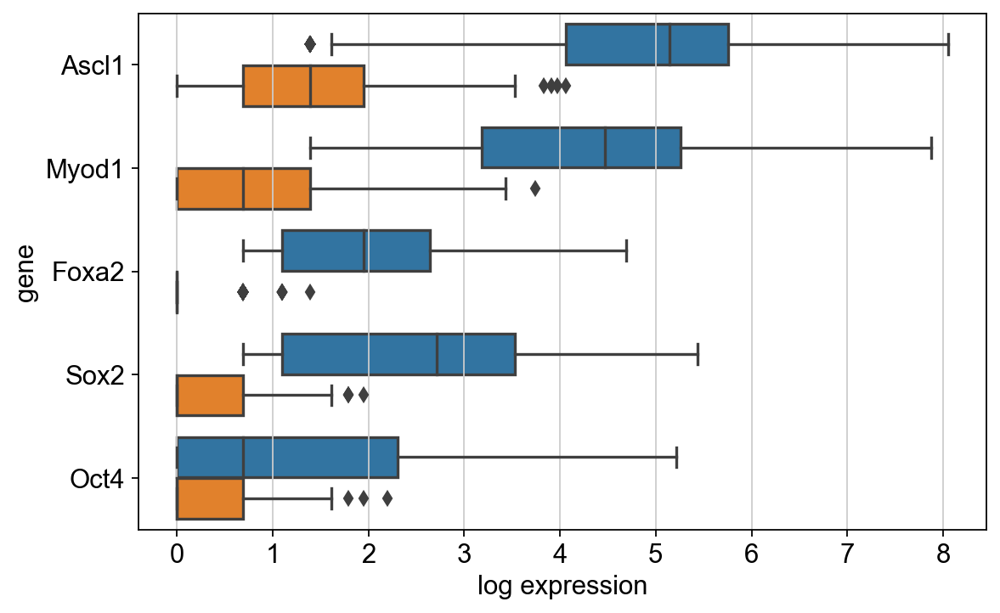

In [95]:
sns_data = pd.concat([
    pd.DataFrame({
        "gene": x.split("_")[0],
        "log expression": np.log(
            (np.exp(adata_proc.obs[x + "_log"].values)-1) + 
            (np.exp(adata_proc.obs[y + "_endogenous_log"].values)-1) + 1),
        "condition": adata_proc.obs["inferred_category_real"].values,
    }) for x, y in zip(constructs, 
                       [z if z != "Oct4" else "Pou5f1" for z in constructs])
], axis=0)
sns_data1 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "1) Ascl1",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "3) Myod1",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "2) Foxa2",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "5) Sox2",
        sns_data["gene"].values == "Sox2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "4) Oct4",
        sns_data["gene"].values == "Oct4"
    ), :],
], axis=0)
sns_data1["group"] = "single-positive"
sns_data2 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Sox2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Oct4"
    ), :],
], axis=0)
sns_data2["group"] = "transfected control"
sns_data = pd.concat([
    sns_data1,
    sns_data2
])
fig, ax = plt.subplots(1,1)
sb.boxplot(
    data=sns_data,
    y="gene", x="log expression", hue="group", ax=ax
)
ax.legend_.remove()
plt.show()

#### Unscaled - transgene only

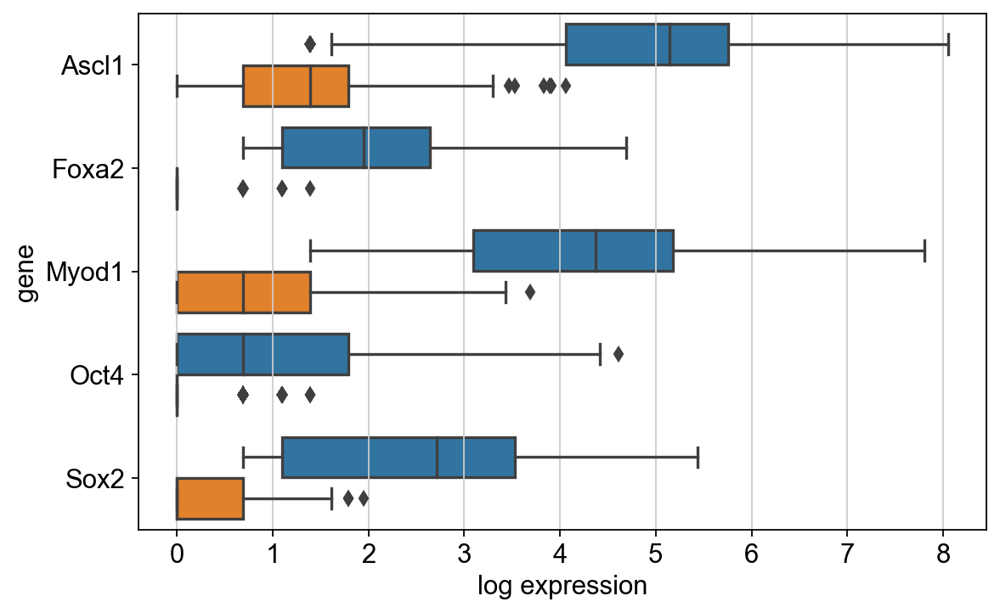

In [96]:
sns_data = pd.concat([
    pd.DataFrame({
        "gene": x.split("_")[0],
        "log expression": adata_proc.obs[x + "_log"].values,
        "condition": adata_proc.obs["inferred_category_real"].values,
    }) for x in constructs
], axis=0)
sns_data1 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "1) Ascl1",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "2) Foxa2",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "3) Myod1",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "4) Oct4",
        sns_data["gene"].values == "Oct4"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "5) Sox2",
        sns_data["gene"].values == "Sox2"
    ), :]
], axis=0)
sns_data1["group"] = "single-positive"
sns_data2 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Oct4"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Sox2"
    ), :]
], axis=0)
sns_data2["group"] = "transfected control"
sns_data = pd.concat([
    sns_data1,
    sns_data2
])
fig, ax = plt.subplots(1,1)
sb.boxplot(
    data=sns_data,
    y="gene", x="log expression", hue="group", ax=ax
)
ax.legend_.remove()

### In single positive conditions for ambient corrected data

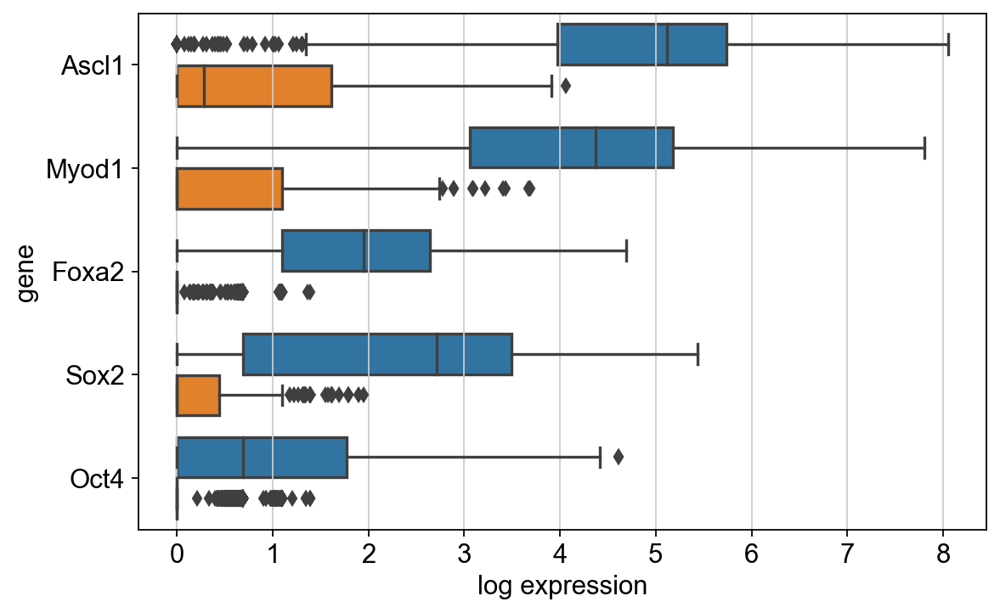

In [97]:
sns_data = pd.concat([
    pd.concat([
        pd.DataFrame({
            "gene": x.split("_")[0],
            "log expression": v.obs[x + "_log"].values,
            "type": k,
            "condition": adata_proc.obs["inferred_category_real"].values,
        }) for x in constructs
    ]) for k, v in {"raw": adata_proc, "corrected": adata_soupx_merged[adata_proc.obs_names, :]}.items()
])

sns_data1 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "1) Ascl1",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "3) Myod1",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "2) Foxa2",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "5) Sox2",
        sns_data["gene"].values == "Sox2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "4) Oct4",
        sns_data["gene"].values == "Oct4"
    ), :],
], axis=0)
sns_data1["group"] = "single-positive"
sns_data2 = pd.concat([
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Ascl1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Myod1"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Foxa2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Sox2"
    ), :],
    sns_data.loc[np.logical_and(
        sns_data["condition"].values == "17) empty",
        sns_data["gene"].values == "Oct4"
    ), :],
], axis=0)
sns_data2["group"] = "transfected control"
sns_data = pd.concat([
    sns_data1,
    sns_data2
])
fig, ax = plt.subplots(1,1)
sb.boxplot(
    data=sns_data,
    y="gene", x="log expression", hue="group", ax=ax
)
ax.legend_.remove()
plt.show()

## Mitochonodrial UMIs by conditions

In [98]:
sns_data["condition"].values.categories

Index(['1) Ascl1', '2) Foxa2', '3) Myod1', '4) Oct4', '5) Sox2',
       '6) Ascl1, Sox2', '7) Ascl1, Myod1', '8) Myod1, Sox2', '9) Oct4, Sox2',
       '10) Foxa2, Sox2', '11) Ascl1, Foxa2', '12) Foxa2, Myod1',
       '13) Ascl1, Oct4, Sox2', '14) Myod1, Oct4, Sox2',
       '15) Foxa2, Oct4, Sox2', '16) Ascl1, Myod1, Sox2', '17) empty'],
      dtype='object')

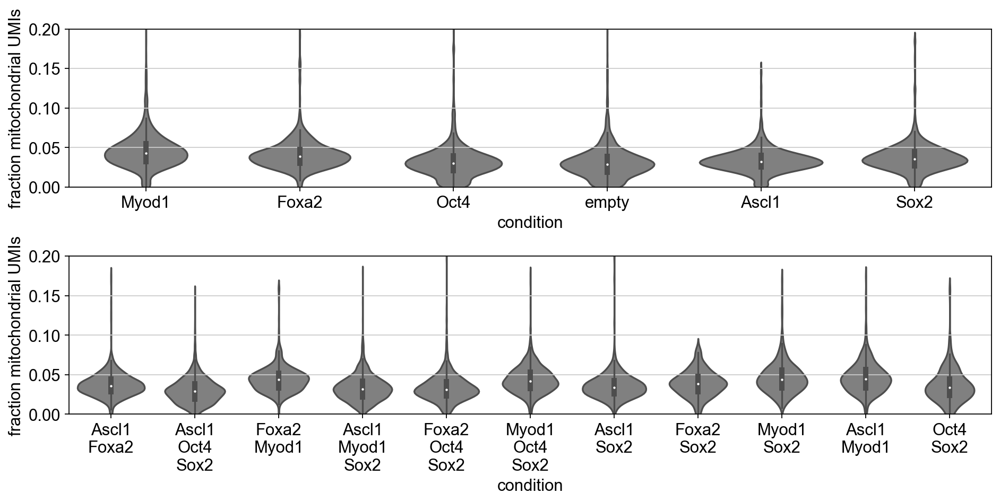

In [99]:
sns_data = pd.concat([
    pd.DataFrame({
        "condition": adata_proc.obs["inferred_category_real"].values.tolist(),
        "mitochondrial-fraction": adata_proc.obs["mt_frac"].values,
    })
    for threshold in [10.]
])
first_row = [
    '1) Ascl1', '2) Foxa2', '3) Myod1', '4) Oct4', '5) Sox2', '17) empty',
]
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(12, 6))
axs[0] = sb.violinplot(
data=sns_data.loc[[
        x in first_row for x in sns_data["condition"].values
    ], :], 
    x="condition", y="mitochondrial-fraction", color="grey",
    ax=axs[0]
)
axs[1] = sb.violinplot(
    data=sns_data.loc[[
        x not in first_row for x in sns_data["condition"].values
    ], :], 
    x="condition", y="mitochondrial-fraction", color="grey",
    ax=axs[1]
)
axs[0].set_ylabel("fraction mitochondrial UMIs")
axs[1].set_ylabel("fraction mitochondrial UMIs")
axs[0].set_xticklabels([
    "\n".join([
        ", ".join(x.get_text().split(", ")[:int(len(x.get_text().split(", ")) / 2)]),
        ", ".join(x.get_text().split(", ")[int(len(x.get_text().split(", ")) / 2):])
    ]).split(") ")[1]
    for x in axs[0].get_xticklabels()
]) 
axs[1].set_xticklabels([
    "\n".join(x.get_text().split(", ")).split(") ")[1]
    for x in axs[1].get_xticklabels()
]) 
axs[0].set_ylim([0, 0.2])
axs[1].set_ylim([0, 0.2])
plt.tight_layout()

## Downstream gene distribution over conditions

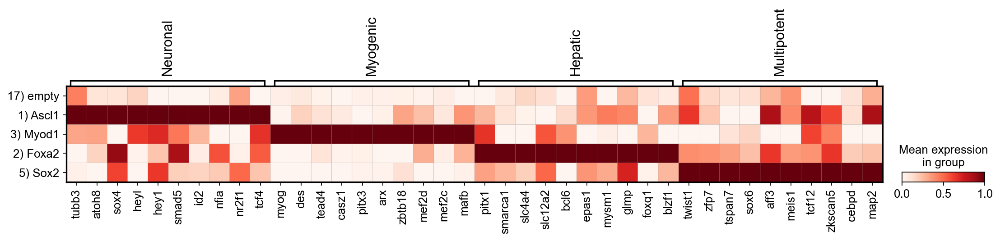

In [100]:
temp = adata_proc[[x in [
    '1) Ascl1', '2) Foxa2', '3) Myod1', '5) Sox2', '17) empty'
] for x in adata_proc.obs["inferred_category_real"].values]].copy()
sc.pl.matrixplot(
    temp, 
    categories_order = ['17) empty', '1) Ascl1', '3) Myod1', '2) Foxa2', '5) Sox2'], 
    var_names= {
        "Neuronal": ['tubb3', 'atoh8', 'sox4', 'heyl', 'hey1', 'smad5', 'id2', 'nfia', 'nr2f1', 'tcf4'],
        "Myogenic": ['myog', 'des', 'tead4', 'casz1', 'pitx3', 'arx' , 'zbtb18', 'mef2d', 'mef2c','mafb'],
        "Hepatic": ['pitx1', 'smarca1',  'slc4a4', 'slc12a2', 'bcl6', 'epas1', 'mysm1', 'glmp', 'foxq1', 'blzf1'], 
        "Multipotent": ['twist1', 'zfp7', 'tspan7', 'sox6', 'aff3', 'meis1', 'tcf12', 'zkscan5', 'cebpd','map2'],
    }, 
    groupby = 'inferred_category_real', 
    use_raw = False, 
    standard_scale = 'var',
    swap_axes=False,
    cmap = 'Reds',
    save="3d.pdf"
)

References:

- https://crimsonpublishers.com/sbb/fulltext/SBB.000532.php Twist1 & Sox2
- https://www.pnas.org/content/111/7/2794 Sox2 & Sox6
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6334647/ Zfp7 (Sox2 target) expressed in undifferentiated ES cells
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4378246/ Smarca1 was shown to function downstream of FoxA2
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4491527/ Slc4a4 and Slc12a2 are known FoxA2 binding sites
- https://pubmed.ncbi.nlm.nih.gov/28178271/ Tead4 is important for myoblast differentiation
- https://www.nature.com/articles/s41467-020-14684-4 Casz1 induces skeletal muscle with MyoD1 and MyoG
- https://pubmed.ncbi.nlm.nih.gov/23438814/ Pitx2/3 are involved in myogenesis
- https://www.nature.com/articles/4402230 Arx is a novel regulator of myogenesis
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7587013/ Nfia is Ascl1 target gene
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6380841/ lnc-Nr2f1 is neurogenic
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC1383528/ Mef2 factors drive myogenesis
- https://pubmed.ncbi.nlm.nih.gov/10721736/ MAFb is MyoD1 target
- https://academic.oup.com/endo/article/158/11/4076/4096797 Bcl6 is classic glucocorticoid gene (not down when FoxA2 is knocked down)
- https://link.springer.com/article/10.1007/s00125-016-4043-z FoxQ1 is hepatic tf and FoxA2 target (ENCODE)
- https://maayanlab.cloud/Harmonizome/gene_set/FOXA2/ENCODE+Transcription+Factor+Targets (epas1, mysm1, glmp1, foxq1, blzf1 are chIP targets of FoxA2 in the encode database
- https://maayanlab.cloud/Harmonizome/gene_set/MYOD1/ENCODE+Transcription+Factor+Targets (ZBTB18 MyoD1 target)
- https://www.researchgate.net/publication/235757869_Involvement_of_Crosstalk_between_Oct4_and_Meis1a_in_Neural_Cell_Fate_Decision Meis1 is important in neural cel fate decision
- https://www.sciencedirect.com/science/article/pii/S1476558614000177 Zkscan5 goes down upon Sox2 knockdown. Cepbd as well 

# Sub-clustering

## Ascl1-Myod1

In [101]:
if bool_recomp == True:   
    target_conds = ['1) Ascl1', '3) Myod1', '7) Ascl1, Myod1']
    idx = [x in target_conds for x in adata_proc.obs["inferred_category_real"].values]
    adata_proc_ascl1_myod1 = adata_proc[idx].copy()
    sc.pp.highly_variable_genes(adata_proc_ascl1_myod1, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_proc_ascl1_myod1, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata_proc_ascl1_myod1, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_proc_ascl1_myod1)
    if bool_recluster == True:
        sc.tl.louvain(adata_proc_ascl1_myod1, resolution=1., flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_proc_ascl1_myod1.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_proc_ascl1_myod1.csv")
            with open(dir_anndata+"uns_adata_proc_ascl1_myod1.pickle", "wb") as f:
                pickle.dump(obj=adata_proc_ascl1_myod1.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_proc_ascl1_myod1.csv')
        adata_proc_ascl1_myod1.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_proc_ascl1_myod1.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_proc_ascl1_myod1.obs['louvain'] = pd.Series(adata_proc_ascl1_myod1.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_proc_ascl1_myod1.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_proc_ascl1_myod1.uns.keys()):        
                adata_proc_ascl1_myod1.uns[k] = v
else:
    adata_proc_ascl1_myod1 = sc.read(dir_anndata+'adata_proc_ascl1_myod1.h5ad') 

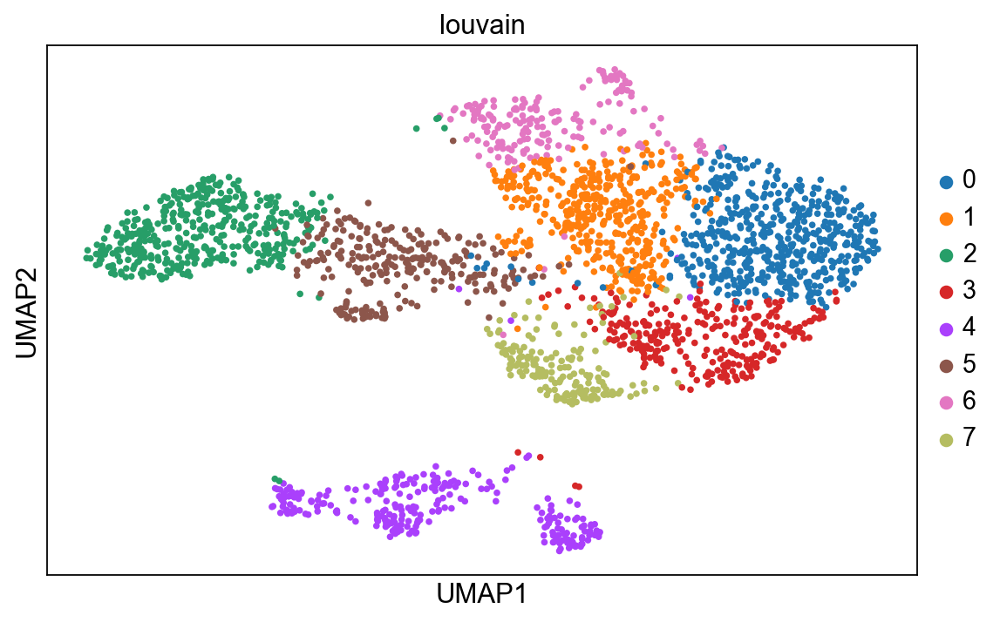

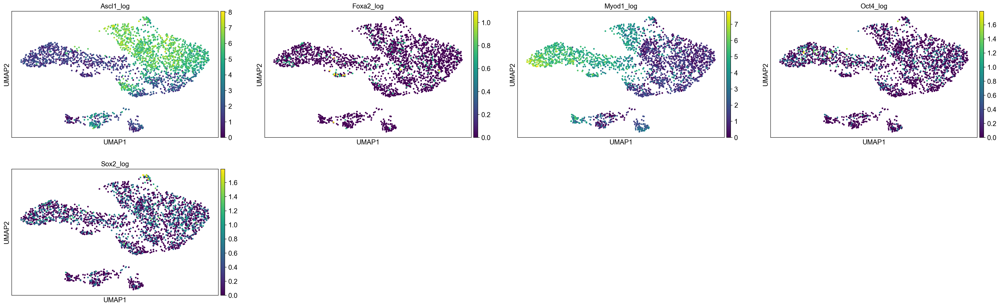

In [102]:
sc.pl.umap(adata_proc_ascl1_myod1, color="louvain")
sc.pl.umap(adata_proc_ascl1_myod1, color=[x+"_log" for x in constructs])

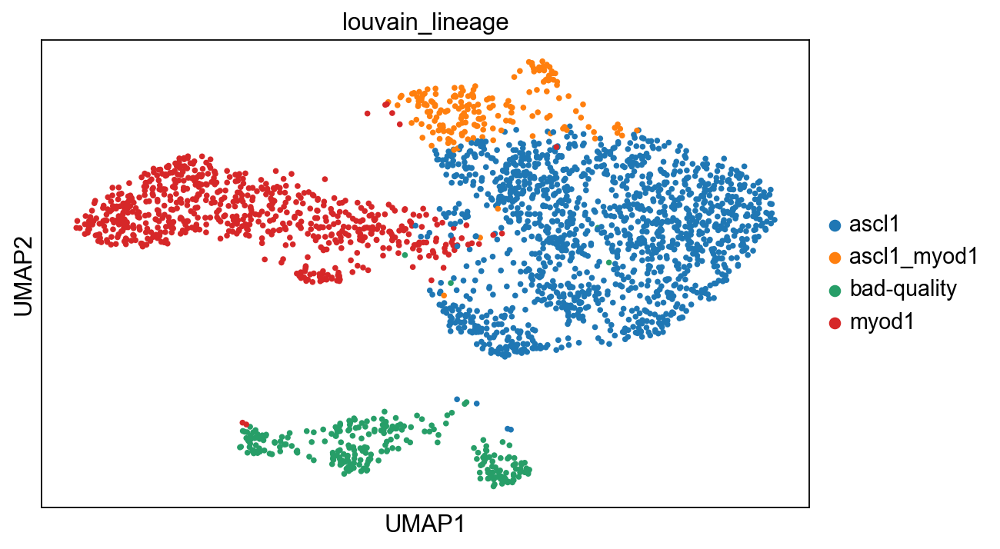

In [103]:
if "louvain_lineage" in adata_proc_ascl1_myod1.obs.columns:
    del adata_proc_ascl1_myod1.obs["louvain_lineage"]
if "louvain_lineage_colors" in adata_proc_ascl1_myod1.uns.keys():
    del adata_proc_ascl1_myod1.uns["louvain_lineage_colors"]
id_map = {
    "0": "ascl1",
    "1": "ascl1",
    "2": "myod1",
    "3": "ascl1",
    "4": "bad-quality",
    "5": "myod1",
    "6": "ascl1_myod1",
    "7": "ascl1",
}
adata_proc_ascl1_myod1.obs["louvain_lineage"] = pd.Categorical(
    [id_map[x] for x in adata_proc_ascl1_myod1.obs["louvain"].values], 
    categories=np.unique(list(id_map.values())))
sc.pl.umap(adata_proc_ascl1_myod1, color="louvain_lineage")

# Condition similarity

In [104]:
categories = np.unique(adata_proc.obs["inferred_category_real"].values)
similarity_mat_genes = pd.DataFrame(
    data=np.zeros((len(categories), len(categories))),
    index=categories,
    columns=categories
)
similarity_mat_pca = pd.DataFrame(
    data=np.zeros((len(categories), len(categories))),
    index=categories,
    columns=categories
)
for i, x in enumerate(categories):
    a1 = adata_proc[adata_proc.obs["inferred_category_real"].values == x, :]
    mu1 = np.asarray(np.log(a1.raw.X / np.expand_dims(a1.obs["sf"].values, axis=1) + 1).mean(axis=0)).flatten()
    for y in categories[i:]:
        a2 = adata_proc[adata_proc.obs["inferred_category_real"].values == y, :]
        # euclidian distance in log-normalised gene space
        mu2 = np.asarray(np.log(a2.raw.X / np.expand_dims(a2.obs["sf"].values, axis=1) + 1).mean(axis=0)).flatten()
        #d = np.sqrt(np.sum(np.square(mu1 - mu2)))
        d = np.corrcoef(mu1, mu2)[0, 1]
        similarity_mat_genes.loc[x, y] = d
        similarity_mat_genes.loc[y, x] = d
        # weighted euclidian distance in PCA space
        weigths = adata_proc.uns["pca"]["variance_ratio"]
        d = np.sqrt(np.maximum(np.sum(np.square(
            np.mean(a1.obsm["X_pca"], axis=0) - 
            np.mean(a2.obsm["X_pca"], axis=0)
        ) * weigths), 1e-6))
        similarity_mat_pca.loc[x, y] = d
        similarity_mat_pca.loc[y, x] = d

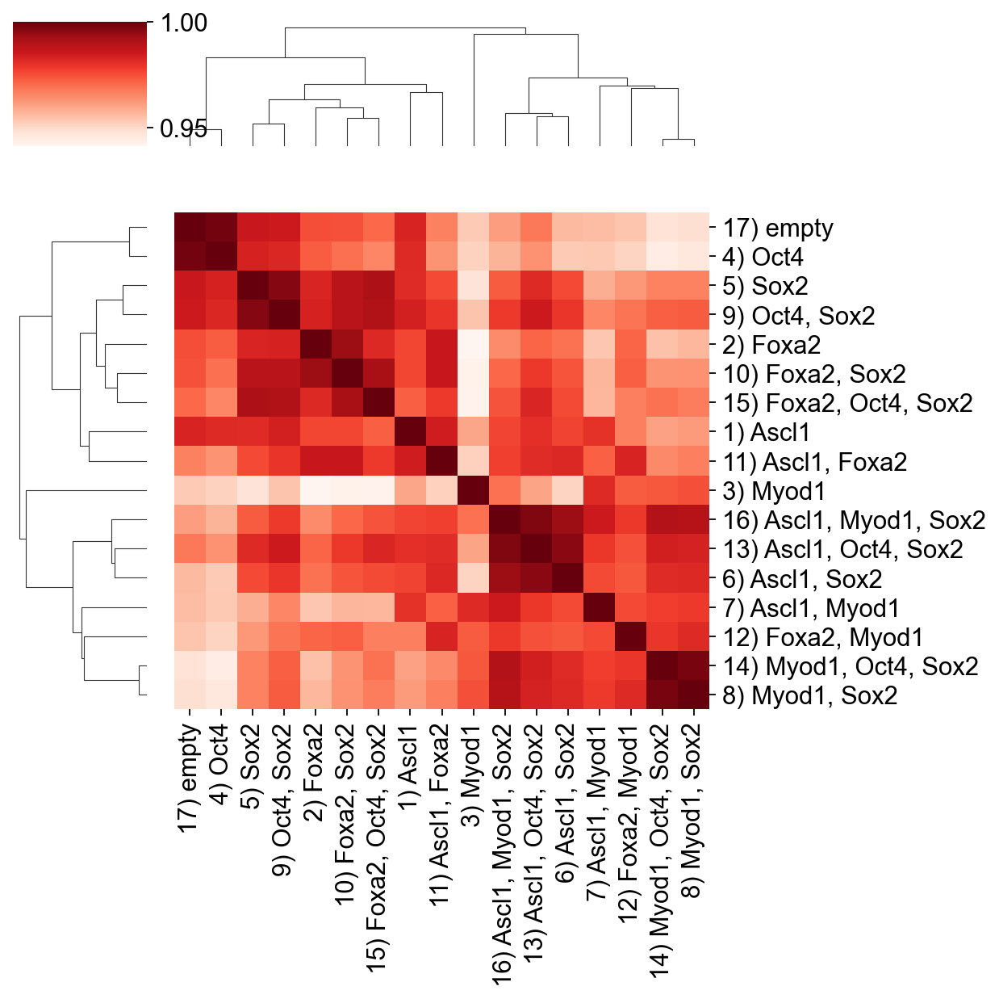

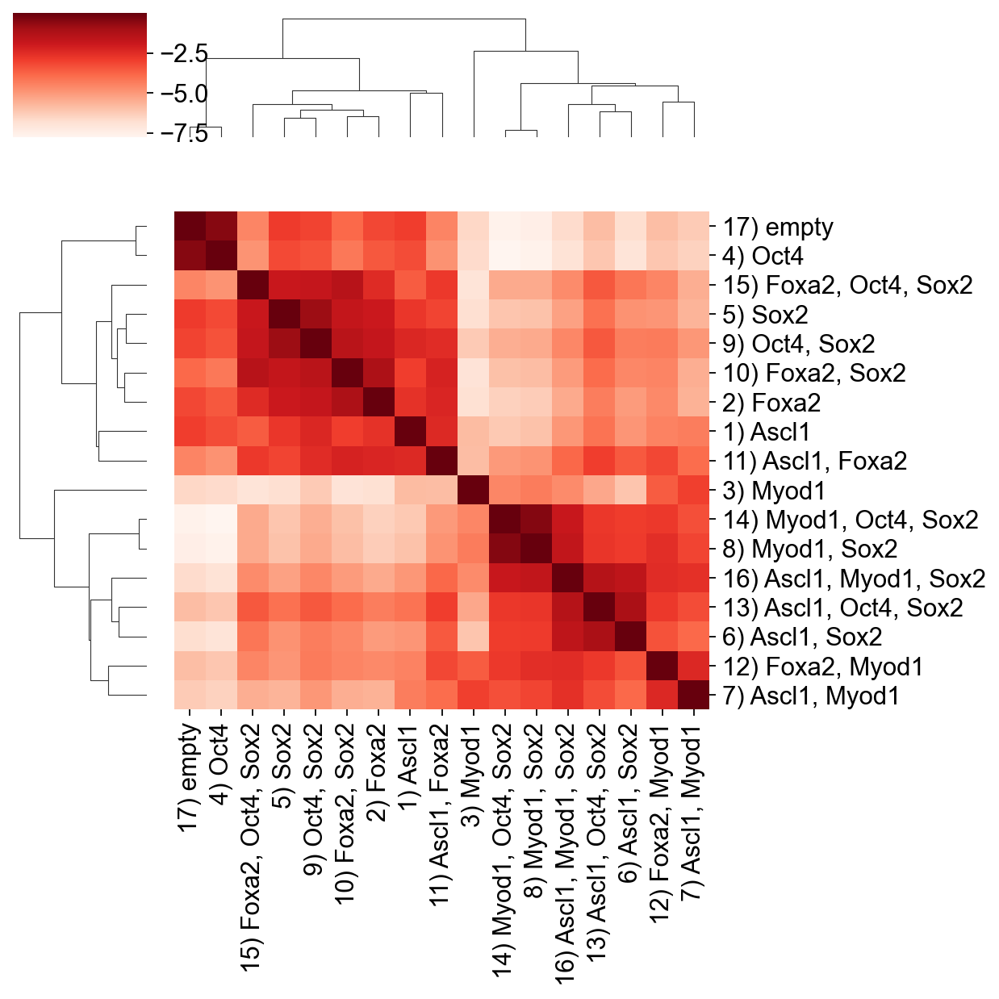

In [105]:
sb.clustermap(data=similarity_mat_genes, figsize=(8, 8), cmap="Reds")
plt.tight_layout()
plt.show()
sb.clustermap(data=-similarity_mat_pca, figsize=(8, 8), cmap="Reds")
plt.tight_layout()
plt.savefig(dir_out + "EV2b.pdf")
plt.show()

## Condition embedding

In [106]:
mu = {}
for x in categories:
    a = adata_proc[adata_proc.obs["inferred_category_real"].values == x, :]    
    if False:
        mu[x] = np.asarray(np.log(a.raw.X / np.expand_dims(a.obs["sf"].values, axis=1) + 1).mean(axis=0)).flatten()
        var_names = adata_proc.raw.var_names
    else:
        mu[x] = np.asarray(a[:, a.var["highly_variable"].values].X.mean(axis=0)).flatten()
        var_names = a[:, a.var["highly_variable"].values].var_names
adata_temp = anndata.AnnData(
    np.concatenate([np.expand_dims(x, axis=0) for x in mu.values()], axis=0),
    obs=pd.DataFrame({"condition": pd.Categorical(list(mu.keys()))}, index=list(mu.keys())),
    var=pd.DataFrame({}, index=var_names),
)
sc.pp.scale(adata_temp)
sc.pp.pca(adata_temp)
sc.pp.neighbors(adata_temp)
sc.tl.umap(adata_temp)

computing PCA
    with n_comps=16
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 16
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


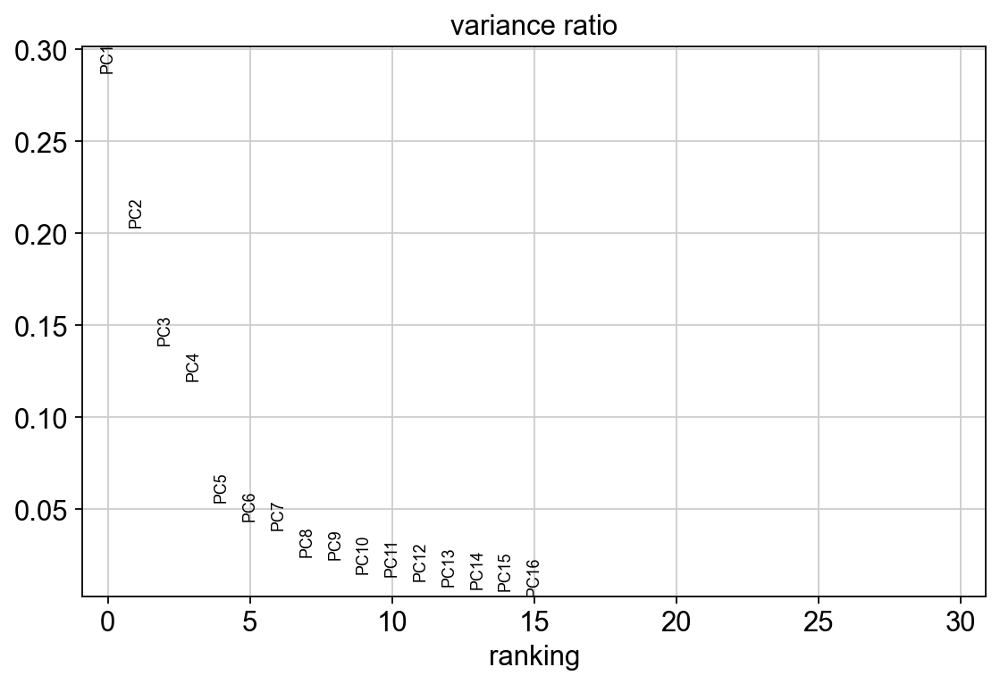

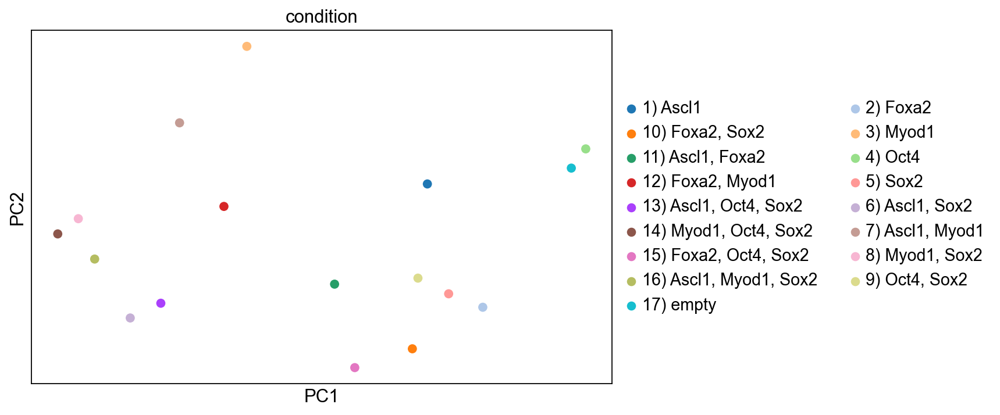

In [107]:
sc.pl.pca_variance_ratio(adata_temp)
sc.pl.pca(adata_temp, s=200, color="condition", components=[1,2])

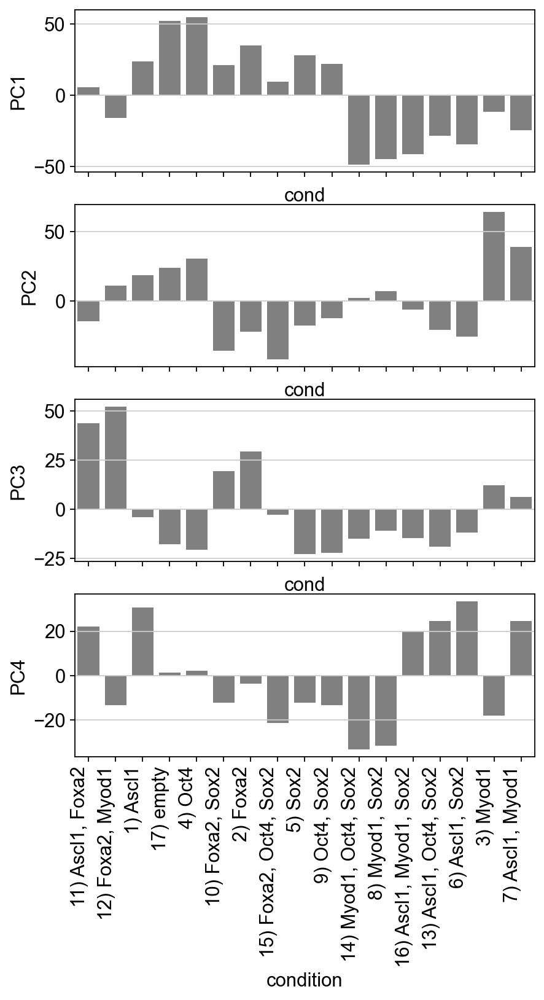

In [108]:
clustergrid = sb.clustermap(data=adata_temp.obsm["X_pca"], figsize=(8, 8), cmap="Reds")
plt.close()
idx = clustergrid.dendrogram_row.reordered_ind
fig, ax = plt.subplots(nrows=4, ncols=1, figsize=(6, 10))
for i in range(4):
    tab = pd.DataFrame({
        "y": adata_temp.obsm["X_pca"][:, i],
        "cond": adata_temp.obs_names,
    }).iloc[idx, :]
    sb.barplot(data=tab, x="cond", y="y", color="grey", ax=ax[i])
    if i == 3:
        ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, ha='right')
    else:
        ax[i].set_xticklabels([])
    ax[i].set_ylabel(f"PC{i+1}")
ax[i].set_xlabel("condition")
plt.show()

In [109]:
del adata_temp

# Fibroblast scores

In [110]:
fibroblast_markers = [
    "thy1",
    "col1a1",
    "postn",
    "vim",
    "prrx1",
    'timp3',
    "ccn2",
    "col5a1",
    "col1a2",
    "glipr2",
    "itgb5",
    "sh3kbp1",
    "tex264",
    "tnc",
    "cnn1",
    "fn1",
    's100a4', #also known as fibroblast specific 1
    'twist2',
    'snai2',
    'cav1',
    'ecm1',
    'acta2',
    'col4a1',
    'col5a2',
    'mmp2',
    'mmp14',
    'mmp23',
    'col3a1',
    'cav2',
    'timp1',
    'timp2',
    'fgf7',
    'vcl',
    'itgb8'
]

print("not found:" + str([x for x in fibroblast_markers if x not in adata_proc.var_names]))
fibroblast_markers = [x for x in fibroblast_markers if x in adata_proc.var_names]

not found:[]


In [111]:
adata_fibroblast_space = adata_proc[:, fibroblast_markers].copy()
sc.pp.pca(adata_fibroblast_space, n_comps=5)

computing PCA
    on highly variable genes
    with n_comps=5
    finished (0:00:00)


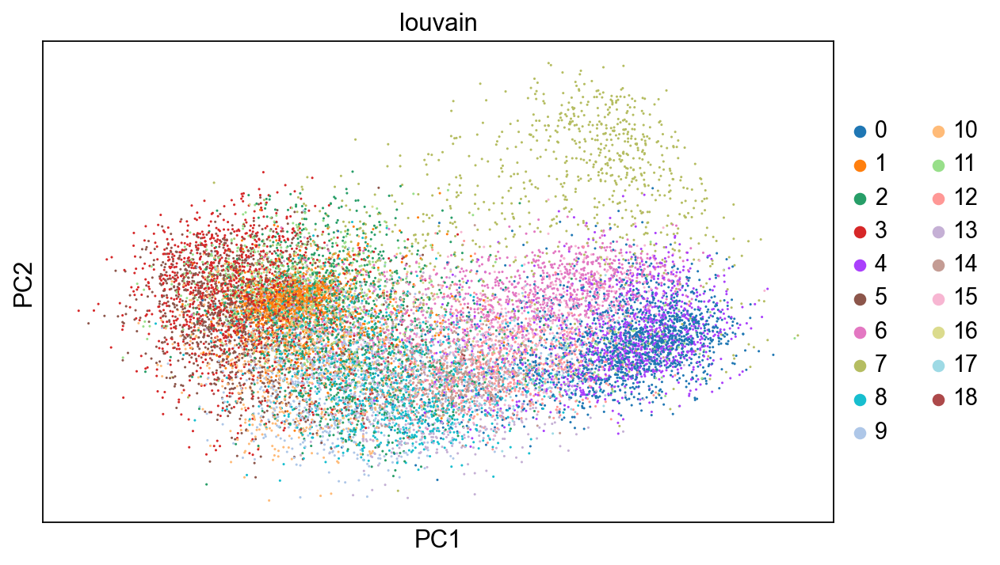

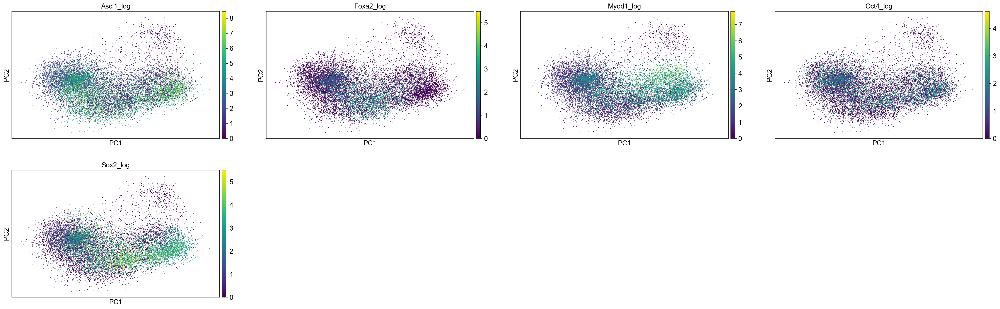

In [112]:
sc.pl.pca(adata_fibroblast_space, color=["louvain"])
sc.pl.pca(adata_fibroblast_space, color=[x+"_log" for x in constructs])

In [113]:
if bool_recomp:
    idx_fibroblasts = np.where([
        x in ["fibroblast"]
        for x in adata_proc.obs["louvain_lineage"].values
    ])[0]
    adata_proc.obs["fibroblast_score_z"] = np.mean(np.asarray(
        (adata_proc[:, fibroblast_markers].X - adata_proc[idx_fibroblasts, :][:, fibroblast_markers].X.mean(axis=0)) / 
        adata_proc[idx_fibroblasts, :][:, fibroblast_markers].X.todense().std(axis=0)
    ), axis=1)
    adata_proc.obs["fibroblast_score_expression"] = np.asarray(np.sum(adata_proc[:, fibroblast_markers].X, axis=1))
    # Define final fibroblast score:
    adata_proc.obs["fibroblast_score"] = adata_proc.obs["fibroblast_score_z"].values

<AxesSubplot:>

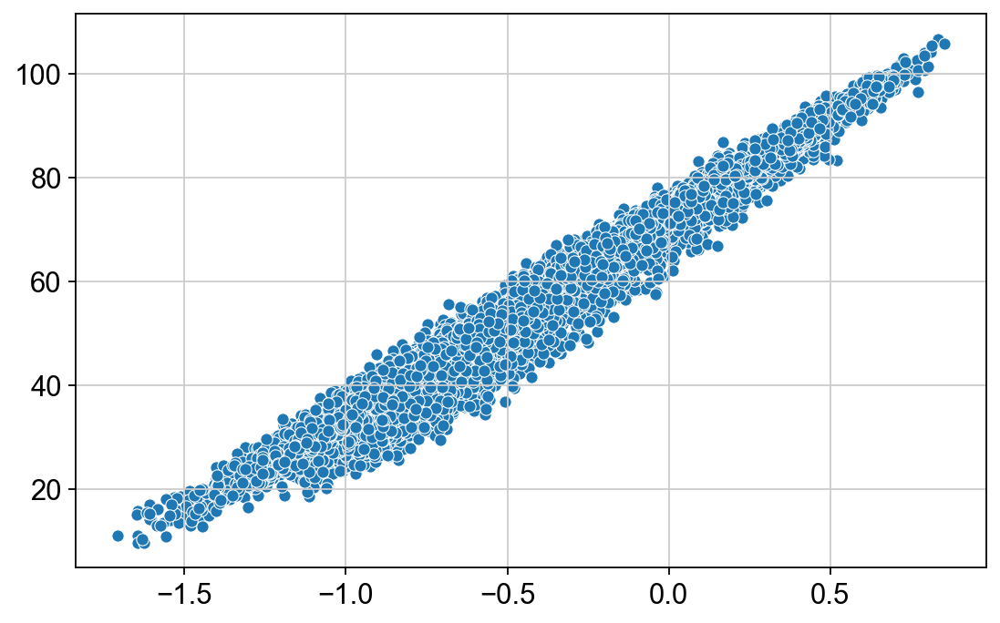

In [114]:
sb.scatterplot(
    adata_proc.obs["fibroblast_score_z"].values,
    adata_proc.obs["fibroblast_score_expression"].values
)

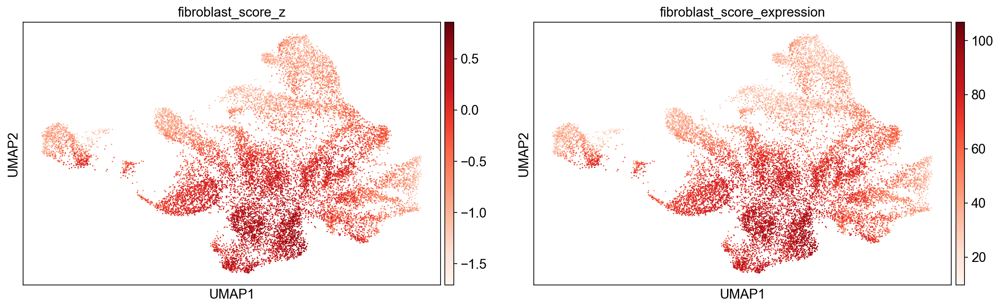

In [115]:
sc.pl.umap(adata_proc, color=["fibroblast_score_z", "fibroblast_score_expression"], cmap="Reds")

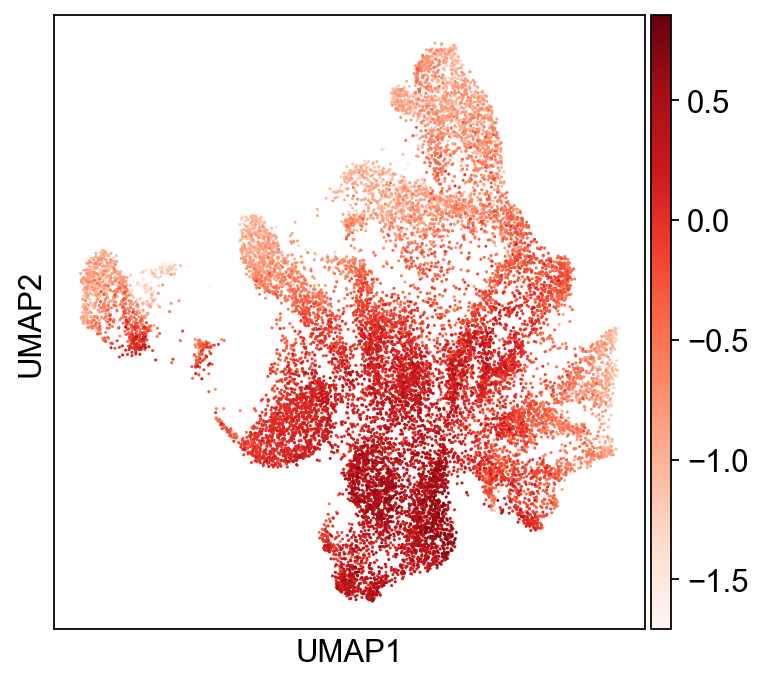

In [116]:
fig, ax = plt.subplots(1,1,figsize=(5,4.5))
ax = sc.pl.umap(
    adata_proc, 
    color="fibroblast_score", cmap="Reds",
    ax=ax, show=False
)
ax.set_title("")
plt.tight_layout()
plt.show()

By cluster:

('ascl1', 1616, 'pval=0.000000')
('ascl1_foxa2', 610, 'pval=0.000000')
('ascl1_myod1', 1875, 'pval=0.000000')
('ascl1_sox2', 1633, 'pval=0.000000')
('fibroblast', 2994, 'pval=1.000000')
('fibroblast_lq', 931, 'pval=0.000000')
('foxa2', 1058, 'pval=0.000000')
('foxa2_myod1', 521, 'pval=0.000000')
('myod1', 1016, 'pval=0.000000')
('myod1_sox2', 1069, 'pval=0.000000')
('sox2', 1917, 'pval=0.000000')
('sox2_oct4', 528, 'pval=0.000000')


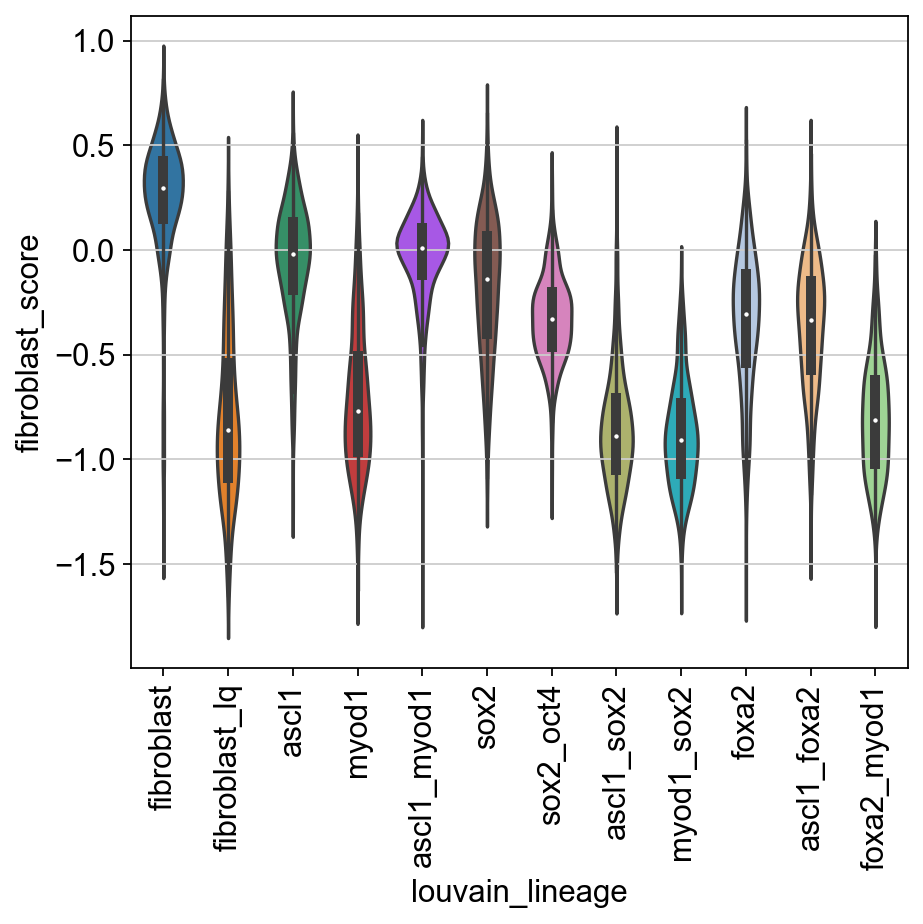

In [117]:
import scipy.stats
obs_temp = adata_proc.obs.copy()
obs_temp["louvain_lineage"] = pd.Categorical(
    obs_temp["louvain_lineage"].values,
    categories=list(id_lineage_cmap.keys())
)
for x in np.unique(obs_temp["louvain_lineage"].values.tolist()):
    print((x, 
           np.sum(obs_temp["louvain_lineage"].values == x),
           "pval=%f" % scipy.stats.ttest_ind(
        a=obs_temp.loc[obs_temp["louvain_lineage"].values == "fibroblast", "fibroblast_score"].values,
        b=obs_temp.loc[obs_temp["louvain_lineage"].values == x, "fibroblast_score"].values
    )[1]))
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(6, 6))
sb.violinplot(
    data=obs_temp,
    x="louvain_lineage",
    y="fibroblast_score",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=90)
plt.tight_layout()

By condition:

('1) Ascl1', '72h', 'pval=nan')
('10) Foxa2, Sox2', '72h', 'pval=nan')
('11) Ascl1, Foxa2', '72h', 'pval=nan')
('12) Foxa2, Myod1', '72h', 'pval=nan')
('13) Ascl1, Oct4, Sox2', '72h', 'pval=nan')
('14) Myod1, Oct4, Sox2', '72h', 'pval=nan')
('15) Foxa2, Oct4, Sox2', '72h', 'pval=nan')
('16) Ascl1, Myod1, Sox2', '72h', 'pval=nan')
('17) empty', '72h', 'pval=nan')
('2) Foxa2', '72h', 'pval=nan')
('3) Myod1', '72h', 'pval=nan')
('4) Oct4', '72h', 'pval=nan')
('5) Sox2', '72h', 'pval=nan')
('6) Ascl1, Sox2', '72h', 'pval=nan')
('7) Ascl1, Myod1', '72h', 'pval=nan')
('8) Myod1, Sox2', '72h', 'pval=nan')
('9) Oct4, Sox2', '72h', 'pval=nan')


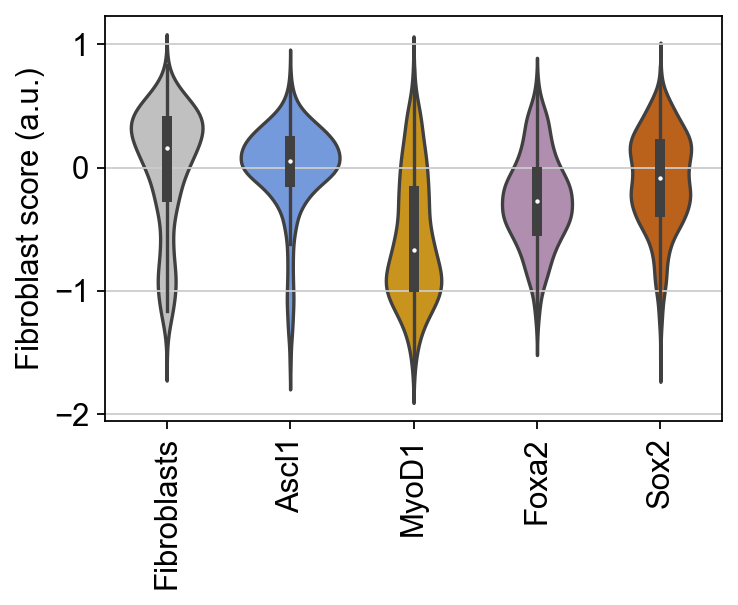

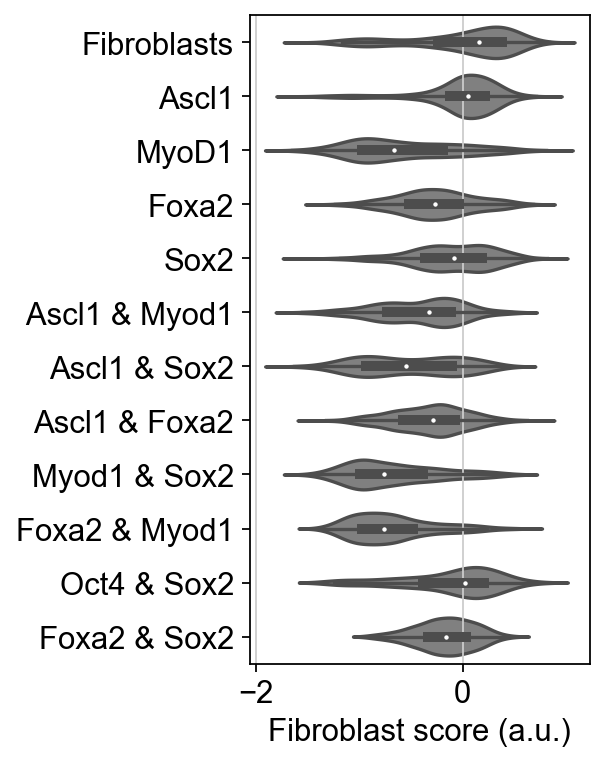

No handles with labels found to put in legend.


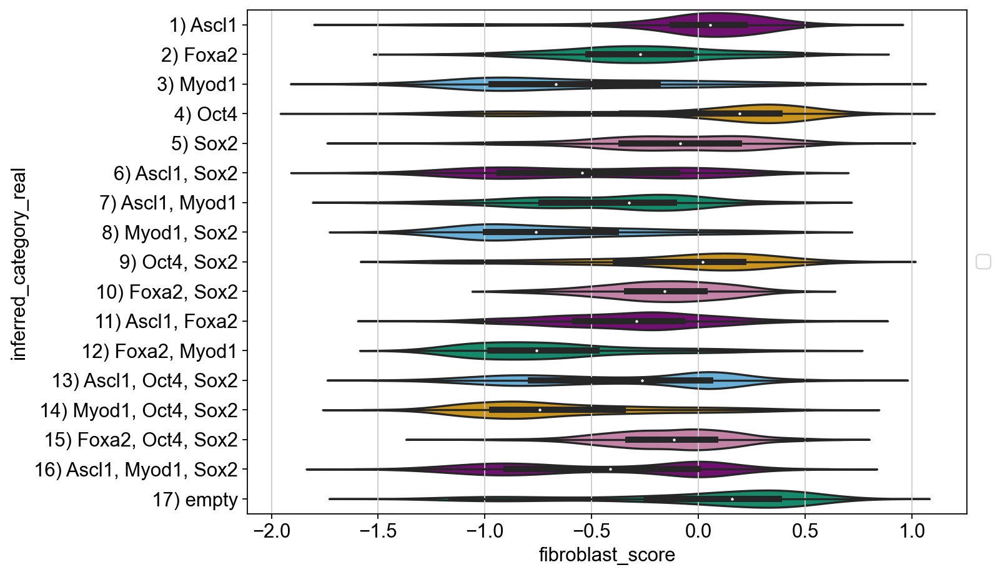

In [118]:
obs_temp = adata_proc.obs.copy()
for x in np.unique(obs_temp["inferred_category_real"]):
    for tp in np.unique(obs_temp["time"]):
        print((x, tp, "pval=%f" % scipy.stats.ttest_ind(
            a=obs_temp.loc[np.logical_and(
                obs_temp["inferred_category_real"].values == "0) untransfected",
                obs_temp["time"].values == tp
            ), "fibroblast_score"],
            b=obs_temp.loc[np.logical_and(
                obs_temp["inferred_category_real"].values == x,
                obs_temp["time"].values == tp
            ), "fibroblast_score"]
        )[1]))

        
obs_temp_red = obs_temp.loc[[
        x in [
            '17) empty', '1) Ascl1', '3) Myod1', '2) Foxa2', '5) Sox2', 
        ] for x in adata_proc.obs["inferred_category_real"].values
    ], :].copy()
name_map = {
    "17) empty": "Fibroblasts", 
    "1) Ascl1": "Ascl1", 
    "3) Myod1": "MyoD1", 
    "5) Sox2": "Sox2",
    "2) Foxa2": "Foxa2", 
}
obs_temp_red["inferred_category_real"] = pd.Categorical(
    [name_map[x] for x in obs_temp_red["inferred_category_real"].values.tolist()],
    categories=[name_map[x] for x in 
                ['17) empty', '1) Ascl1', '3) Myod1', '2) Foxa2', '5) Sox2']]
)
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(5, 4))
sb.violinplot(
    data=obs_temp_red,
    x="inferred_category_real",
    y="fibroblast_score",
    palette=['silver', 'cornflowerblue','#E69F00', "#B589B5", '#D55E00'],
    ax=axs
)
axs.set_xlabel("")
axs.set_ylabel("Fibroblast score (a.u.)")
axs.xaxis.set_tick_params(rotation=90)
plt.tight_layout()
plt.savefig(dir_out + "3e.pdf")
plt.show()

obs_temp_red = obs_temp.loc[[
        x in [
            '17) empty', '1) Ascl1', '3) Myod1', '2) Foxa2', '5) Sox2', 
            '7) Ascl1, Myod1', '6) Ascl1, Sox2', '11) Ascl1, Foxa2', 
            '8) Myod1, Sox2', '12) Foxa2, Myod1', '9) Oct4, Sox2',
           '10) Foxa2, Sox2', 
        ] for x in adata_proc.obs["inferred_category_real"].values
    ], :].copy()
name_map = {
    "17) empty": "Fibroblasts", 
    "1) Ascl1": "Ascl1", 
    "3) Myod1": "MyoD1", 
    "5) Sox2": "Sox2",
    "2) Foxa2": "Foxa2",  
    '7) Ascl1, Myod1': " Ascl1 & Myod1", 
    '6) Ascl1, Sox2': "Ascl1 & Sox2", 
    '11) Ascl1, Foxa2': "Ascl1 & Foxa2", 
    '8) Myod1, Sox2': "Myod1 & Sox2", 
    '12) Foxa2, Myod1': "Foxa2 & Myod1", 
    '9) Oct4, Sox2': "Oct4 & Sox2",
   '10) Foxa2, Sox2': "Foxa2 & Sox2",
}
obs_temp_red["inferred_category_real"] = pd.Categorical(
    [name_map[x] for x in obs_temp_red["inferred_category_real"].values.tolist()],
    categories=[
        name_map[x] for x in [
            '17) empty', '1) Ascl1', '3) Myod1', '2) Foxa2', '5) Sox2', 
            '7) Ascl1, Myod1', '6) Ascl1, Sox2', '11) Ascl1, Foxa2', 
            '8) Myod1, Sox2', '12) Foxa2, Myod1', '9) Oct4, Sox2',
           '10) Foxa2, Sox2'
        ]]
)
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(4, 5))
sb.violinplot(
    data=obs_temp_red,
    y="inferred_category_real",
    x="fibroblast_score",
    color="grey",
    ax=axs
)
axs.set_ylabel("")
axs.set_xlabel("Fibroblast score (a.u.)")
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))
sb.violinplot(
    data=obs_temp,
    y="inferred_category_real",
    x="fibroblast_score",
    palette=["purple", "#009E73", "#56b4e9", "#e69f00", "#cc79a7"],
    ax=axs
)
box = axs.get_position()
axs.set_position([box.x0, box.y0, box.width * 0.95, box.height])
axs.legend(loc='center left', bbox_to_anchor=(1, 0.5))
axs.xaxis.set_tick_params(rotation=0)
plt.tight_layout()

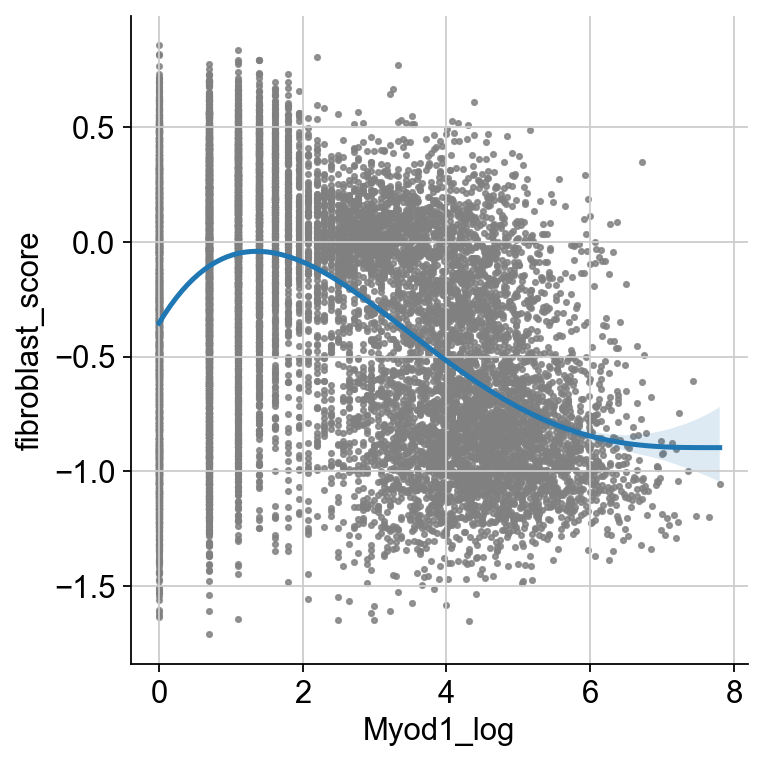

In [119]:
#fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(6, 6))
sb.lmplot(
    data=adata_proc.obs,
    x="Myod1_log",
    y="fibroblast_score",
    order=4, ci=95,
    #x_estimator=np.mean,
    scatter_kws={"s": 5, "color": "grey"}
    #ax=axs
)
plt.tight_layout()
plt.show()

# Cell size analysis

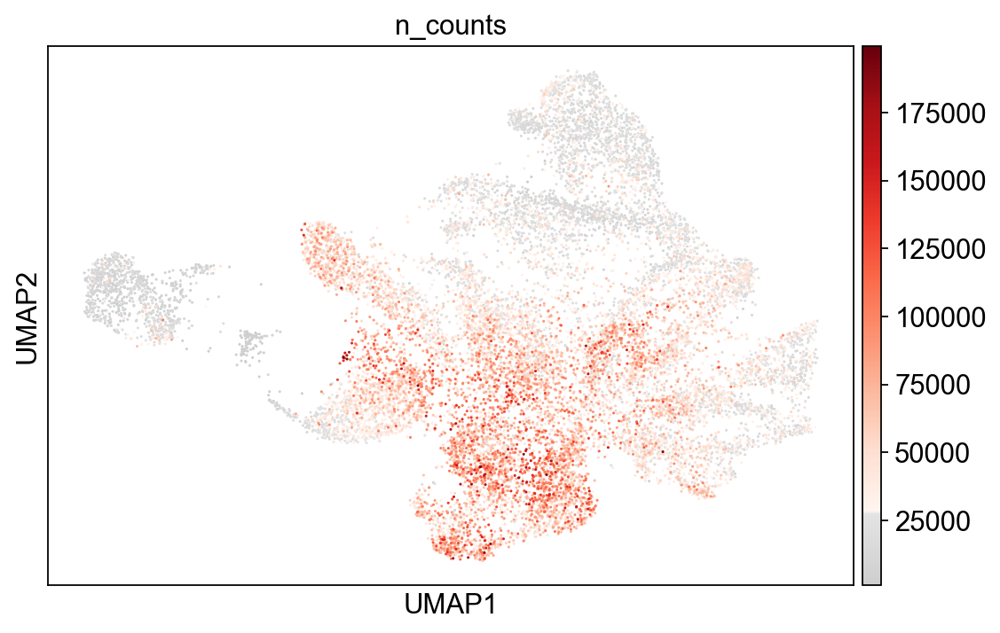

In [120]:
sc.pl.umap(adata_proc, color=["n_counts"], cmap=mymap)

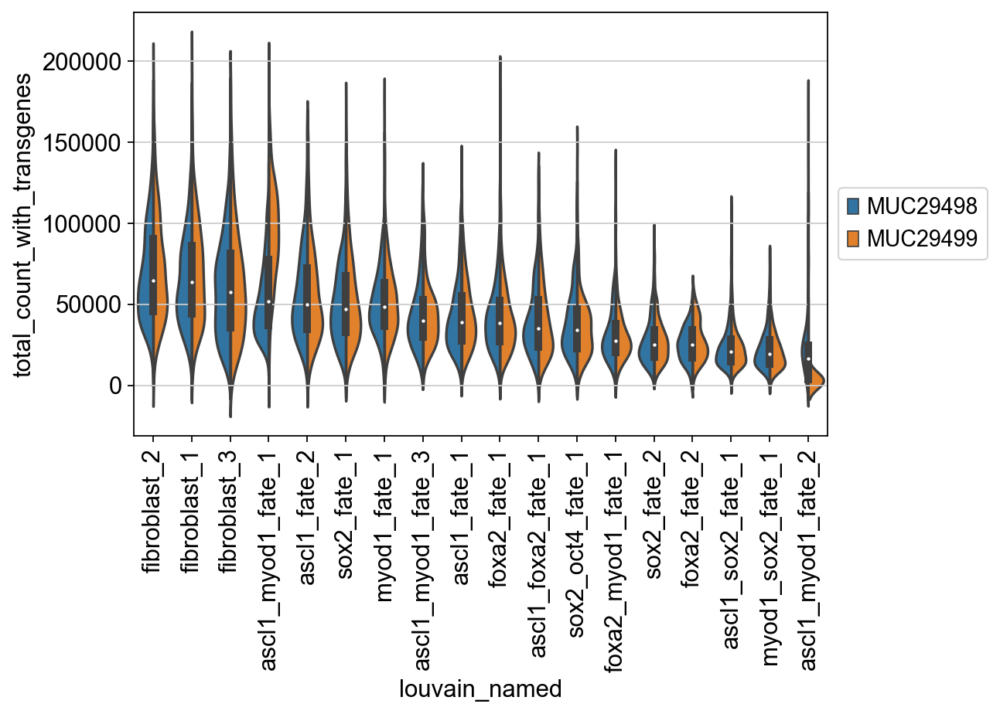

In [121]:
data = adata_proc.obs[["louvain_named", "total_count_with_transgenes", "batch"]].copy()
data = data.loc[[x not in ["fibroblast_4"] for x in data["louvain_named"].values], :]
data["louvain_named"] = data["louvain_named"].values.tolist()
data["louvain_named"] = pd.Categorical(
    data["louvain_named"].values.tolist(),
    categories=data.groupby("louvain_named").mean().reset_index()\
        .sort_values("total_count_with_transgenes")["louvain_named"].values.tolist()[::-1]
)
fig, ax = plt.subplots(1,1,figsize=(8,6))
sb.violinplot(data=data, x="louvain_named", y="total_count_with_transgenes", hue="batch", split=True)
ax.xaxis.set_tick_params(rotation=90)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.95, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

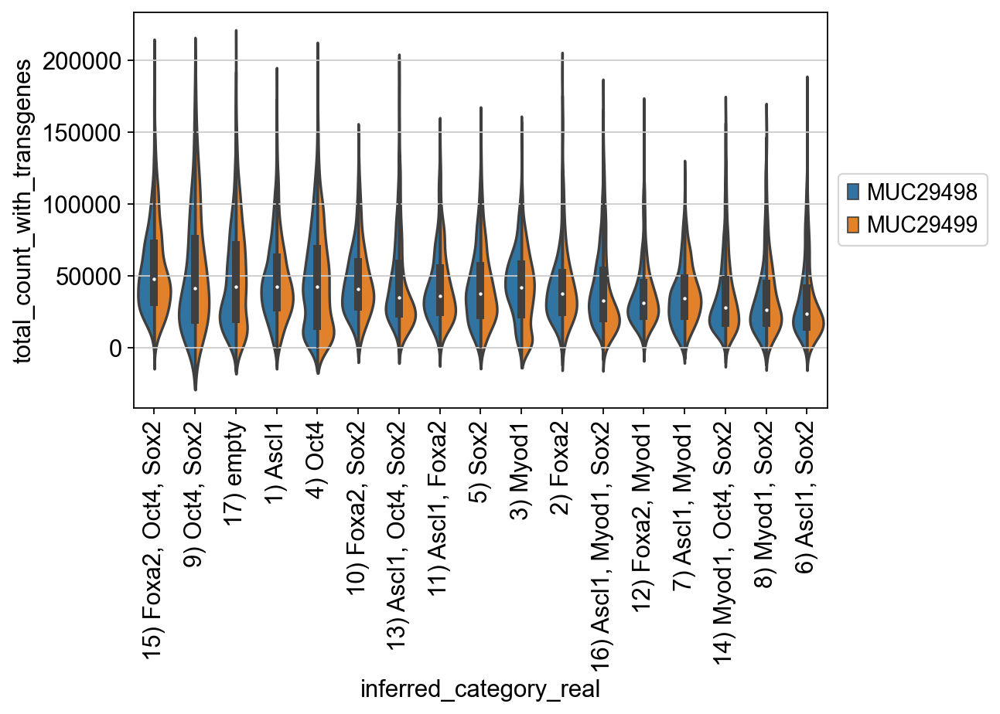

In [122]:
data = adata_proc.obs[["inferred_category_real", "total_count_with_transgenes", "batch"]].copy()
data["inferred_category_real"] = data["inferred_category_real"].values.tolist()
data["inferred_category_real"] = pd.Categorical(
    data["inferred_category_real"].values.tolist(),
    categories=data.groupby("inferred_category_real").mean().reset_index()\
        .sort_values("total_count_with_transgenes")["inferred_category_real"].values.tolist()[::-1]
)
fig, ax = plt.subplots(1,1,figsize=(8,6))
sb.violinplot(data=data, x="inferred_category_real", y="total_count_with_transgenes", hue="batch", split=True)
ax.xaxis.set_tick_params(rotation=90)
box = ax.get_position()
ax.set_position([box.x0, box.y0, box.width * 0.95, box.height])
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

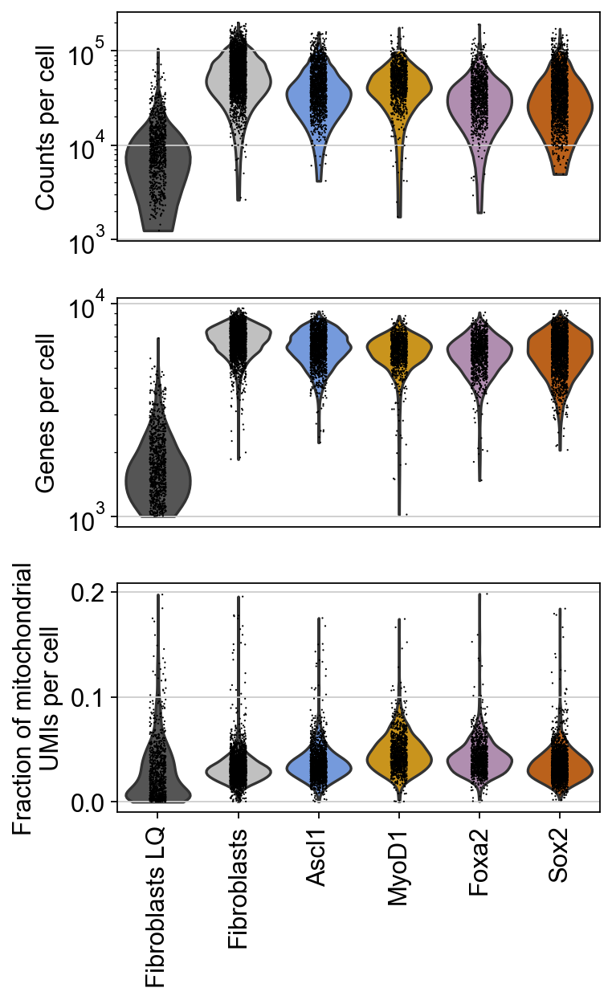

In [123]:
temp = adata_proc.copy()
k_targets = "louvain_lineage"
targets = ["fibroblast_lq", "fibroblast", "ascl1", "myod1", "foxa2", "sox2",]
name_map = {
    "fibroblast_lq": "Fibroblasts LQ", 
    "fibroblast": "Fibroblasts", 
    "ascl1": "Ascl1", 
    "myod1": "MyoD1", 
    "sox2": "Sox2",
    "foxa2": "Foxa2", 
}
temp = temp[[x in targets for x in temp.obs[k_targets].values], :].copy()
temp.obs[k_targets] = pd.Categorical(
    [name_map[x] for x in temp.obs[k_targets].values.tolist()],
    categories=[name_map[x] for x in targets],
)
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(5*1, 8*1))
for i, (k, v) in enumerate({
    'n_counts': "Counts per cell",
    'n_genes': "Genes per cell",
    'mt_frac': "Fraction of mitochondrial\nUMIs per cell",
}.items()):
    axs[i] = sc.pl.violin(
        temp, 
        keys=k, groupby=k_targets, rotation = 90, stripplot=True, 
        palette = ['#555555', 'silver','cornflowerblue','#E69F00', "#B589B5", '#D55E00'],
        log = i < 2,
        ax=axs[i],
        show=False
    )
    if i < 2:
        axs[i].xaxis.set_ticks([])
    axs[i].set_title("")
    axs[i].set_ylabel(v)
plt.tight_layout()
plt.savefig(dir_out + f"SI1b.pdf")
plt.show()

# Save final versions of processed objects

These objects are used by other notebooks.

In [124]:
if bool_recomp:
    sc.write(dir_anndata+'adata_filtered_velo.h5ad', adata_filtered_velo)
    sc.write(dir_anndata+'adata_proc_corrected.h5ad', adata_proc_corrected)
    sc.write(dir_anndata+'adata_proc_ambient.h5ad', adata_proc_ambient)
    sc.write(dir_anndata+'adata_proc.h5ad', adata_proc)
    sc.write(dir_anndata+'adata_filtered.h5ad', adata_filtered)
    sc.write(dir_anndata+'adata_proc_ascl1_myod1.h5ad', adata_proc_ascl1_myod1)